In [1]:
import re
import os
import glob
import sys
import time
import pandas as pd
import matplotlib as mpl
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import gridspec
from scipy.stats import gaussian_kde
import matplotlib.patheffects as path_effects
from itertools import product
import arviz

def hpd(data, level):
    """
    Return highest posterior density interval from a list,
    given the percent posterior density interval required.
    """
    d = list(data)
    d.sort()
    nData = len(data)
    nIn = int(round(level * nData))
    if nIn < 2 :
        return None
    #raise RuntimeError("Not enough data. N data: %s"%(len(data)))
    i = 0
    r = d[i+nIn-1] - d[i]
    for k in range(len(d) - (nIn - 1)) :
        rk = d[k+nIn-1] - d[k]
        if rk < r :
            r = rk
            i = k
    assert 0 <= i <= i+nIn-1 < len(d)
    return (d[i], d[i+nIn-1])

# calculate effective sample size
def effectiveSampleSize(data, stepSize = 1) :
    """ Effective sample size, as computed by BEAST Tracer."""
    samples = len(data)
    assert len(data) > 1,"no stats for short sequences"
    maxLag = min(samples//3, 1000)
    gammaStat = [0,]*maxLag
    varStat = 0.0;
    if type(data) != np.ndarray :
        data = np.array(data)

    normalizedData = data - data.mean()
    for lag in range(maxLag) :
        v1 = normalizedData[:samples-lag]
        v2 = normalizedData[lag:]
        v = v1 * v2
        gammaStat[lag] = sum(v) / len(v)
        if lag == 0 :
            varStat = gammaStat[0]
        elif lag % 2 == 0 :
            s = gammaStat[lag-1] + gammaStat[lag]
            if s > 0 :
                varStat += 2.0*s
            else :
                break
    # auto correlation time
    act = stepSize * varStat / gammaStat[0]
    # effective sample size
    ess = (stepSize * samples) / act
    return ess

def DIC(dev):
    """ takes the deviance at each sample and returns the deviance information criterion value"""
    DIC=0.5*np.var(dev)+np.mean(dev)
    return DIC

# Cleaning up files

In [ ]:
%%bash

# pre-treatement of the files
# all columns are [0] R's index and has no header [1] intercept [2..3] variables [4:] random efects for each species.
# we rae interested on the first couple of columns depending on what the model includes

for i in */*COUNT*noclimate*txt; do cut -f1-3 $i > "${i}".1; done # cut is 1 indexed, like R done
for i in */*noherb*-climate*txt; do cut -f1-4 $i > "${i}".1; done# index "(Intercept)"   "Biome_bin"     "Precip" 
for i in */*noherb*-noclimate*txt; do cut -f1-2 $i > "${i}".1; done# index "(Intercept)" 

# for models with climate (has two more columns: Biome binary and precipitation)
for i in */*COUNT*-climate*txt; do cut -f1-5 $i > "${i}".1; done # cut is 1 indexed, like R

# concatenate the chains of the same model and run (only for the climate data)
for i in *txt.1; do name=$(echo ${i} | sed 's/.txt.1//g');wait; echo $name; done # check the variable name is correctly set
for i in *1/txt.1; do name=$(echo ${i} | sed 's/.txt.1//g');wait; echo $name; done # check the variable name is correctly set

# or
for i in nulls*/*txt.1; do name=$(echo ${i} | perl -p -e 's/n.+\/(.+).txt.1/\1/g');wait; echo */$name; done
# concatenate
for i in *txt.1; do name=$(echo ${i} | sed 's/.txt.1//g'); wait ; cat $name* > "${name}".cat; wait ; done
for i in nulls*/*txt.1; do name=$(echo ${i} | perl -p -e 's/n.+\/(.+).txt.1/\1/g');wait;cat nulls*/$name* > "${name}".cat; wait ; done

# check lines
wc -l OW-large_COUNT_CUR_1000-climate_postdist.txt.1  # 31207 OW-large_COUNT_CUR_1000-climate_postdist.txt.1
wc -l OW-large_COUNT_CUR_1000-climate_postdist.txt.2 # 31207 OW-large_COUNT_CUR_1000-climate_postdist.txt.2
wc -l OW-large_COUNT_CUR_1000-climate_postdist.cat # 62414 OW-large_COUNT_CUR_1000-climate_postdist.cat

# If you inspect the header, you will see one header of the node.animal random effects.
# REMEMBER that R doesn't add a header to its (silly) index and shifts headers to the left when working on the command line
# either way, we need to remove the headers (especially after concatenating). We can add them with pandas and info from the file name
# climate: "(Intercept)"       "COUNT_CUR_100" "Biome_bin1"    "Precip"
sed -i '/Intercept/d' *climate*cat # matches nonclimate and climate
# and remove the quotes around the index numbers and change the names of the nonclimate files to match
sed -i 's/"//g' *climate*cat; rename txt.1 cat *txt.1

sed -i 's/"//g' */*txt.1; rename txt.1 cat *txt.1
sed -i '/Intercept/d' */*txt.1

In [ ]:
%%bash
# Troubleshooting species names congruence
while IFS='' read -r line || [[ -n "$line" ]]; do
        NR=$(echo "$line" | cut -f 1)
        if grep -q "$NR" Clean_1_42presampled.trees; then
            wait
        else
            echo $NR
        fi
done < allworld_large_spplist.txt

# Load first chains for each model

In [15]:
# path='./round_1/'
path='E://Antonelli_lab_backup/Palm_spines_CDB_SF_MFT/*1/'
fileSuf='*.txt.1'

alldata=pd.DataFrame(columns=['rindex','intercept','size','Biome_bin1','Precip','round','geog','climate','sizetype'])
for filename in glob.glob(os.path.join(path,'%s'%(fileSuf))):
    fileIndex=filename.split("\\")[-1].split('.')[0]
    
    region=fileIndex.split('-')[0]
    sizetype=fileIndex.split('-')[1]
    climate=fileIndex.split('-')[2].replace('_postdist','')
    print(fileIndex,region,sizetype,climate)
    if (sizetype in ['large_noherb','small_noherb']) & (climate == 'climate'):
        data=pd.read_csv(filename,names=['rindex','intercept','Biome_bin1','Precip'],sep='\t')
        data['size']='none'
        print(data.head(2))
    elif (sizetype in ['large_noherb','small_noherb']) & (climate == 'noclimate'):
        data=pd.read_csv(filename,names=['rindex','intercept'],sep='\t')
        data['size']='none'
        data['Biome_bin1']='none'
        data['Precip']='none'
        print(data.head(2))
    elif (sizetype not in ['large_noherb','small_noherb']) & (climate == 'climate'):
        data=pd.read_csv(filename,names=['rindex','intercept','size','Biome_bin1','Precip'],sep='\t')
        print(data.head(2))
    elif (sizetype not in ['large_noherb','small_noherb']) & (climate == 'noclimate'):
        data=pd.read_csv(filename,names=['rindex','intercept','size'],sep='\t')
        data['Biome_bin1']='none'
        data['Precip']='none'
        print(data.head(2))
    data['round']='round1'
    data['geog']=region
    data['climate']=climate
    data['sizetype']=sizetype
    alldata=pd.concat([alldata, data],sort=True)
alldata

allworld-small_COUNT_CUR_1000-noclimate_postdist allworld small_COUNT_CUR_1000 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.317614  0.169425       none   none
1       2   0.228009  0.033789       none   none
allworld-small_COUNT_CUR_100-noclimate_postdist allworld small_COUNT_CUR_100 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.773380  0.037866       none   none
1       2  -0.667728  0.043725       none   none
allworld-small_COUNT_CUR_10-noclimate_postdist allworld small_COUNT_CUR_10 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.100793  0.004524       none   none
1       2   0.034874 -0.006506       none   none
allworld-small_COUNT_CUR_1-noclimate_postdist allworld small_COUNT_CUR_1 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.495776  0.001202       none   none
1       2   0.110951  0.003575       none   none
allworld-small_COUNT_NAT_1000-noclimate_postdist allworld small_COUN

OW-small_COUNT_NAT_10-noclimate_postdist OW small_COUNT_NAT_10 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.195483  0.003807       none   none
1       2  -0.611747 -0.002225       none   none
OW-small_COUNT_NAT_1-noclimate_postdist OW small_COUNT_NAT_1 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.899119 -0.002996       none   none
1       2  -0.356874 -0.006064       none   none
allworld-large_COUNT_CUR_1000-climate_postdist allworld large_COUNT_CUR_1000 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1   0.720474  0.085255    0.020438 -0.157565
1       2   0.668381  0.022924    0.000921 -0.120230
allworld-large_COUNT_CUR_1000-noclimate_postdist allworld large_COUNT_CUR_1000 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.167015 -0.235255       none   none
1       2   0.815873  0.278090       none   none
allworld-large_COUNT_CUR_100-climate_postdist allworld large_COUNT_CUR_100 climate

NW-small_COUNT_CUR_100-climate_postdist NW small_COUNT_CUR_100 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1   4.682746 -0.623496    0.632713 -1.913303
1       2   1.516116 -0.372626   -0.020654 -0.501701
NW-small_COUNT_CUR_10-climate_postdist NW small_COUNT_CUR_10 climate
   rindex   intercept       size  Biome_bin1      Precip
0       1  402.854018  -6.728682   48.465305 -108.038396
1       2  234.706481 -20.895950   95.271217  -92.818795
NW-small_COUNT_CUR_1-climate_postdist NW small_COUNT_CUR_1 climate
   rindex  intercept      size  Biome_bin1     Precip
0       1  47.494327 -0.564532    4.159443 -19.977837
1       2  14.633963 -1.117650    0.218613  -3.809281
NW-small_COUNT_NAT_1000-climate_postdist NW small_COUNT_NAT_1000 climate
   rindex  intercept      size  Biome_bin1     Precip
0       1  17.713781  0.332788    1.124017  -7.344363
1       2  36.444325  0.851459    1.185442 -12.307669
NW-small_COUNT_NAT_100-climate_postdist NW small_COUNT_NAT_100 cli

allworld-large_COUNT_NAT_10-climate_postdist allworld large_COUNT_NAT_10 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1   2.457904  0.045685    0.017439 -0.056458
1       2  -0.520611  0.043494   -0.329543  0.213651
allworld-large_COUNT_NAT_10-noclimate_postdist allworld large_COUNT_NAT_10 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.475221  0.005632       none   none
1       2  -0.457406  0.004023       none   none
allworld-large_COUNT_NAT_1-climate_postdist allworld large_COUNT_NAT_1 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1  -0.433202  0.005673   -0.017376  0.313001
1       2   0.223983  0.004861    0.126421 -0.016045
allworld-large_COUNT_NAT_1-noclimate_postdist allworld large_COUNT_NAT_1 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.707688  0.001651       none   none
1       2   0.132256  0.005911       none   none
allworld-small_COUNT_CUR_1000-climate_postdist allworld smal

OW-large_COUNT_NAT_1-climate_postdist OW large_COUNT_NAT_1 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1  10.507045  0.128873   -8.252719  2.813976
1       2  -5.417617 -0.364043   -6.107038  3.313341
OW-small_COUNT_CUR_1000-climate_postdist OW small_COUNT_CUR_1000 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1  19.780966 -2.116001   -4.554501 -5.948810
1       2  26.249706 -2.317381   -2.476750 -7.249464
OW-small_COUNT_CUR_100-climate_postdist OW small_COUNT_CUR_100 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1  28.224086 -0.487092    0.374087 -8.139523
1       2   1.491732 -0.614838   -2.597630  1.536424
OW-small_COUNT_CUR_10-climate_postdist OW small_COUNT_CUR_10 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1  -9.652814  0.011936     5.03329  2.704082
1       2  18.709070 -0.516968    -6.71495 -4.719207
OW-small_COUNT_CUR_1-climate_postdist OW small_COUNT_CUR_1 climate
   rindex  interc

NW-small_COUNT_NAT_1000-noclimate_postdist NW small_COUNT_NAT_1000 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -1.765267  0.165908       none   none
1       2  -2.939025  0.124288       none   none
NW-small_COUNT_NAT_100-noclimate_postdist NW small_COUNT_NAT_100 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -5.169974  0.037135       none   none
1       2  -3.249474 -0.057274       none   none
NW-small_COUNT_NAT_10-noclimate_postdist NW small_COUNT_NAT_10 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.826259  0.001790       none   none
1       2  -0.829313 -0.001701       none   none
NW-small_COUNT_NAT_1-noclimate_postdist NW small_COUNT_NAT_1 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -6.782279  0.044917       none   none
1       2  -9.236492  0.039182       none   none
OW-large_COUNT_CUR_10-noclimate_postdist OW large_COUNT_CUR_10 noclimate
   rindex  intercept      size Biome_bin1 P

,Biome_bin1,Precip,climate,geog,intercept,rindex,round,size,sizetype
0,none,none,noclimate,allworld,-0.317614,1,round1,0.169425,small_COUNT_CUR_1000
1,none,none,noclimate,allworld,0.228009,2,round1,0.0337894,small_COUNT_CUR_1000
2,none,none,noclimate,allworld,1.074110,3,round1,0.0180024,small_COUNT_CUR_1000
3,none,none,noclimate,allworld,-0.057618,4,round1,-0.0564927,small_COUNT_CUR_1000
4,none,none,noclimate,allworld,-1.499656,5,round1,0.188451,small_COUNT_CUR_1000
...,...,...,...,...,...,...,...,...,...
30445,none,none,noclimate,NW,-11.214346,30446,round1,-50340.5,small_COUNT_CUR_1000
30446,none,none,noclimate,NW,-0.587832,30447,round1,113284,small_COUNT_CUR_1000
30447,none,none,noclimate,NW,-0.209739,30448,round1,-173069,small_COUNT_CUR_1000
30448,none,none,noclimate,NW,-2.088601,30449,round1,-27931.8,small_COUNT_CUR_1000


# Load second chains for each model

In [16]:
# path='./round_1/'
path='E://Antonelli_lab_backup/Palm_spines_CDB_SF_MFT/*2/'
fileSuf='*.txt.1'

for filename in glob.glob(os.path.join(path,'%s'%(fileSuf))):
    fileIndex=filename.split("\\")[-1].split('.')[0]
    
    region=fileIndex.split('-')[0]
    sizetype=fileIndex.split('-')[1]
    climate=fileIndex.split('-')[2].replace('_postdist','')
    print(fileIndex,region,sizetype,climate)
    if (sizetype in ['large_noherb','small_noherb']) & (climate == 'climate'):
        data=pd.read_csv(filename,names=['rindex','intercept','Biome_bin1','Precip'],sep='\t')
        data['size']='none'
        print(data.head(2))
    elif (sizetype in ['large_noherb','small_noherb']) & (climate == 'noclimate'):
        data=pd.read_csv(filename,names=['rindex','intercept'],sep='\t')
        data['size']='none'
        data['Biome_bin1']='none'
        data['Precip']='none'
        print(data.head(2))
    elif (sizetype not in ['large_noherb','small_noherb']) & (climate == 'climate'):
        data=pd.read_csv(filename,names=['rindex','intercept','size','Biome_bin1','Precip'],sep='\t')
        print(data.head(2))
    elif (sizetype not in ['large_noherb','small_noherb']) & (climate == 'noclimate'):
        data=pd.read_csv(filename,names=['rindex','intercept','size'],sep='\t')
        data['Biome_bin1']='none'
        data['Precip']='none'
        print(data.head(2))
    data['round']='round2'
    data['geog']=region
    data['climate']=climate
    data['sizetype']=sizetype
    alldata=pd.concat([alldata, data],sort=True)
alldata

allworld-small_COUNT_CUR_1000-noclimate_postdist allworld small_COUNT_CUR_1000 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.073159  0.089745       none   none
1       2  -1.596926  0.012208       none   none
allworld-small_COUNT_CUR_100-noclimate_postdist allworld small_COUNT_CUR_100 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.152171  0.013498       none   none
1       2  -0.859733  0.012993       none   none
allworld-small_COUNT_CUR_10-noclimate_postdist allworld small_COUNT_CUR_10 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.783465 -0.014554       none   none
1       2  -0.535690 -0.003258       none   none
allworld-small_COUNT_CUR_1-noclimate_postdist allworld small_COUNT_CUR_1 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.098087 -0.003601       none   none
1       2   0.260580 -0.002511       none   none
allworld-small_COUNT_NAT_1000-noclimate_postdist allworld small_COUN

OW-small_COUNT_NAT_10-noclimate_postdist OW small_COUNT_NAT_10 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.640671  0.016940       none   none
1       2   0.072281 -0.003017       none   none
OW-small_COUNT_NAT_1-noclimate_postdist OW small_COUNT_NAT_1 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.417515 -0.017671       none   none
1       2   0.733655 -0.019090       none   none
allworld-large_COUNT_CUR_1000-climate_postdist allworld large_COUNT_CUR_1000 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1  -0.260727  0.102049    0.076099 -0.001749
1       2   0.686860 -0.018935   -0.045869 -0.030949
allworld-large_COUNT_CUR_1000-noclimate_postdist allworld large_COUNT_CUR_1000 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.399682  0.028014       none   none
1       2   0.614688  0.264832       none   none
allworld-large_COUNT_CUR_100-climate_postdist allworld large_COUNT_CUR_100 climate

NW-small_COUNT_CUR_100-climate_postdist NW small_COUNT_CUR_100 climate
   rindex   intercept      size  Biome_bin1     Precip
0       1   23.336868 -6.733463    0.661458 -14.887638
1       2  118.672256 -5.492268    3.411374 -43.754137
NW-small_COUNT_CUR_10-climate_postdist NW small_COUNT_CUR_10 climate
   rindex   intercept      size  Biome_bin1     Precip
0       1  -52.502555 -3.005754   -0.410381 -26.917902
1       2  107.090526 -4.188914   20.751824 -47.477131
NW-small_COUNT_CUR_1-climate_postdist NW small_COUNT_CUR_1 climate
   rindex   intercept      size  Biome_bin1     Precip
0       1  185.907345 -2.426377   15.887588 -43.409132
1       2   62.068968 -1.731309  -14.536281 -29.195787
NW-small_COUNT_NAT_1000-climate_postdist NW small_COUNT_NAT_1000 climate
   rindex   intercept      size  Biome_bin1     Precip
0       1  138.964068  0.624484   10.572690 -42.763461
1       2   49.838051  1.797529   -3.590092 -19.802579
NW-small_COUNT_NAT_100-climate_postdist NW small_COUNT_NAT_1

allworld-large_COUNT_NAT_10-climate_postdist allworld large_COUNT_NAT_10 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1  -1.240024  0.009545    0.005545  0.157471
1       2  -0.073208  0.010121   -0.036040  0.038741
allworld-large_COUNT_NAT_10-noclimate_postdist allworld large_COUNT_NAT_10 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.267317  0.007202       none   none
1       2  -0.101897  0.007112       none   none
allworld-large_COUNT_NAT_1-climate_postdist allworld large_COUNT_NAT_1 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1  -0.180630  0.008248   -0.002949 -0.108210
1       2   0.153924  0.007659    0.069943 -0.078933
allworld-large_COUNT_NAT_1-noclimate_postdist allworld large_COUNT_NAT_1 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.062033  0.003093       none   none
1       2  -0.029953  0.004523       none   none
allworld-small_COUNT_CUR_1000-climate_postdist allworld smal

OW-large_COUNT_NAT_1-climate_postdist OW large_COUNT_NAT_1 climate
   rindex    intercept      size  Biome_bin1     Precip
0       1  1007.098842 -9.961509    0.413334  44.704334
1       2   651.683533 -7.324011 -278.025191 -71.740184
OW-small_COUNT_CUR_1000-climate_postdist OW small_COUNT_CUR_1000 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1  13.537175 -1.272502   -1.771594 -3.253812
1       2  15.087894 -0.629388   -0.211603 -4.222707
OW-small_COUNT_CUR_100-climate_postdist OW small_COUNT_CUR_100 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1   6.764725 -0.005464   -0.437590 -1.362417
1       2   0.975459 -0.017613   -0.601618 -0.194367
OW-small_COUNT_CUR_10-climate_postdist OW small_COUNT_CUR_10 climate
   rindex  intercept      size  Biome_bin1    Precip
0       1   5.268135 -0.083445    1.110658 -1.942954
1       2   1.054765 -0.002907   -0.120357 -0.499778
OW-small_COUNT_CUR_1-climate_postdist OW small_COUNT_CUR_1 climate
   rinde

NW-small_COUNT_NAT_1000-noclimate_postdist NW small_COUNT_NAT_1000 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.418280  0.016195       none   none
1       2  -0.194503  0.121602       none   none
NW-small_COUNT_NAT_100-noclimate_postdist NW small_COUNT_NAT_100 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1   0.562815  0.009548       none   none
1       2   0.177913 -0.000260       none   none
NW-small_COUNT_NAT_10-noclimate_postdist NW small_COUNT_NAT_10 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  -0.800574  0.007464       none   none
1       2  -0.367241 -0.007573       none   none
NW-small_COUNT_NAT_1-noclimate_postdist NW small_COUNT_NAT_1 noclimate
   rindex  intercept      size Biome_bin1 Precip
0       1  12.150238 -0.141189       none   none
1       2   0.469954 -0.013333       none   none
OW-large_COUNT_CUR_1000-noclimate_postdist OW large_COUNT_CUR_1000 noclimate
   rindex  intercept      size Biome_bi

,Biome_bin1,Precip,climate,geog,intercept,rindex,round,size,sizetype
0,none,none,noclimate,allworld,-0.317614,1,round1,0.169425,small_COUNT_CUR_1000
1,none,none,noclimate,allworld,0.228009,2,round1,0.0337894,small_COUNT_CUR_1000
2,none,none,noclimate,allworld,1.074110,3,round1,0.0180024,small_COUNT_CUR_1000
3,none,none,noclimate,allworld,-0.057618,4,round1,-0.0564927,small_COUNT_CUR_1000
4,none,none,noclimate,allworld,-1.499656,5,round1,0.188451,small_COUNT_CUR_1000
...,...,...,...,...,...,...,...,...,...
30445,none,none,noclimate,NW,-0.941029,30446,round2,61799.5,small_COUNT_CUR_1000
30446,none,none,noclimate,NW,0.936951,30447,round2,130801,small_COUNT_CUR_1000
30447,none,none,noclimate,NW,-0.590027,30448,round2,-81904.6,small_COUNT_CUR_1000
30448,none,none,noclimate,NW,-0.286739,30449,round2,33808,small_COUNT_CUR_1000


In [17]:
# Back up all chains-models in a single place, then read it from there
# to skip having to load all the chains again

# alldata.to_csv('./all_results_backup.txt',sep='\t') # to save
# # # # read data
# alldata=pd.read_csv('./all_results_backup.txt',sep='\t',low_memory=False)
# alldata.drop(columns=['Unnamed: 0','rindex'],inplace=True)
alldata.replace('none',np.nan,inplace=True)

alldata[['Biome_bin1','Precip','size','intercept']]=alldata[['Biome_bin1','Precip','size','intercept']].astype('float')
alldata.to_csv('./all_results_backup.txt',sep='\t') # to save
alldata

,Biome_bin1,Precip,climate,geog,intercept,rindex,round,size,sizetype
0,NaN,NaN,noclimate,allworld,-0.317614,1.0,round1,0.169425,small_COUNT_CUR_1000
1,NaN,NaN,noclimate,allworld,0.228009,2.0,round1,0.033789,small_COUNT_CUR_1000
2,NaN,NaN,noclimate,allworld,1.074110,3.0,round1,0.018002,small_COUNT_CUR_1000
3,NaN,NaN,noclimate,allworld,-0.057618,4.0,round1,-0.056493,small_COUNT_CUR_1000
4,NaN,NaN,noclimate,allworld,-1.499656,5.0,round1,0.188451,small_COUNT_CUR_1000
...,...,...,...,...,...,...,...,...,...
30445,NaN,NaN,noclimate,NW,-0.941029,30446.0,round2,61799.541806,small_COUNT_CUR_1000
30446,NaN,NaN,noclimate,NW,0.936951,30447.0,round2,130801.072803,small_COUNT_CUR_1000
30447,NaN,NaN,noclimate,NW,-0.590027,30448.0,round2,-81904.550613,small_COUNT_CUR_1000
30448,NaN,NaN,noclimate,NW,-0.286739,30449.0,round2,33807.994807,small_COUNT_CUR_1000


----

# Chain mixing

yxis set automatically depending on the data

----

('allworld', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  61418 Chain2 length:  55092


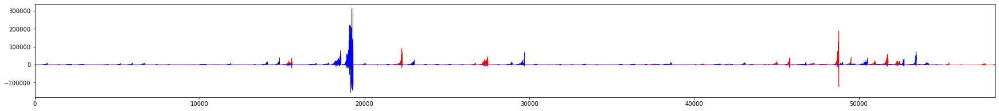

('allworld', 'small_COUNT_CUR_1') size 
 Chain1 length:  61418 Chain2 length:  55092


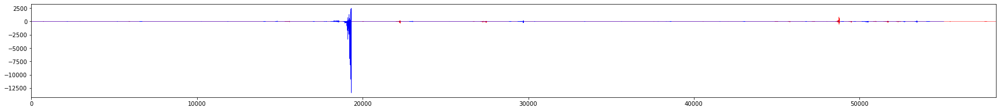

('allworld', 'small_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  61418 Chain2 length:  55092


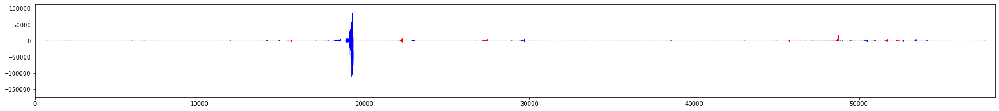

('allworld', 'small_COUNT_CUR_1') Precip 
 Chain1 length:  61418 Chain2 length:  55092


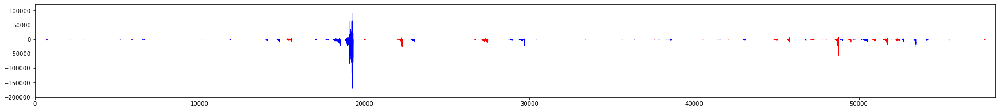

('allworld', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  47239 Chain2 length:  46809


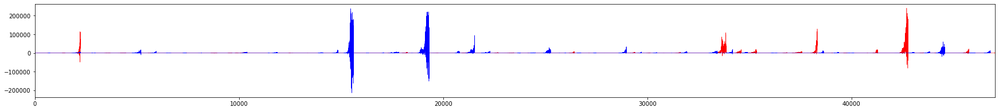

('allworld', 'small_COUNT_CUR_10') size 
 Chain1 length:  47239 Chain2 length:  46809


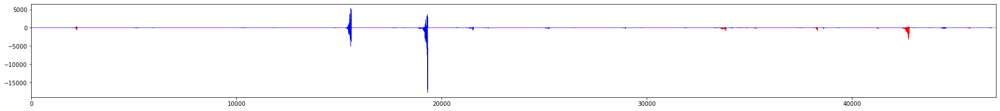

('allworld', 'small_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  47239 Chain2 length:  46809


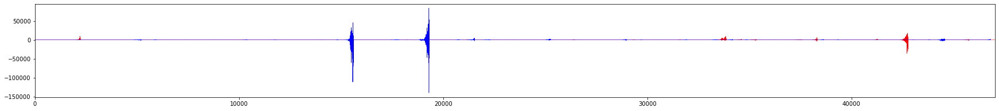

('allworld', 'small_COUNT_CUR_10') Precip 
 Chain1 length:  47239 Chain2 length:  46809


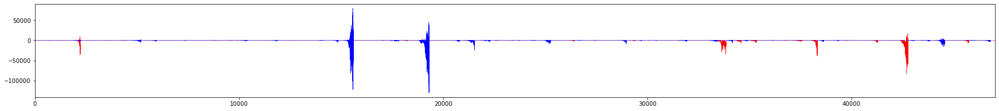

('allworld', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  58006 Chain2 length:  60183


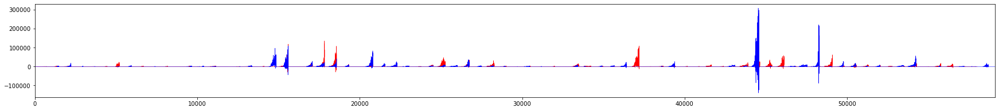

('allworld', 'small_COUNT_CUR_100') size 
 Chain1 length:  58006 Chain2 length:  60183


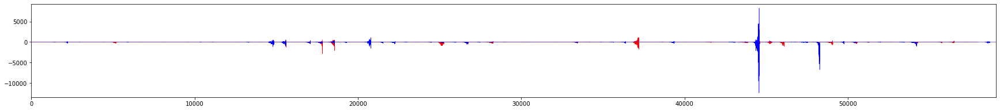

('allworld', 'small_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  58006 Chain2 length:  60183


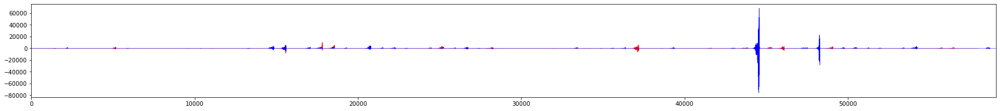

('allworld', 'small_COUNT_CUR_100') Precip 
 Chain1 length:  58006 Chain2 length:  60183


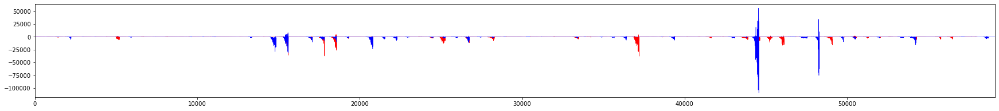

('allworld', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  56870


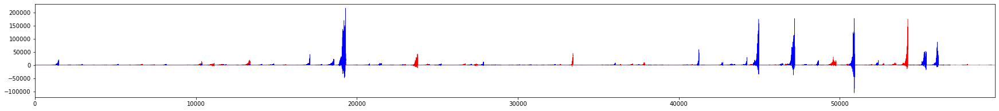

('allworld', 'small_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  56870


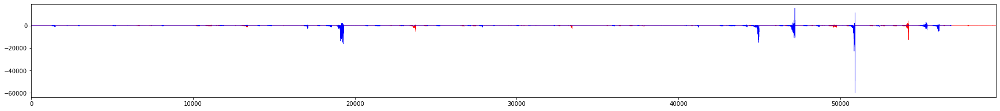

('allworld', 'small_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  56870


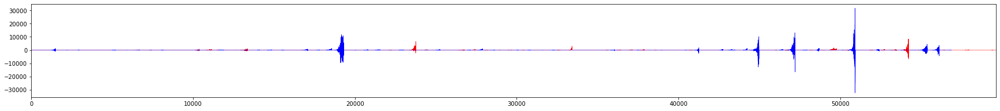

('allworld', 'small_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  56870


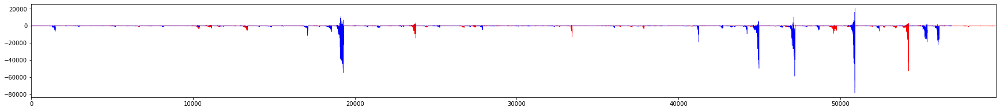

('allworld', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  45416 Chain2 length:  60183


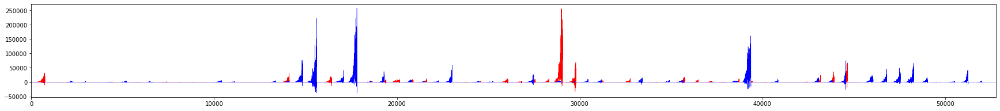

('allworld', 'small_COUNT_NAT_1') size 
 Chain1 length:  45416 Chain2 length:  60183


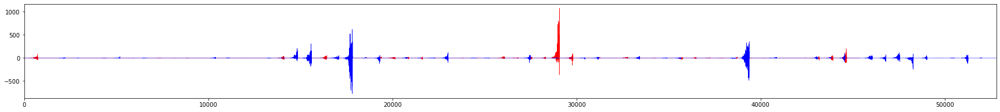

('allworld', 'small_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  45416 Chain2 length:  60183


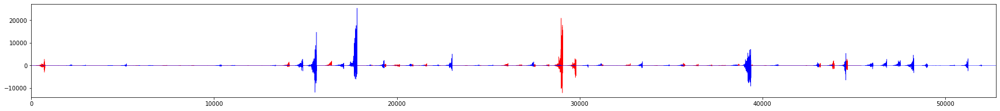

('allworld', 'small_COUNT_NAT_1') Precip 
 Chain1 length:  45416 Chain2 length:  60183


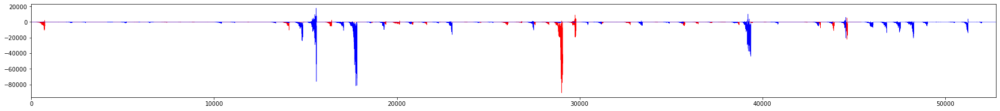

('allworld', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  61669 Chain2 length:  60183


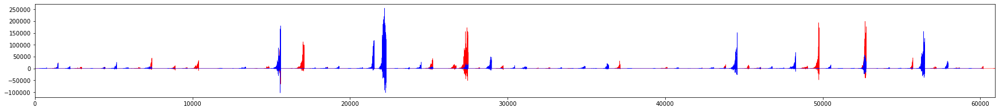

('allworld', 'small_COUNT_NAT_10') size 
 Chain1 length:  61669 Chain2 length:  60183


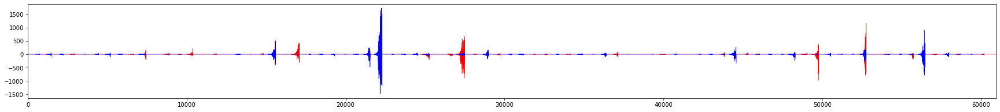

('allworld', 'small_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  61669 Chain2 length:  60183


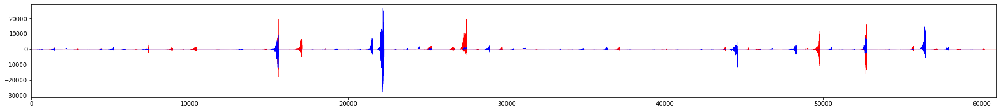

('allworld', 'small_COUNT_NAT_10') Precip 
 Chain1 length:  61669 Chain2 length:  60183


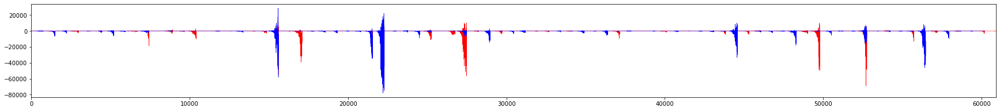

('allworld', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  61669 Chain2 length:  60183


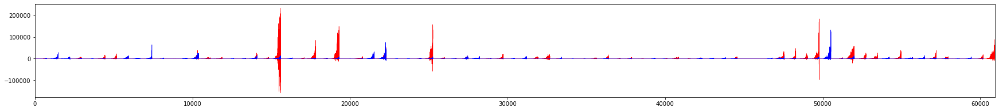

('allworld', 'small_COUNT_NAT_100') size 
 Chain1 length:  61669 Chain2 length:  60183


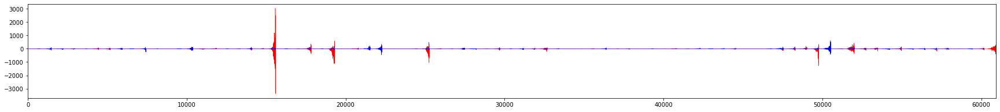

('allworld', 'small_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  61669 Chain2 length:  60183


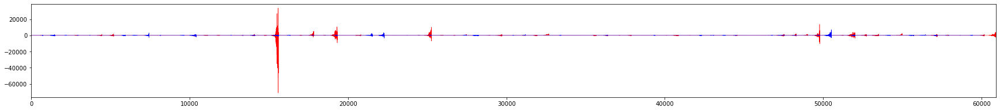

('allworld', 'small_COUNT_NAT_100') Precip 
 Chain1 length:  61669 Chain2 length:  60183


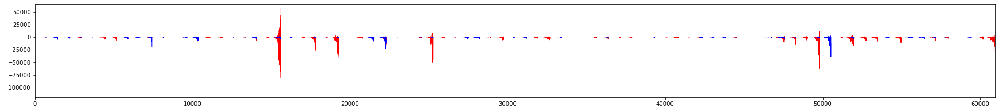

('allworld', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  61669 Chain2 length:  61669


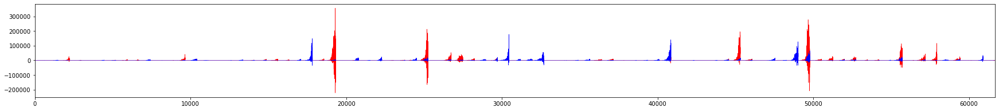

('allworld', 'small_COUNT_NAT_1000') size 
 Chain1 length:  61669 Chain2 length:  61669


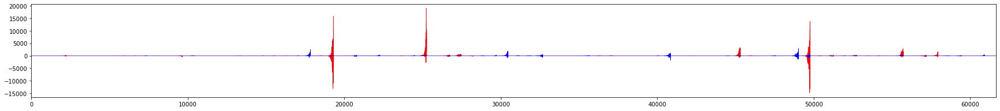

('allworld', 'small_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  61669 Chain2 length:  61669


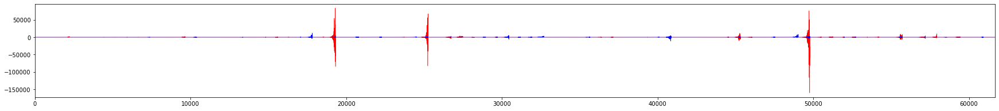

('allworld', 'small_COUNT_NAT_1000') Precip 
 Chain1 length:  61669 Chain2 length:  61669


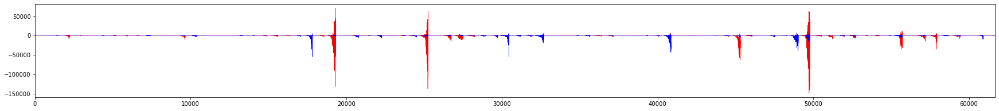

('allworld', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


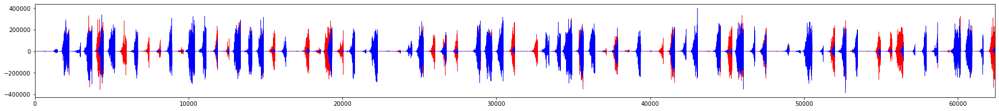

('allworld', 'large_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


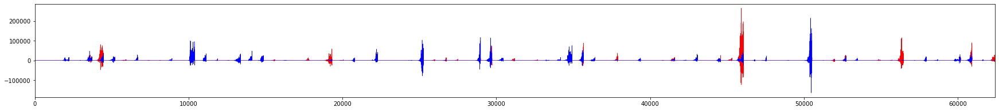

('allworld', 'large_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


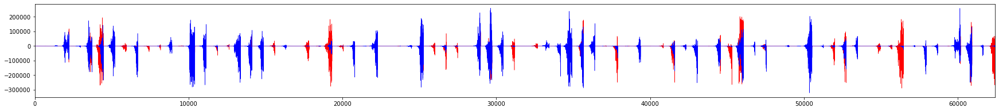

('allworld', 'large_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


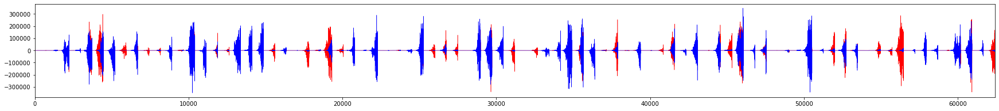

('allworld', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


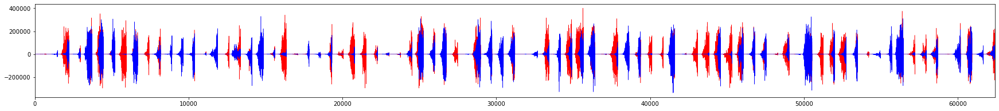

('allworld', 'large_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


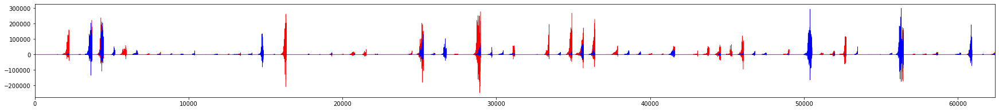

('allworld', 'large_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


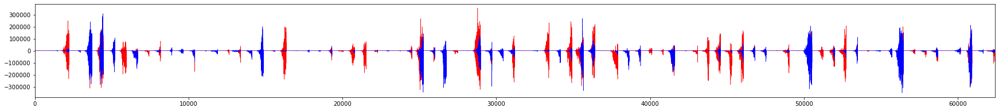

('allworld', 'large_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


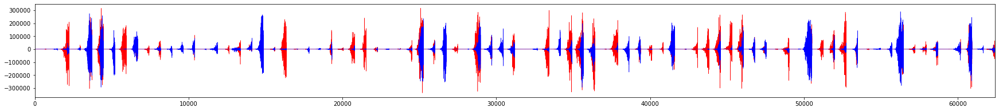

('allworld', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


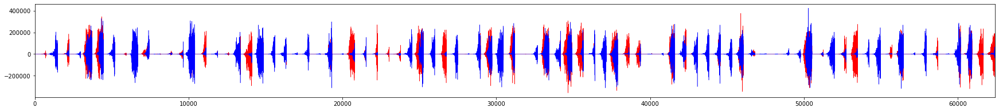

('allworld', 'large_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


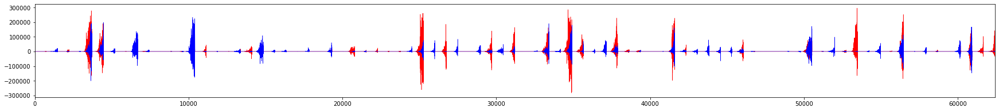

('allworld', 'large_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


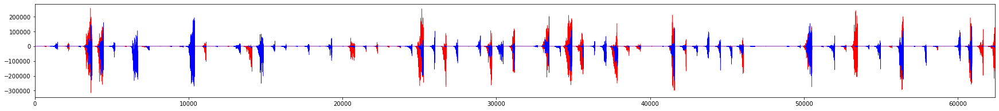

('allworld', 'large_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


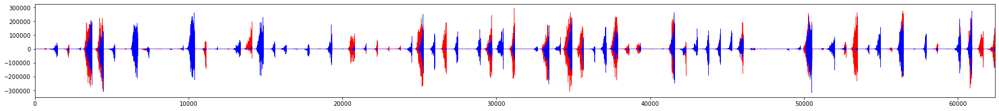

('allworld', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


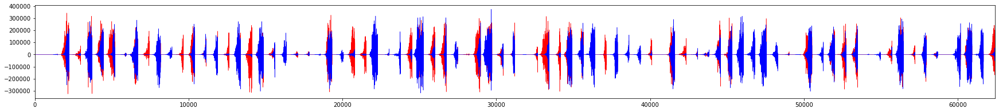

('allworld', 'large_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


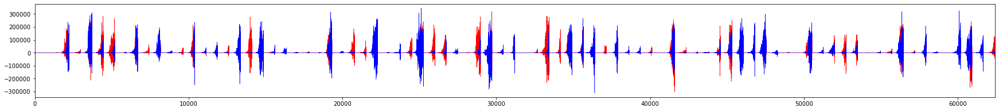

('allworld', 'large_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


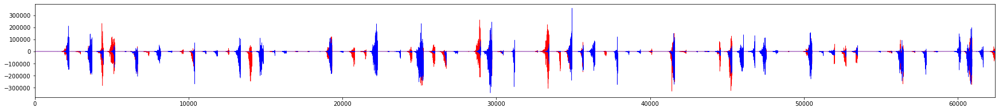

('allworld', 'large_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


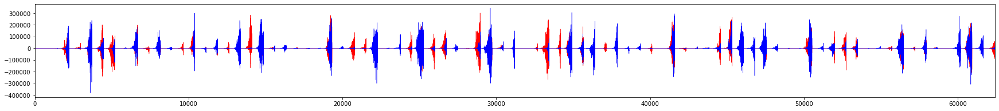

('allworld', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


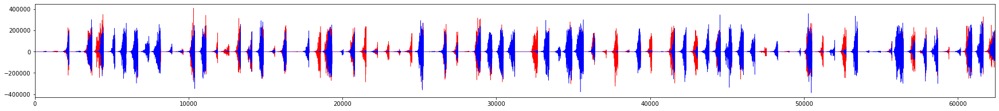

('allworld', 'large_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


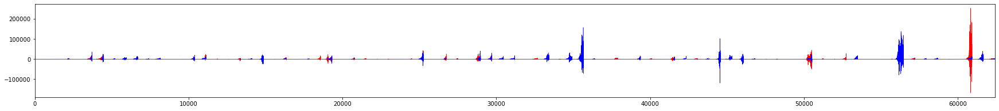

('allworld', 'large_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


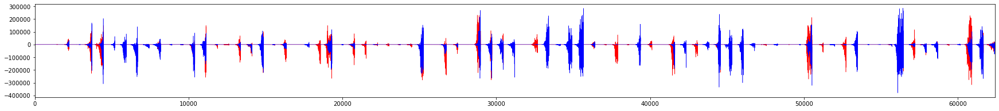

('allworld', 'large_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


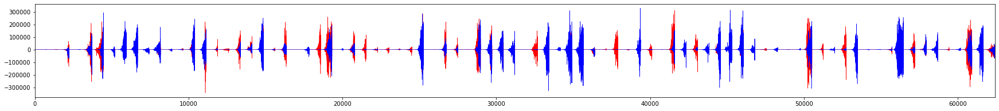

('allworld', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


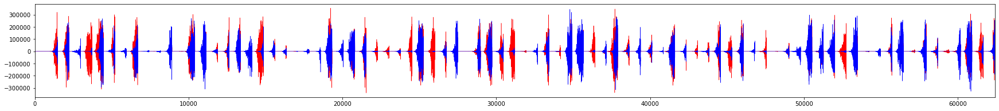

('allworld', 'large_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


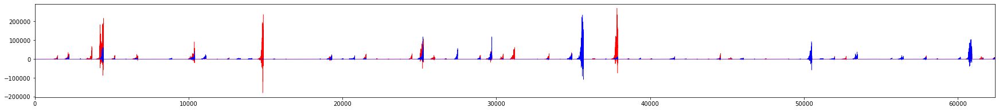

('allworld', 'large_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


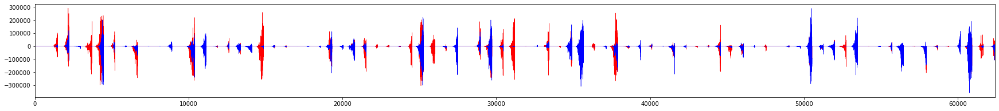

('allworld', 'large_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


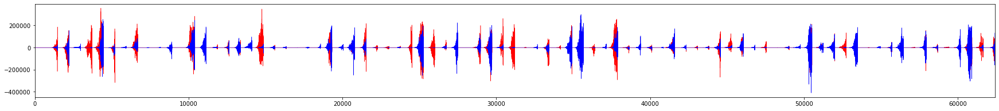

('allworld', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


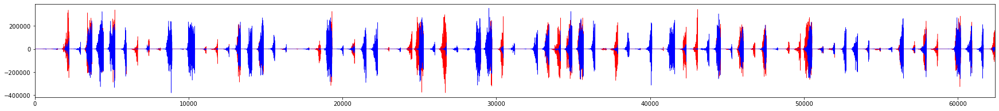

('allworld', 'large_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


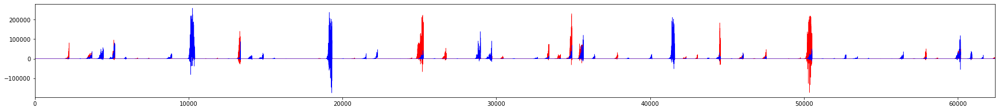

('allworld', 'large_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


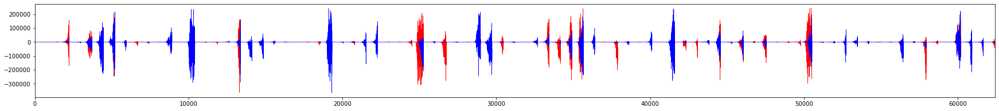

('allworld', 'large_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


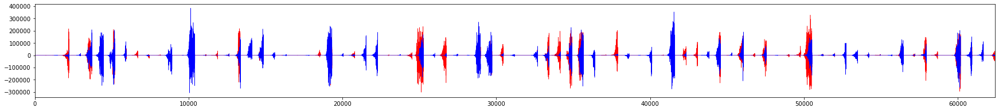

('allworld', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


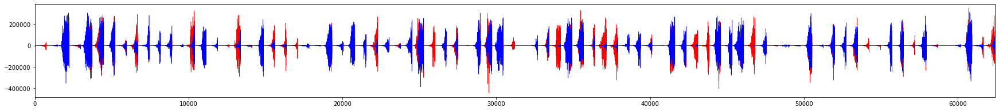

('allworld', 'large_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


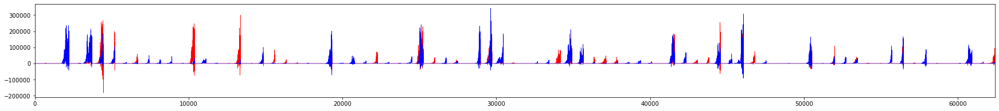

('allworld', 'large_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


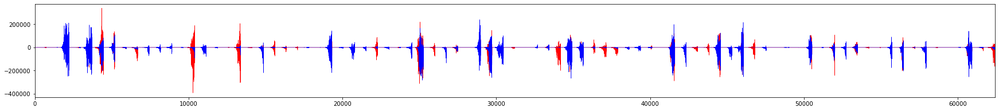

('allworld', 'large_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


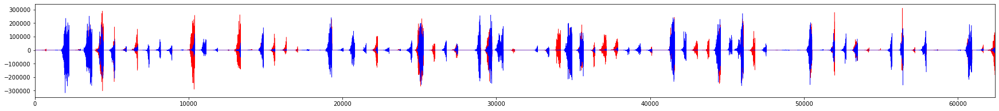

('NW', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


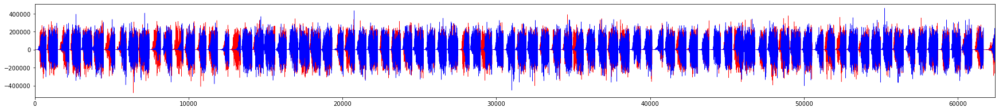

('NW', 'small_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


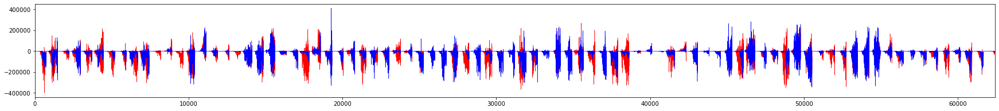

('NW', 'small_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


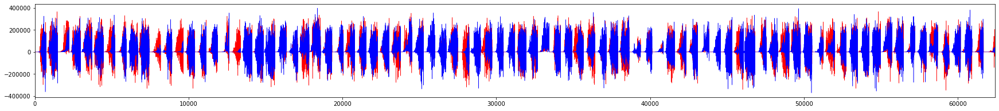

('NW', 'small_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


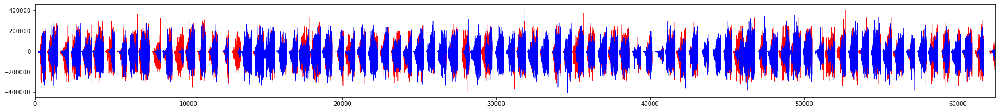

('NW', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


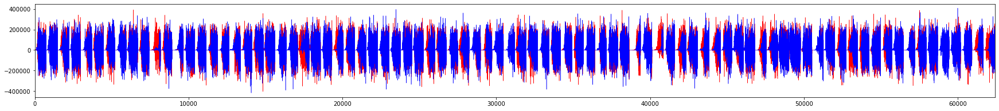

('NW', 'small_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


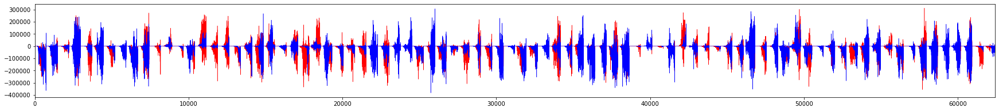

('NW', 'small_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


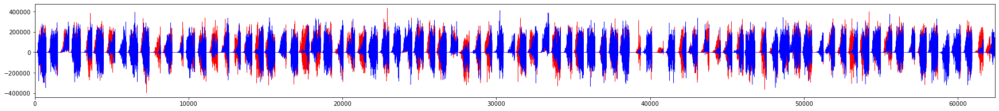

('NW', 'small_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


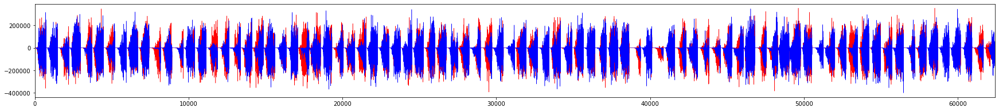

('NW', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


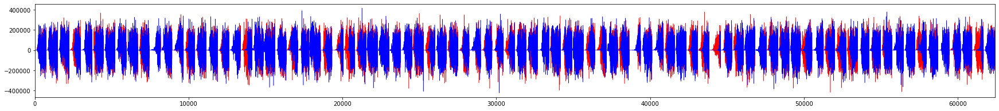

('NW', 'small_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


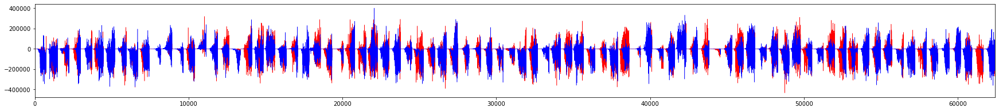

('NW', 'small_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


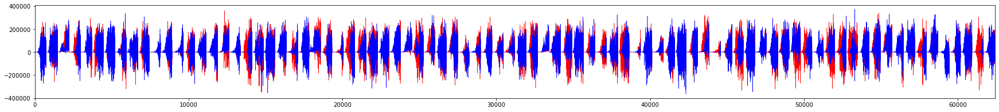

('NW', 'small_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


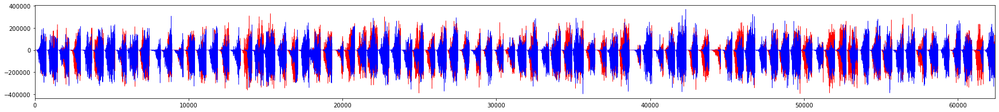

('NW', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


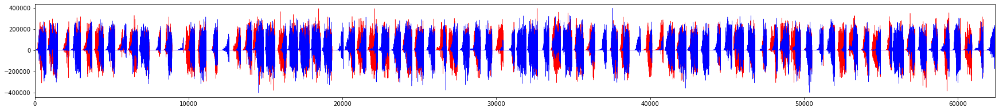

('NW', 'small_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


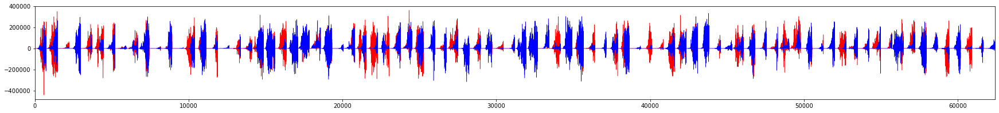

('NW', 'small_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


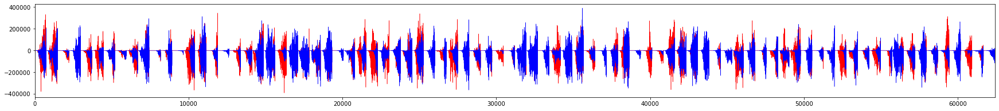

('NW', 'small_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


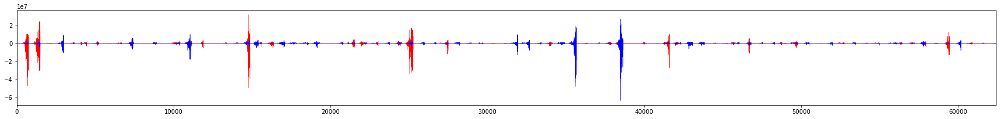

('NW', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


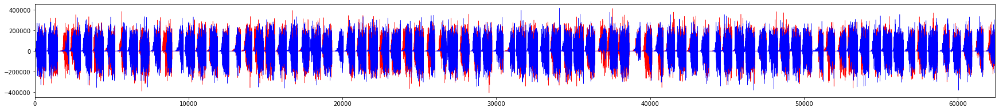

('NW', 'small_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


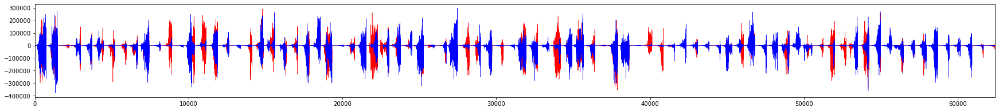

('NW', 'small_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


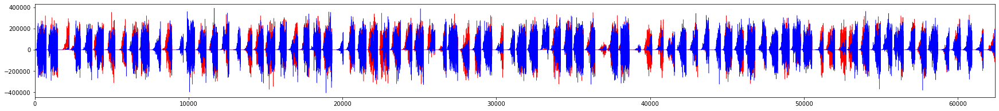

('NW', 'small_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


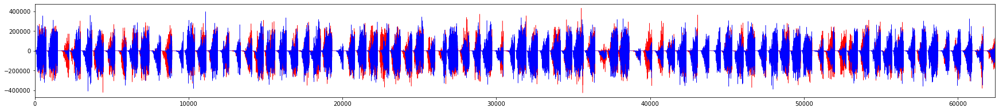

('NW', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


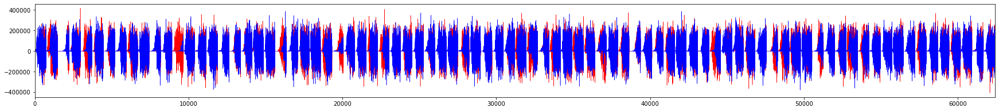

('NW', 'small_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


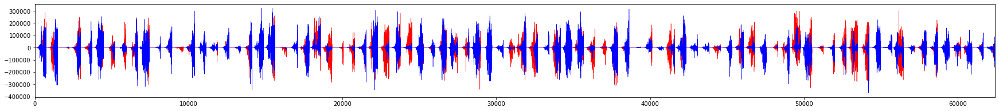

('NW', 'small_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


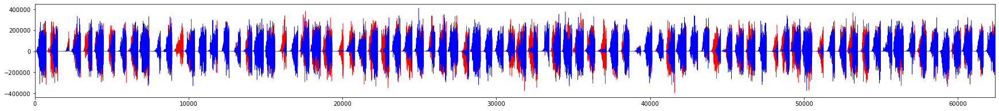

('NW', 'small_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


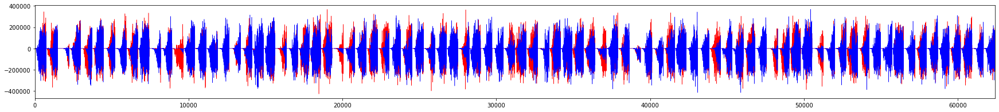

('NW', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


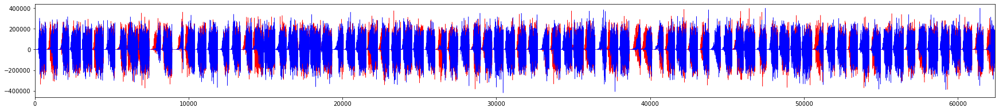

('NW', 'small_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


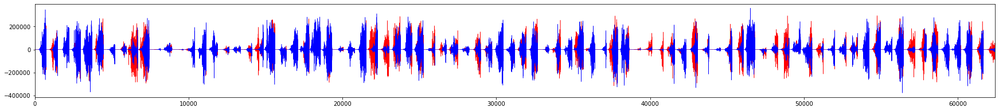

('NW', 'small_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


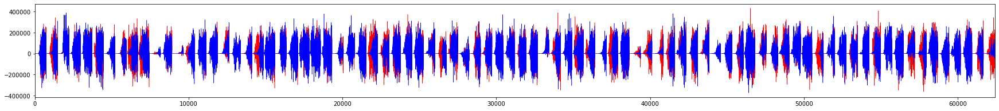

('NW', 'small_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


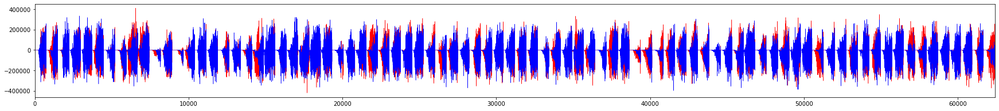

('NW', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


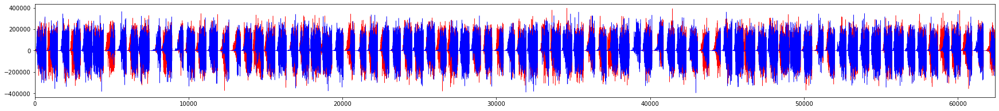

('NW', 'small_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


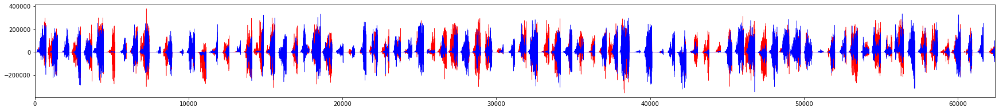

('NW', 'small_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


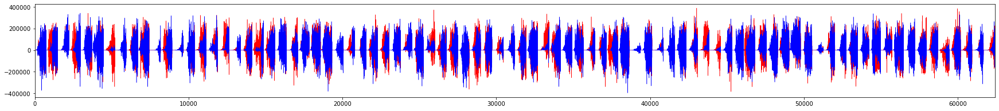

('NW', 'small_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


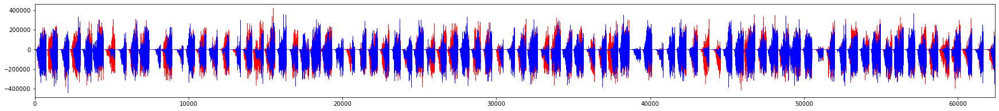

('NW', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


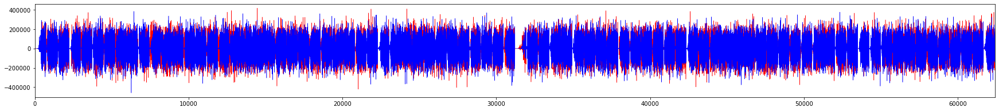

('NW', 'large_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


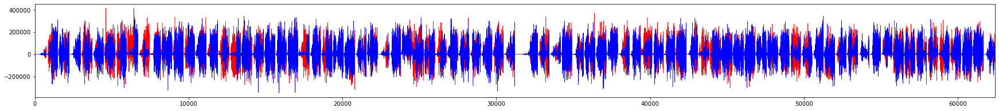

('NW', 'large_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


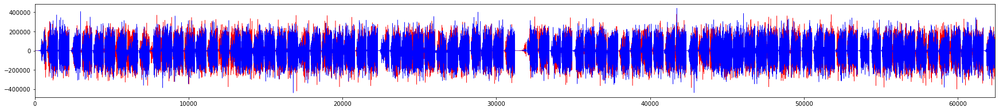

('NW', 'large_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


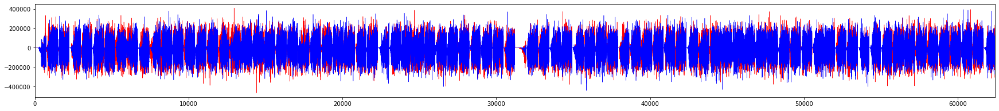

('NW', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


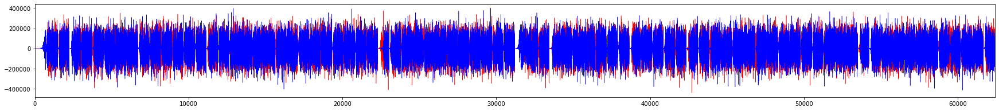

('NW', 'large_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


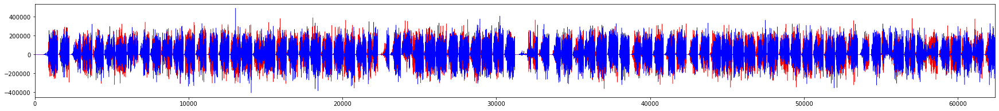

('NW', 'large_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


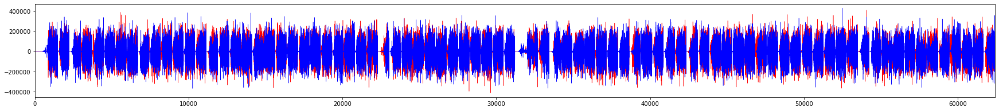

('NW', 'large_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


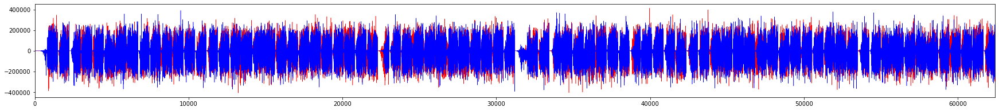

('NW', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


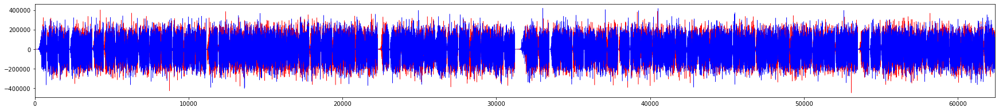

('NW', 'large_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


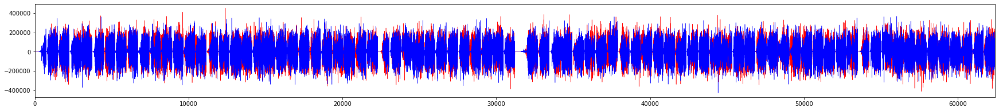

('NW', 'large_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


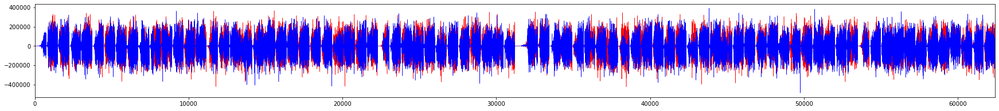

('NW', 'large_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


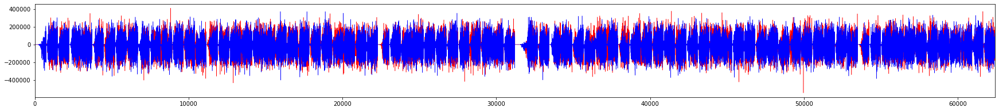

('NW', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


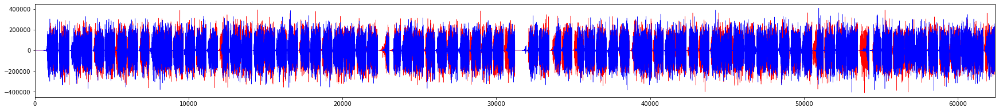

('NW', 'large_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


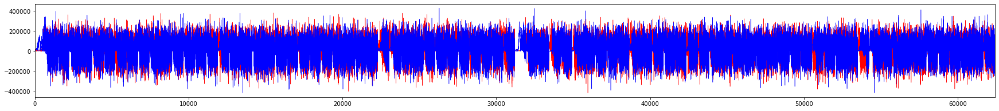

('NW', 'large_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


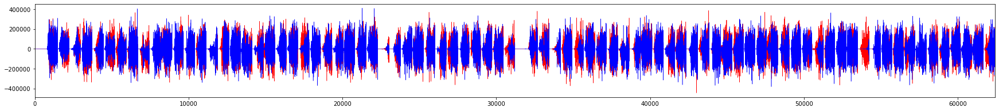

('NW', 'large_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


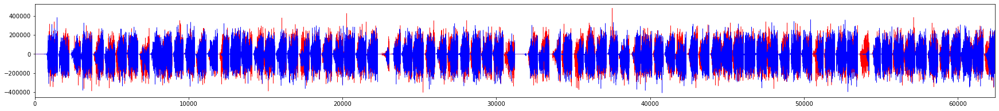

('NW', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


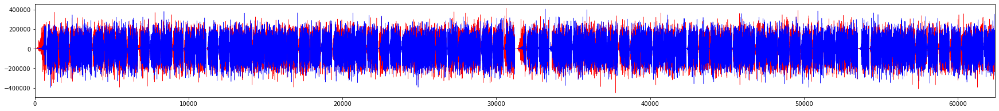

('NW', 'large_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


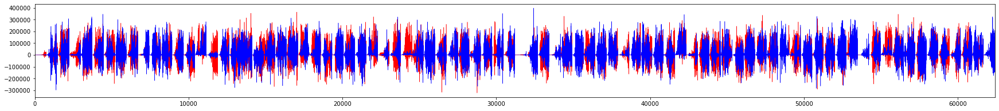

('NW', 'large_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


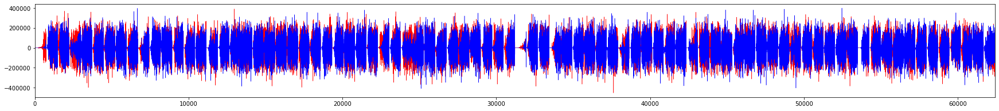

('NW', 'large_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


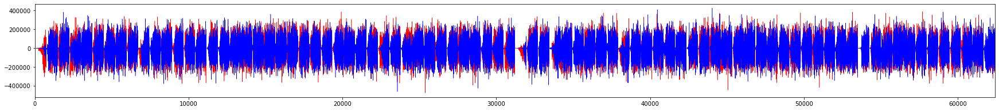

('NW', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


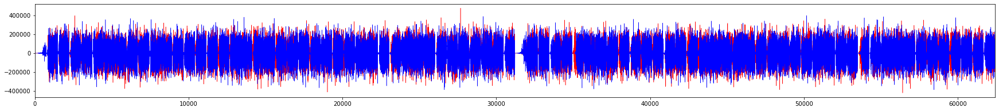

('NW', 'large_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


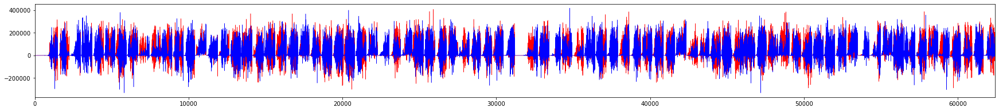

('NW', 'large_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


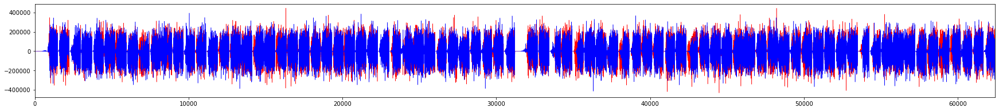

('NW', 'large_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


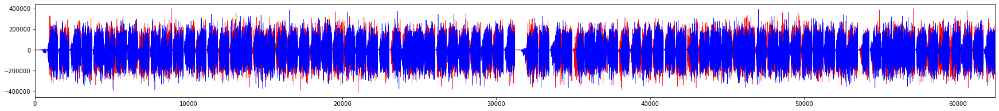

('NW', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


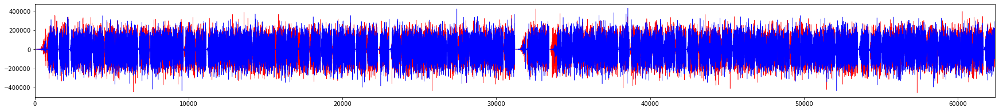

('NW', 'large_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


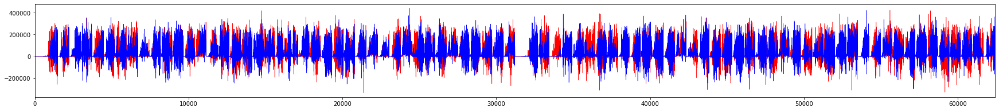

('NW', 'large_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


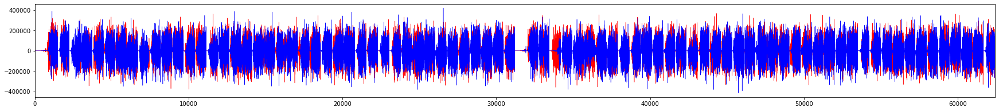

('NW', 'large_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


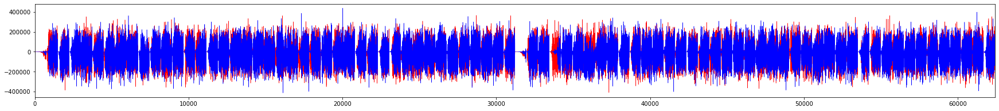

('NW', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


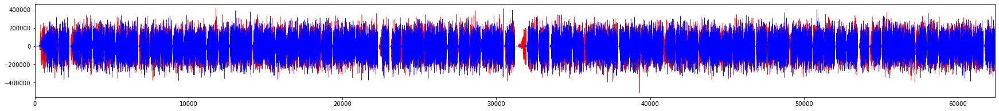

('NW', 'large_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


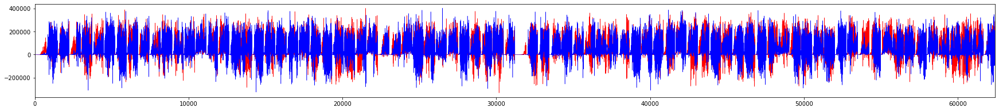

('NW', 'large_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


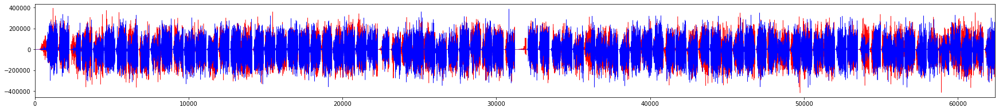

('NW', 'large_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


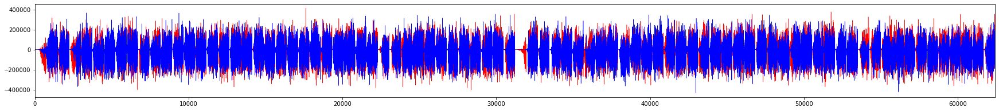

('OW', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


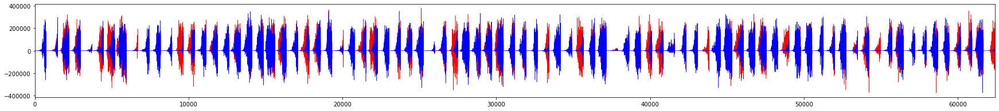

('OW', 'small_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


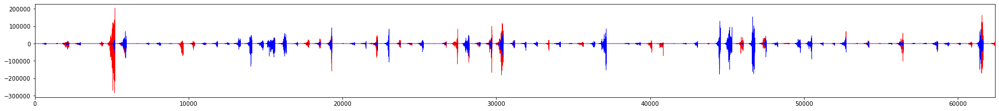

('OW', 'small_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


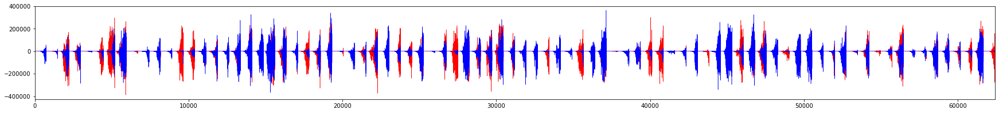

('OW', 'small_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


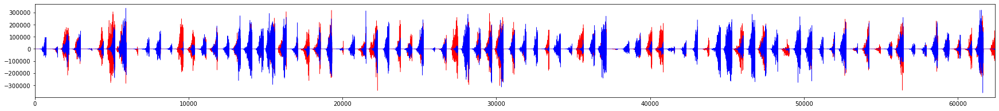

('OW', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


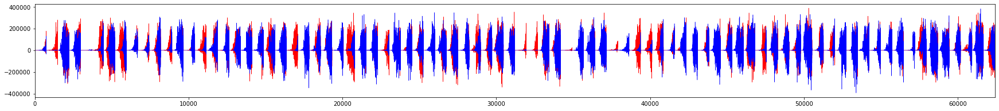

('OW', 'small_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


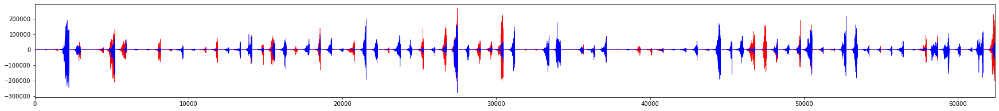

('OW', 'small_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


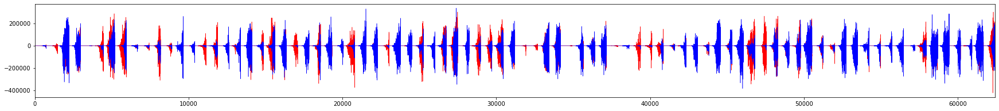

('OW', 'small_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


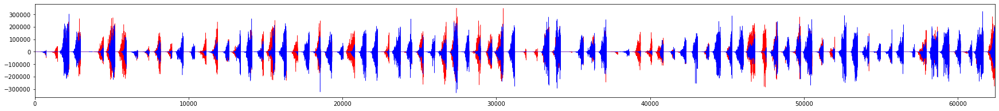

('OW', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


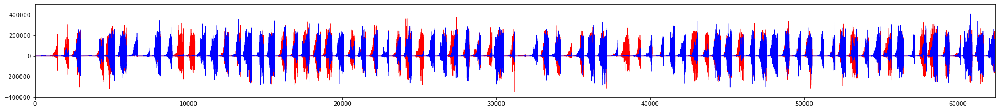

('OW', 'small_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


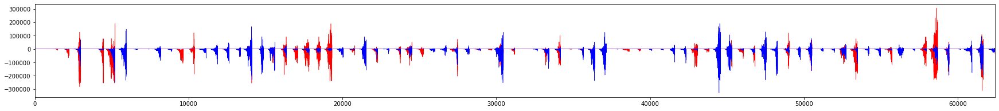

('OW', 'small_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


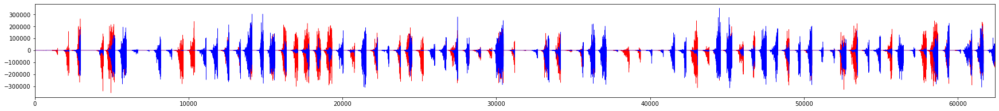

('OW', 'small_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


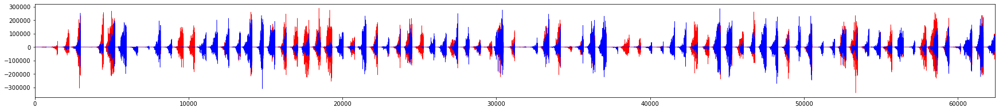

('OW', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


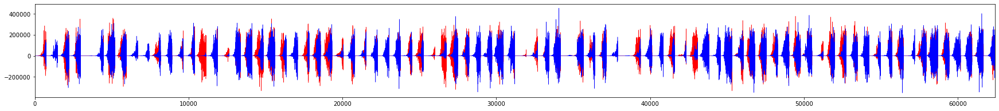

('OW', 'small_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


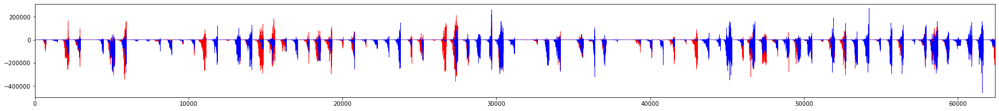

('OW', 'small_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


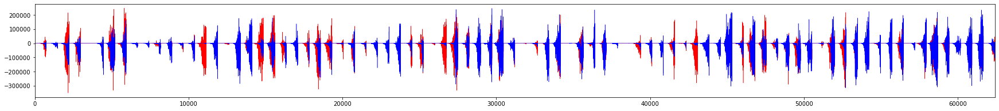

('OW', 'small_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


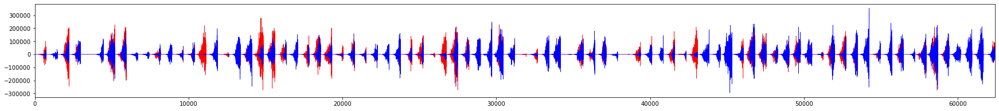

('OW', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


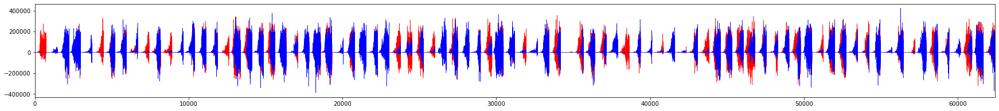

('OW', 'small_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


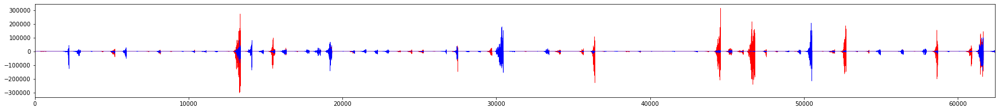

('OW', 'small_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


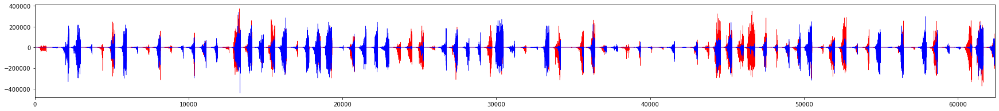

('OW', 'small_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


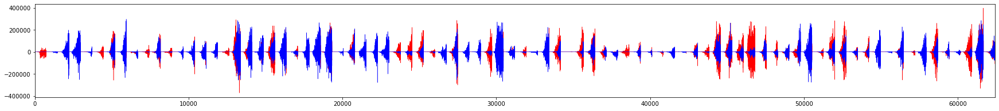

('OW', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


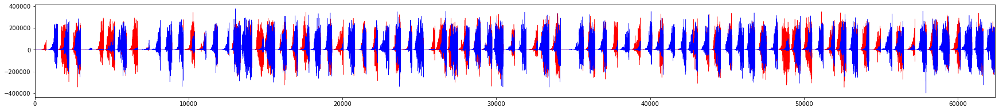

('OW', 'small_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


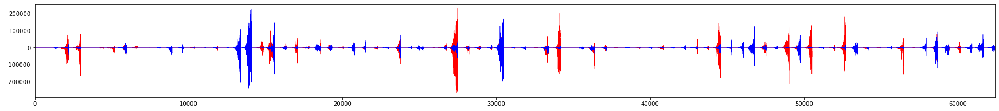

('OW', 'small_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


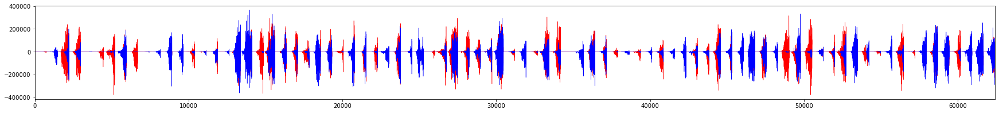

('OW', 'small_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


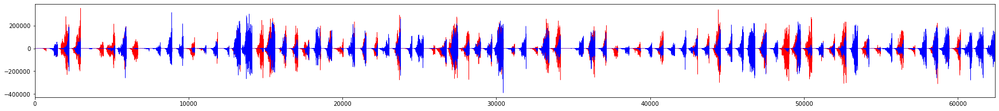

('OW', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


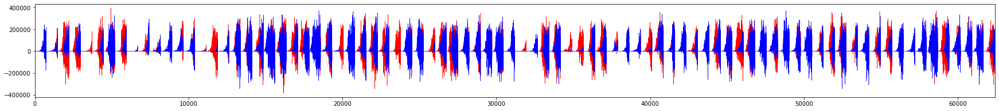

('OW', 'small_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


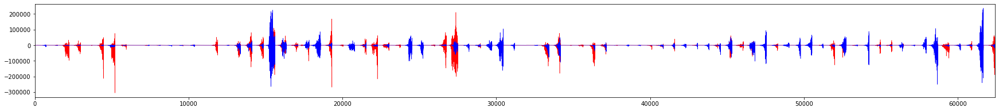

('OW', 'small_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


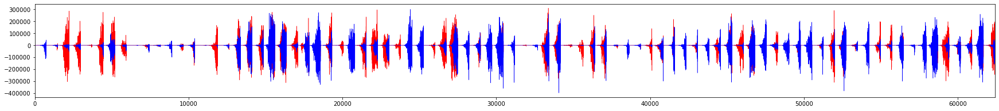

('OW', 'small_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


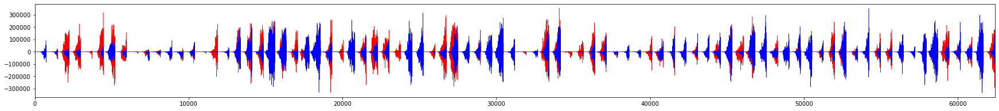

('OW', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


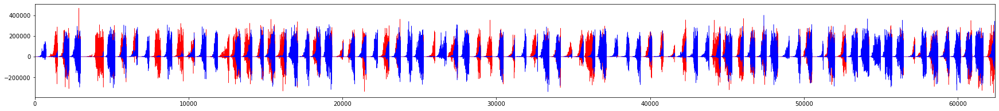

('OW', 'small_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


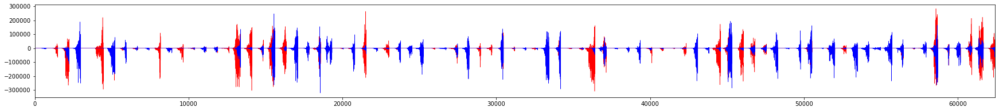

('OW', 'small_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


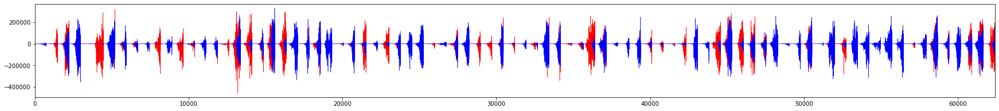

('OW', 'small_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


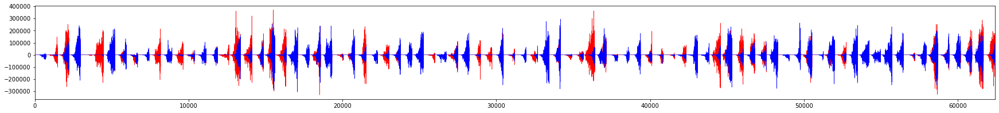

('OW', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


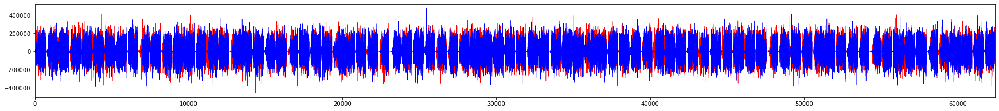

('OW', 'large_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


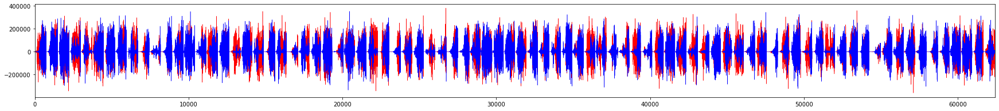

('OW', 'large_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


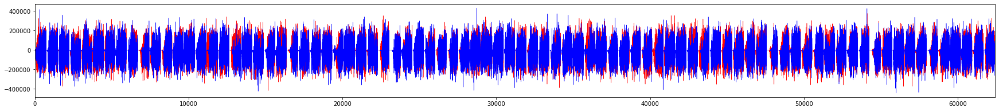

('OW', 'large_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


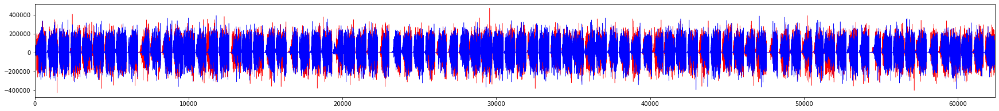

('OW', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


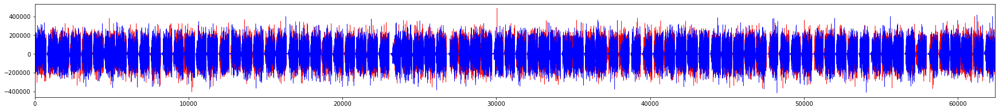

('OW', 'large_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


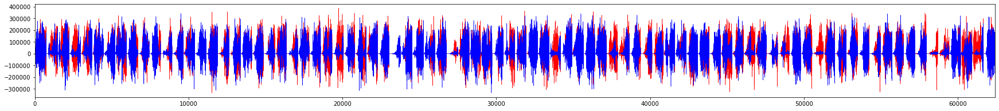

('OW', 'large_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


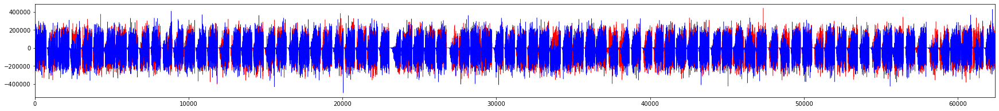

('OW', 'large_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


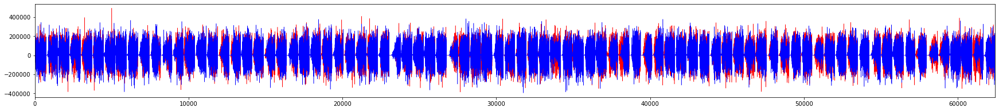

('OW', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


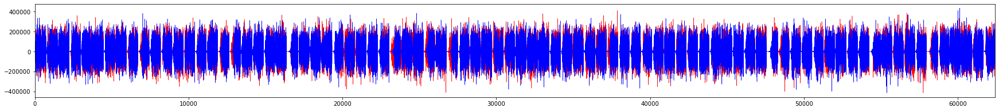

('OW', 'large_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


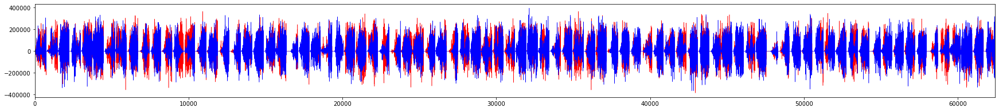

('OW', 'large_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


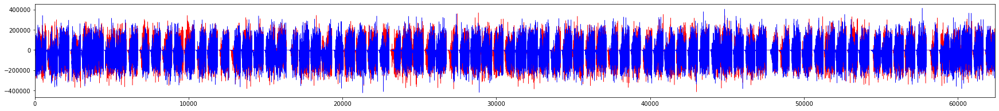

('OW', 'large_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


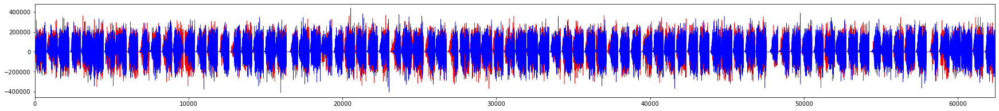

('OW', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


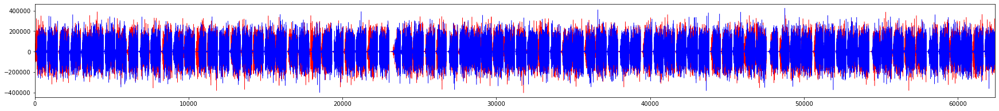

('OW', 'large_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


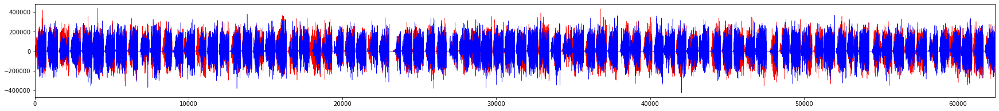

('OW', 'large_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


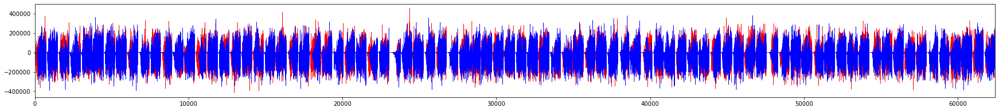

('OW', 'large_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


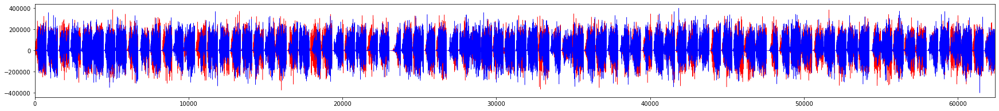

('OW', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


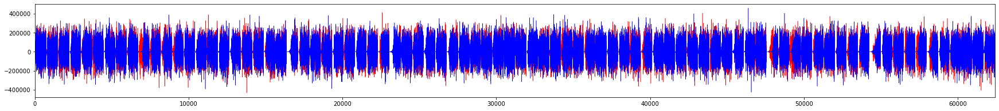

('OW', 'large_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


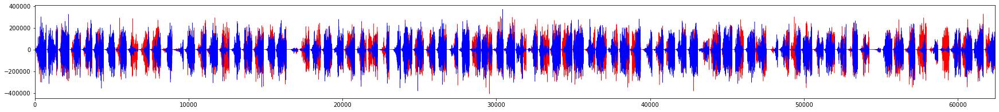

('OW', 'large_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


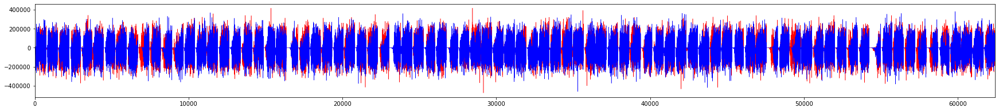

('OW', 'large_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


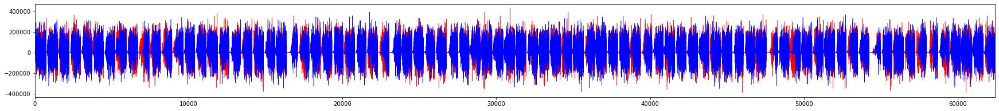

('OW', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


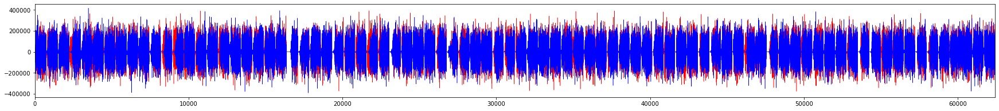

('OW', 'large_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


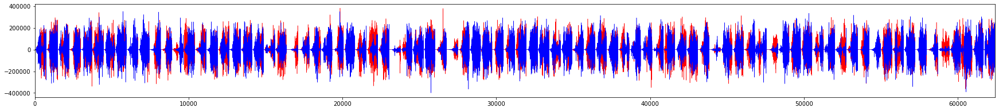

('OW', 'large_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


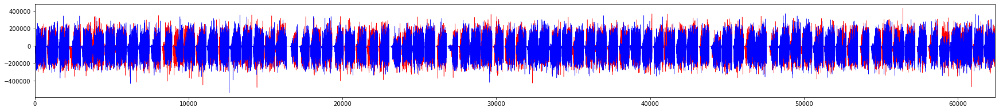

('OW', 'large_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


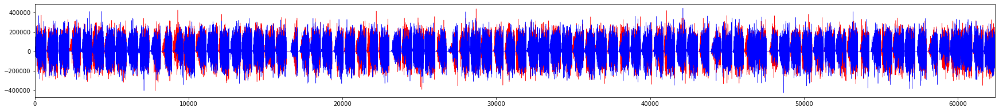

('OW', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


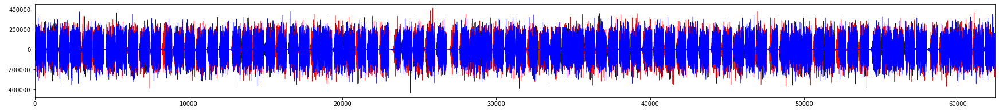

('OW', 'large_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


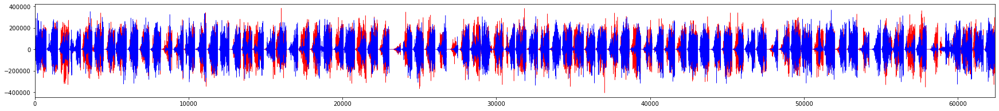

('OW', 'large_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


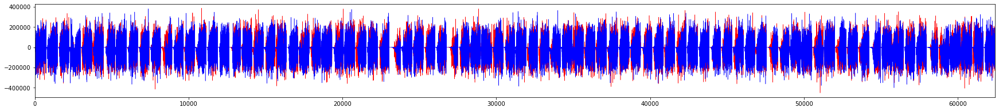

('OW', 'large_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


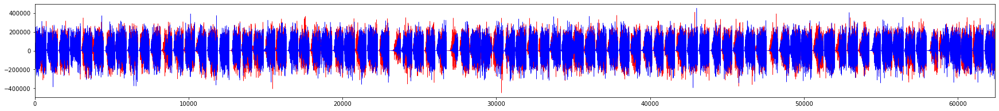

('OW', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


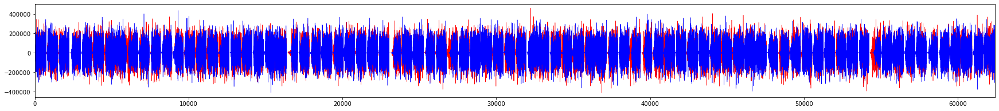

('OW', 'large_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


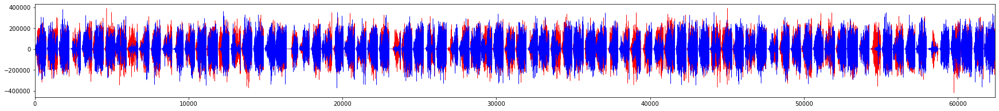

('OW', 'large_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


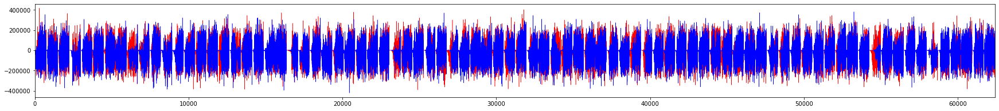

('OW', 'large_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


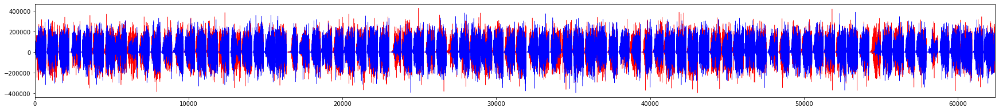

In [21]:
geos_uniq=list(alldata['geog'].unique())
size_uniq=list(alldata['sizetype'].unique())

dataset=alldata[alldata['climate']=='climate']

models=list(product(geos_uniq,size_uniq))
for model in models:
#     print(model)
    temp1=dataset[(dataset['geog']==model[0]) & (dataset['sizetype']==model[1]) & (dataset['round']=='round1')]
    temp2=dataset[(dataset['geog']==model[0]) & (dataset['sizetype']==model[1]) & (dataset['round']=='round2')]
    for col in ['intercept','size','Biome_bin1','Precip']:
        print(model,col,'\n','Chain1 length: ',len(temp1), 'Chain2 length: ',len(temp2))
        fig,ax=plt.subplots(figsize=(30,3),facecolor='w')
        ax.plot([x for x in range(len(temp1[col]))],temp1[col],c='r',lw=0.5)
        ax.plot([x for x in range(len(temp2[col]))],temp2[col],c='b',lw=0.5)
        plt.xlim(0,(len(temp1)+len(temp2))/2)
        plt.show()
        time.sleep(0.1)


('allworld', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


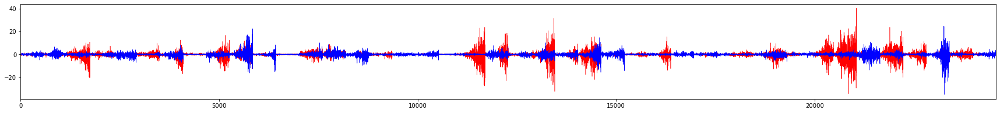

('allworld', 'small_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


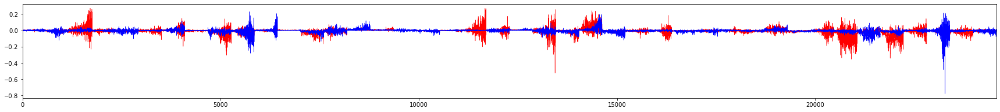

('allworld', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


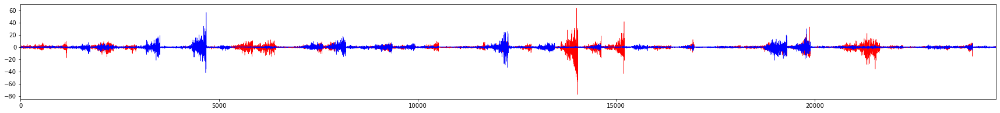

('allworld', 'small_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


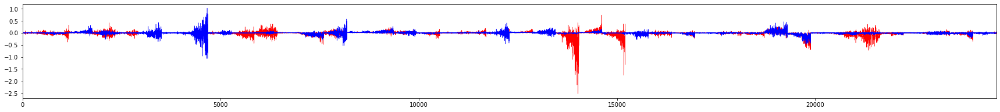

('allworld', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


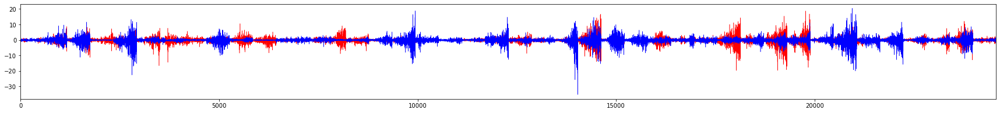

('allworld', 'small_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


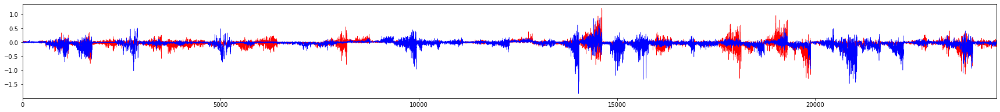

('allworld', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


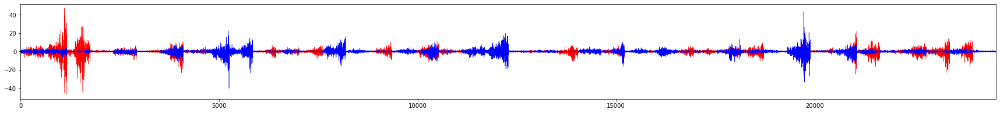

('allworld', 'small_COUNT_CUR_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


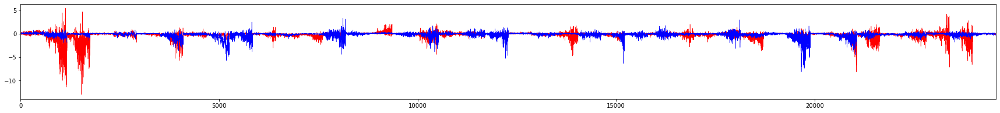

('allworld', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


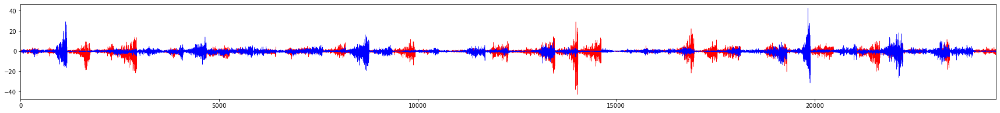

('allworld', 'small_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


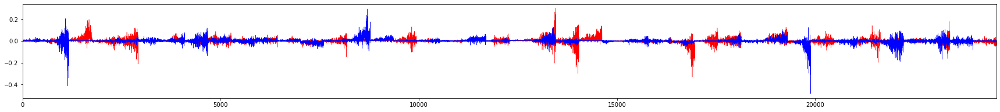

('allworld', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


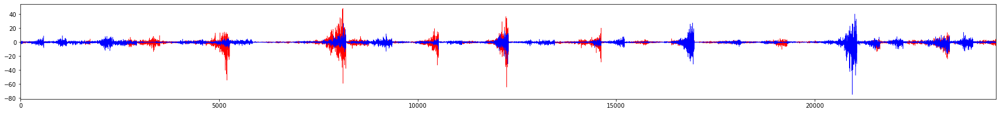

('allworld', 'small_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


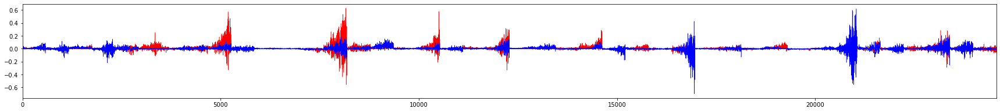

('allworld', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


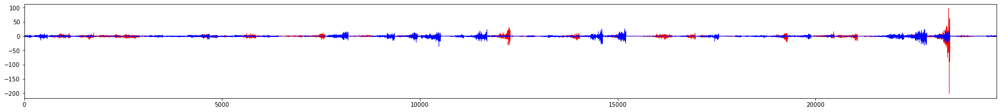

('allworld', 'small_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


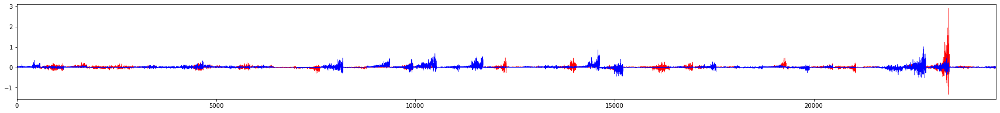

('allworld', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


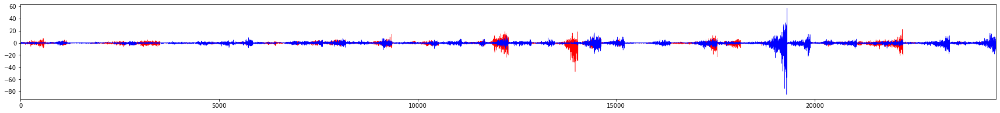

('allworld', 'small_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


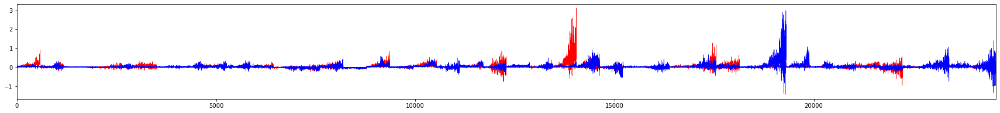

('allworld', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  47250 Chain2 length:  47250


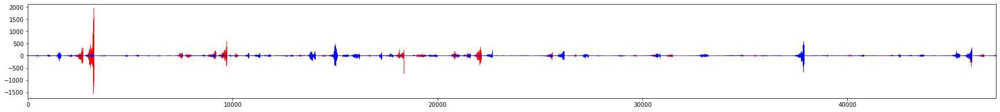

('allworld', 'large_COUNT_CUR_1') size 
 Chain1 length:  47250 Chain2 length:  47250


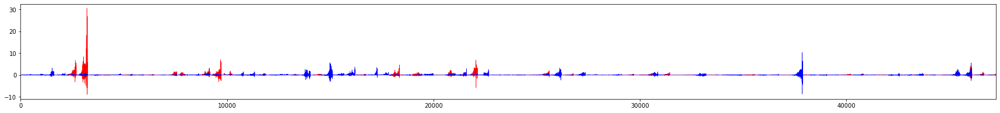

('allworld', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  47250 Chain2 length:  47250


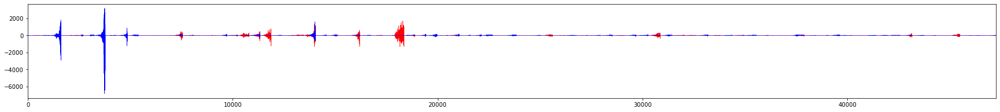

('allworld', 'large_COUNT_CUR_10') size 
 Chain1 length:  47250 Chain2 length:  47250


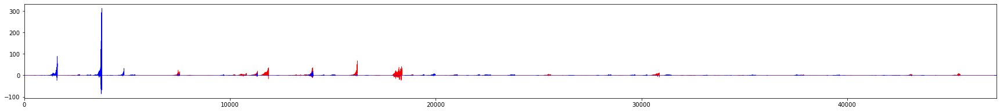

('allworld', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  47250 Chain2 length:  47250


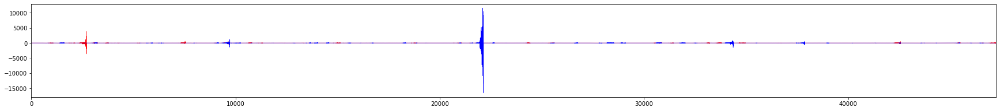

('allworld', 'large_COUNT_CUR_100') size 
 Chain1 length:  47250 Chain2 length:  47250


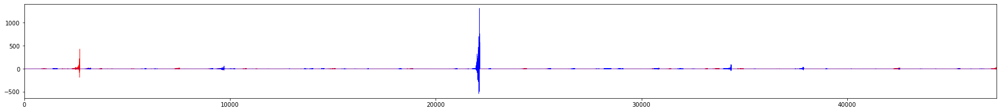

('allworld', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  47250 Chain2 length:  47250


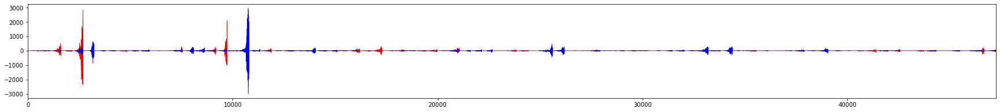

('allworld', 'large_COUNT_CUR_1000') size 
 Chain1 length:  47250 Chain2 length:  47250


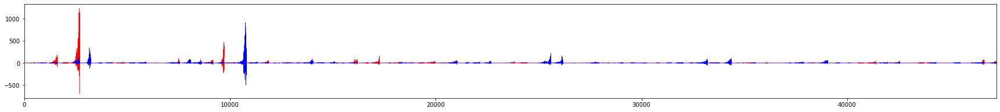

('allworld', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  47250 Chain2 length:  47250


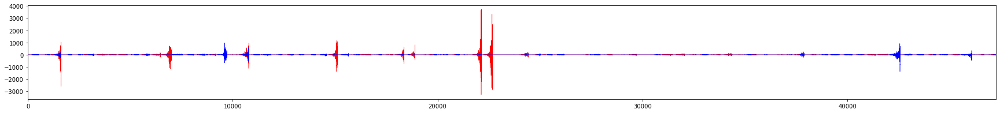

('allworld', 'large_COUNT_NAT_1') size 
 Chain1 length:  47250 Chain2 length:  47250


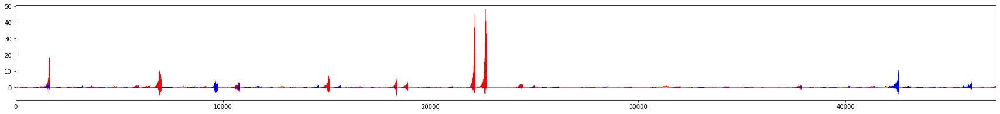

('allworld', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  47250 Chain2 length:  47250


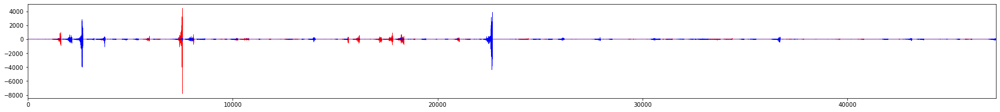

('allworld', 'large_COUNT_NAT_10') size 
 Chain1 length:  47250 Chain2 length:  47250


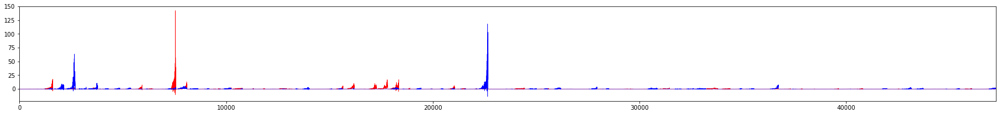

('allworld', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  47250 Chain2 length:  47250


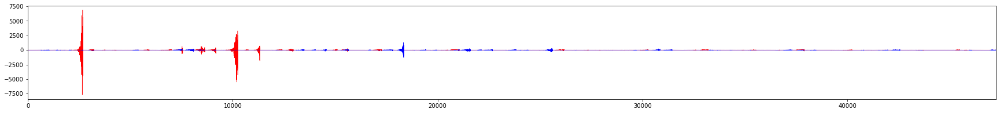

('allworld', 'large_COUNT_NAT_100') size 
 Chain1 length:  47250 Chain2 length:  47250


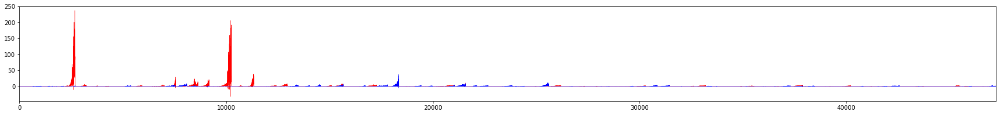

('allworld', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  47250 Chain2 length:  47250


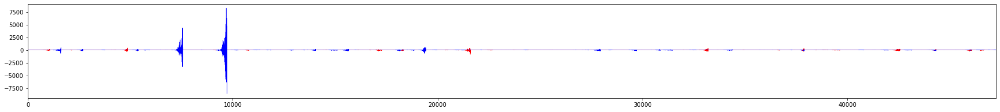

('allworld', 'large_COUNT_NAT_1000') size 
 Chain1 length:  47250 Chain2 length:  47250


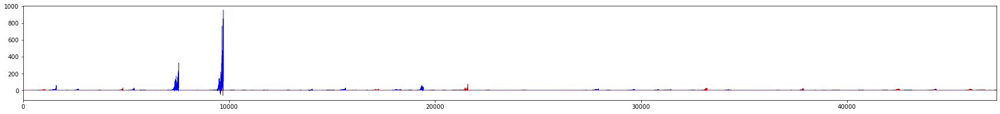

('NW', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


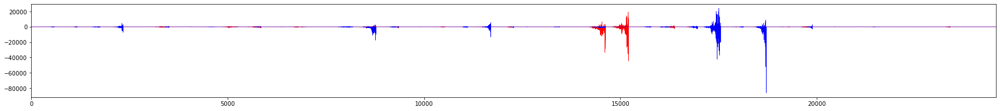

('NW', 'small_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


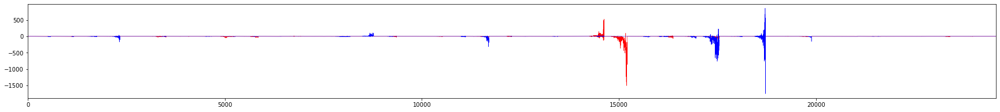

('NW', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


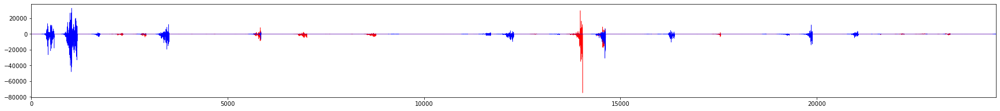

('NW', 'small_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


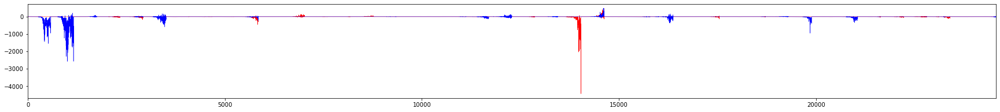

('NW', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


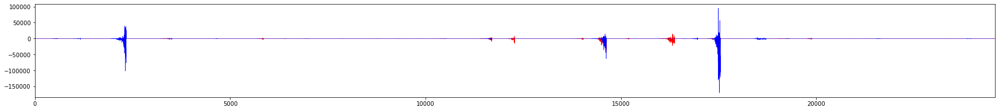

('NW', 'small_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


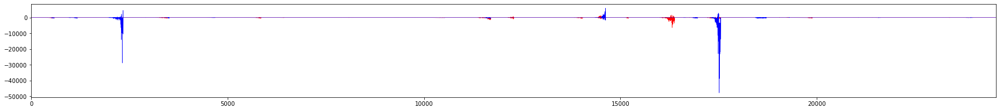

('NW', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  0 Chain2 length:  0


C:\Users\xtorrm\Documents\Python3\lib\site-packages\ipykernel_launcher.py:16: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  app.launch_new_instance()


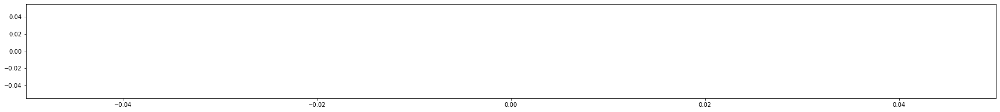

('NW', 'small_COUNT_CUR_1000') size 
 Chain1 length:  0 Chain2 length:  0


C:\Users\xtorrm\Documents\Python3\lib\site-packages\ipykernel_launcher.py:16: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  app.launch_new_instance()


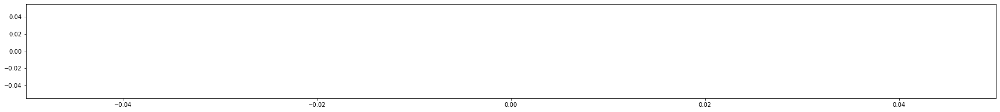

('NW', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


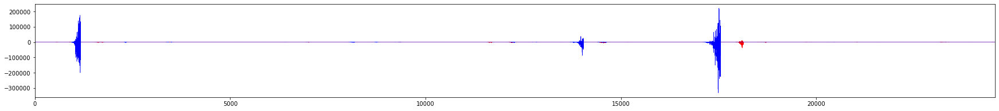

('NW', 'small_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


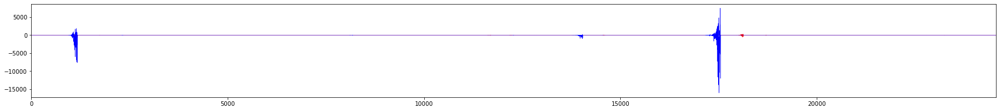

('NW', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


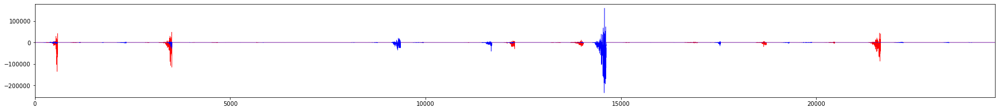

('NW', 'small_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


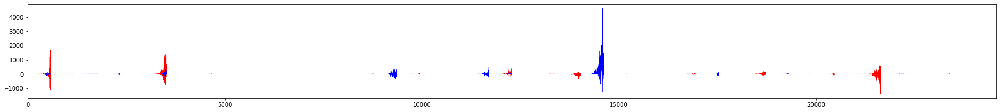

('NW', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


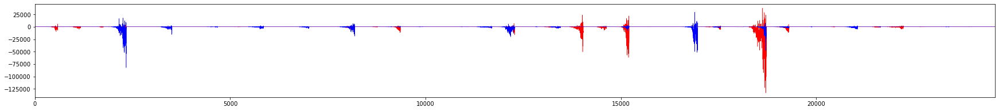

('NW', 'small_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


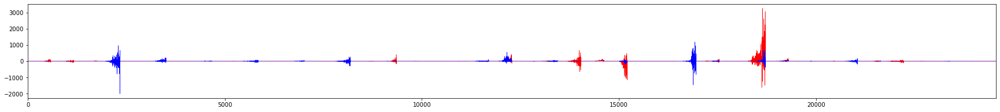

('NW', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


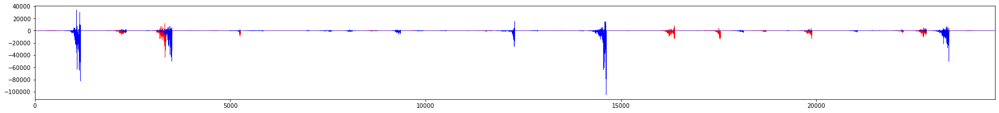

('NW', 'small_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


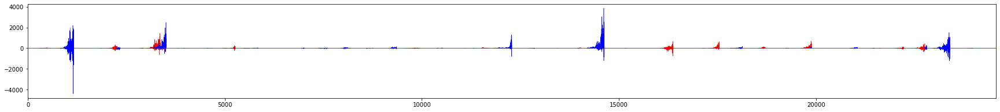

('NW', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


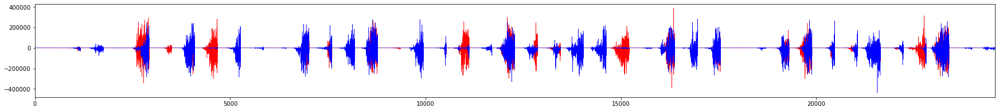

('NW', 'large_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


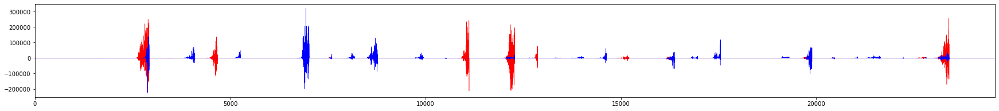

('NW', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


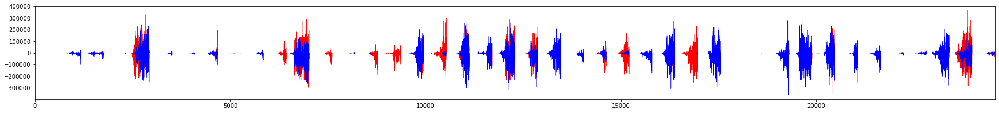

('NW', 'large_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


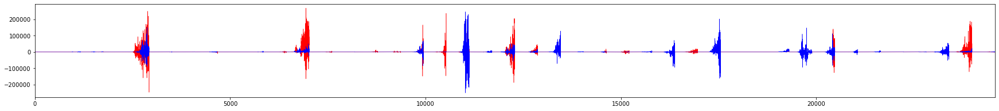

('NW', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


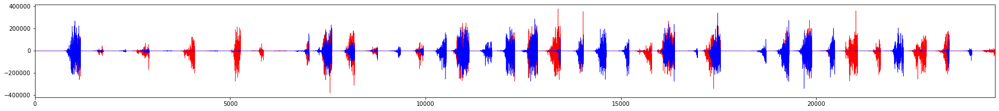

('NW', 'large_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


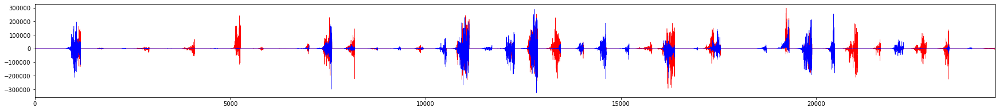

('NW', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


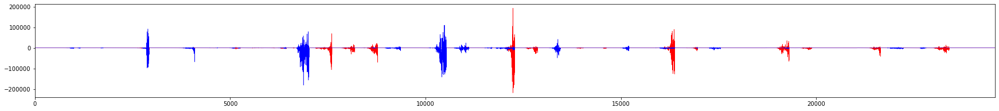

('NW', 'large_COUNT_CUR_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


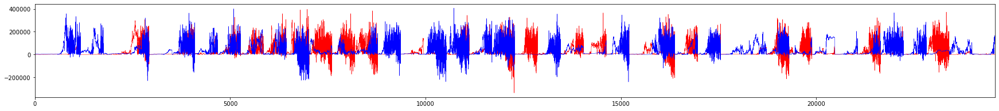

('NW', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


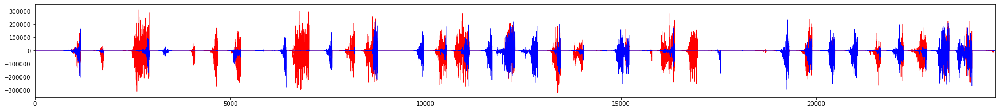

('NW', 'large_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


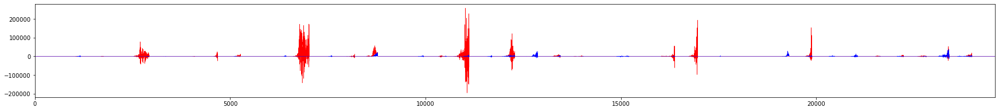

('NW', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


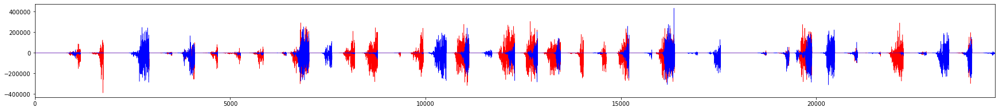

('NW', 'large_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


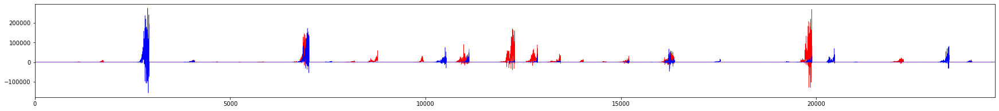

('NW', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


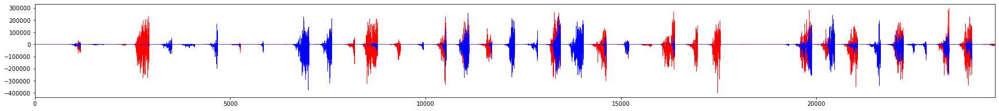

('NW', 'large_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


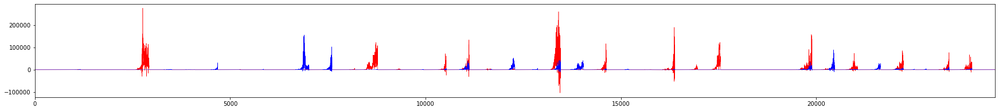

('NW', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


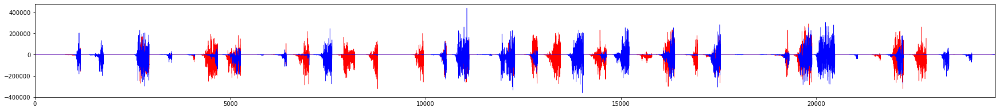

('NW', 'large_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


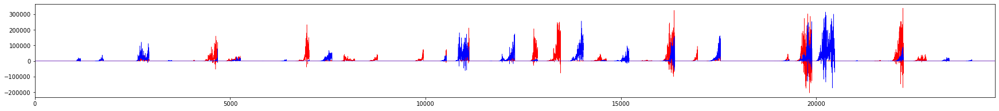

('OW', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


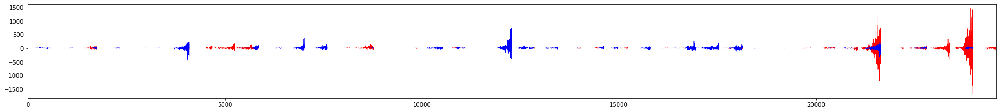

('OW', 'small_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


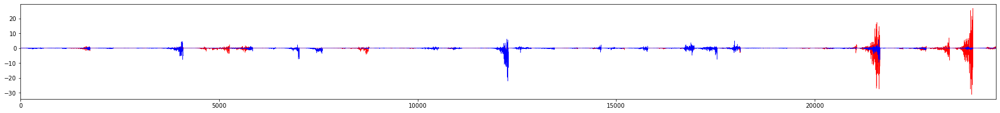

('OW', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


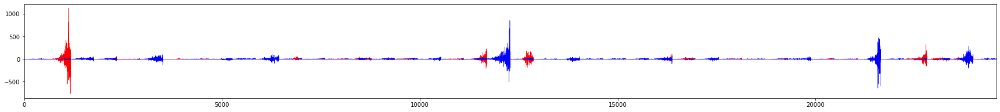

('OW', 'small_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


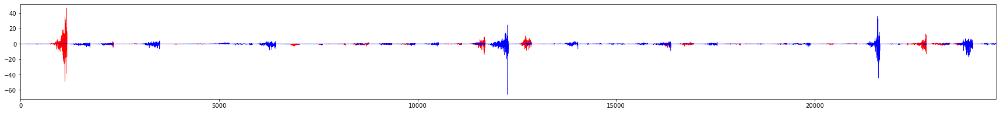

('OW', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


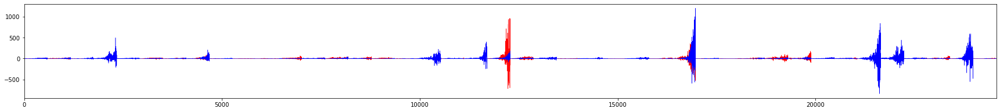

('OW', 'small_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


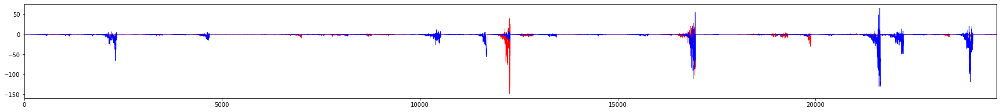

('OW', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


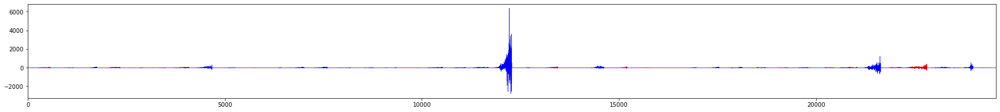

('OW', 'small_COUNT_CUR_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


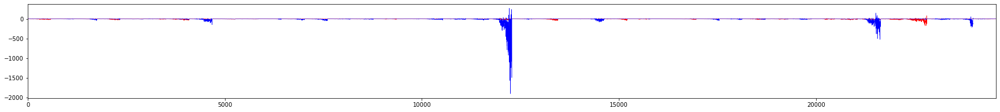

('OW', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


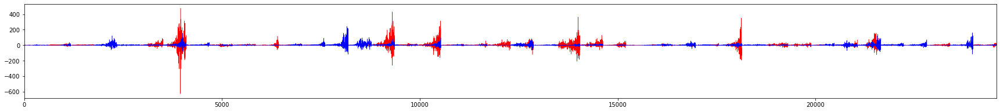

('OW', 'small_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


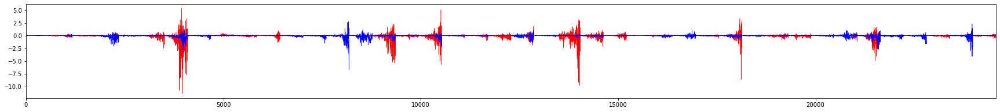

('OW', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


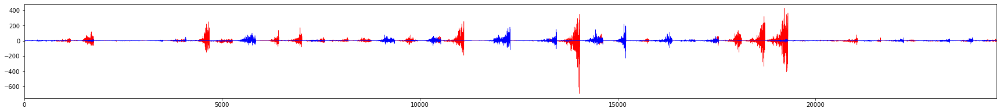

('OW', 'small_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


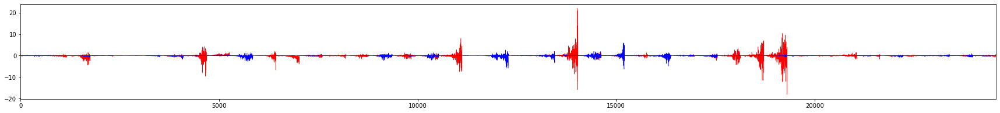

('OW', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


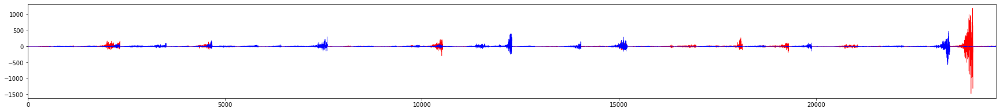

('OW', 'small_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


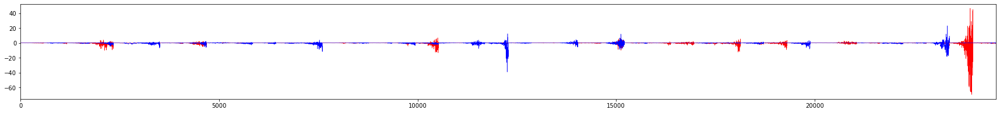

('OW', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


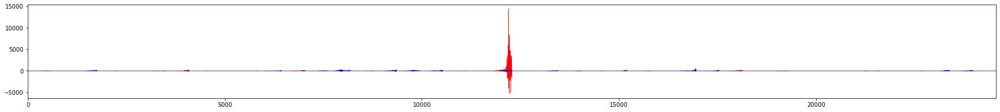

('OW', 'small_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


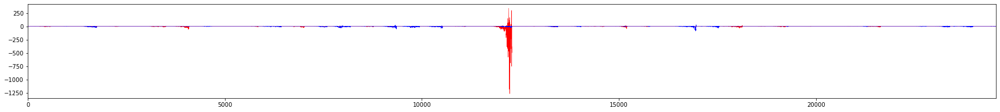

('OW', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


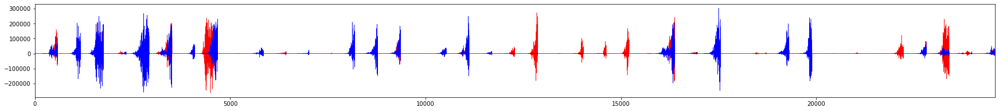

('OW', 'large_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


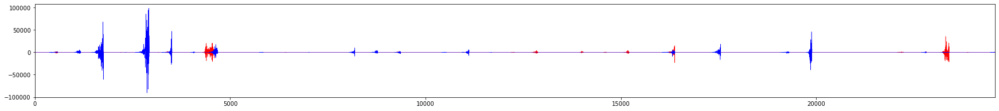

('OW', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


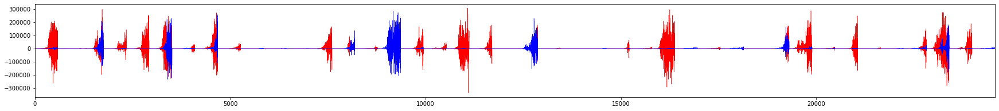

('OW', 'large_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


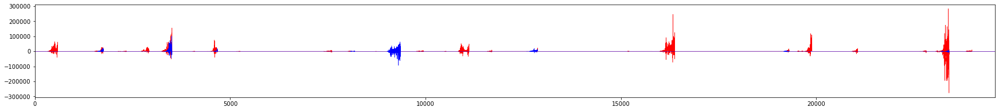

('OW', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


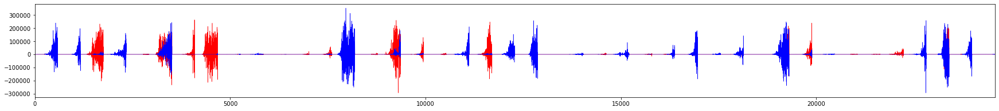

('OW', 'large_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


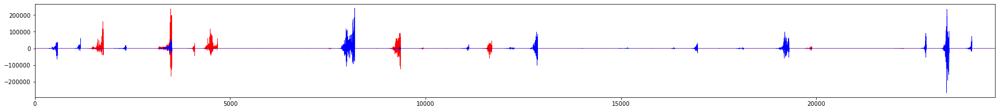

('OW', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


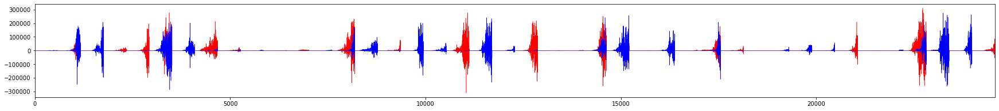

('OW', 'large_COUNT_CUR_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


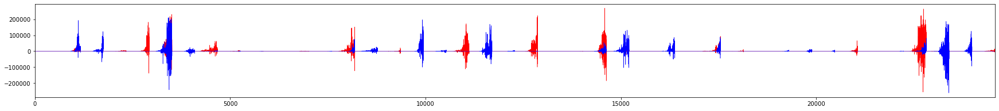

('OW', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


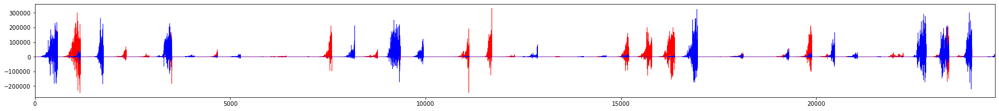

('OW', 'large_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


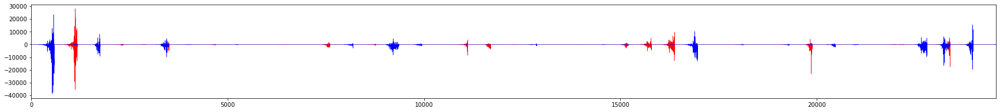

('OW', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


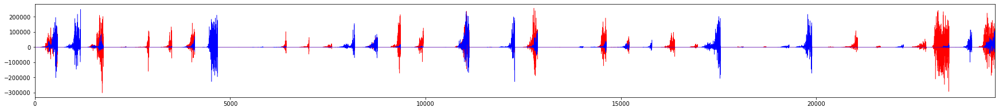

('OW', 'large_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


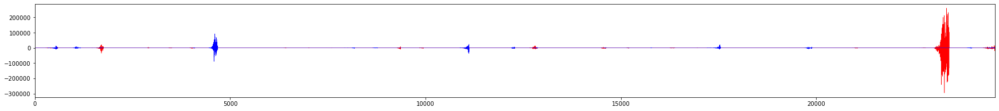

('OW', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


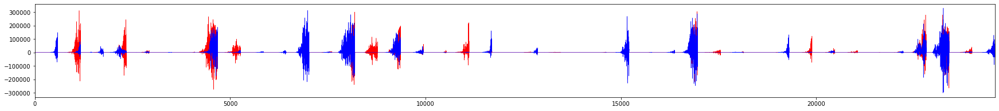

('OW', 'large_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


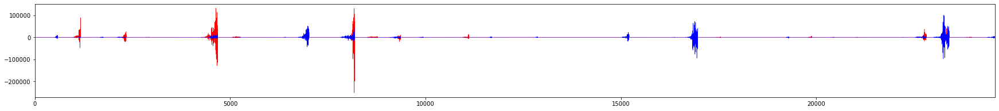

('OW', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


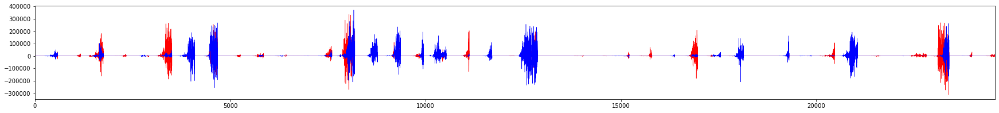

('OW', 'large_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


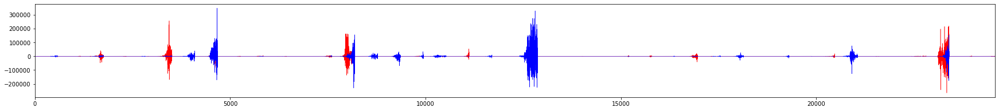

In [31]:
geos_uniq=list(alldata['geog'].unique())
size_uniq=list(alldata['sizetype'].unique())

dataset=alldata[alldata['climate']=='noclimate']

models=list(product(geos_uniq,size_uniq))
for model in models:
#     print(model)
    temp1=dataset[(dataset['geog']==model[0]) & (dataset['sizetype']==model[1]) & (dataset['round']=='round1')]
    temp2=dataset[(dataset['geog']==model[0]) & (dataset['sizetype']==model[1]) & (dataset['round']=='round2')]
    for col in ['intercept','size']:
        print(model,col,'\n','Chain1 length: ',len(temp1), 'Chain2 length: ',len(temp2))
        fig,ax=plt.subplots(figsize=(30,3),facecolor='w')
        ax.plot([x for x in range(len(temp1[col]))],temp1[col],c='r',lw=0.5)
        ax.plot([x for x in range(len(temp2[col]))],temp2[col],c='b',lw=0.5)
        plt.xlim(0,(len(temp1)+len(temp2))/2)
        plt.show()
        time.sleep(0.1)


----

# Chain mixing - zoom-in

yxis set to be -median and +median of the data

----

('allworld', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  61418 Chain2 length:  55092


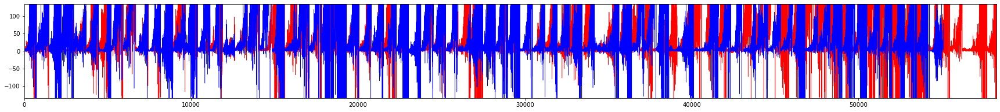

('allworld', 'small_COUNT_CUR_1') size 
 Chain1 length:  61418 Chain2 length:  55092


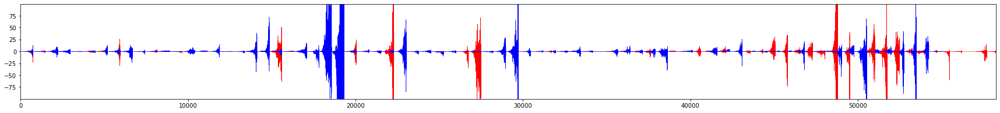

('allworld', 'small_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  61418 Chain2 length:  55092


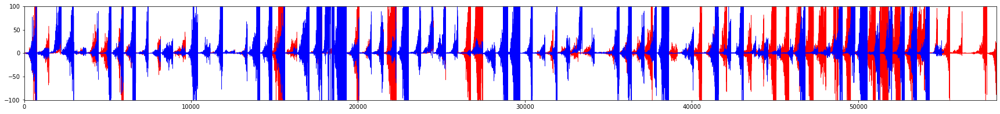

('allworld', 'small_COUNT_CUR_1') Precip 
 Chain1 length:  61418 Chain2 length:  55092


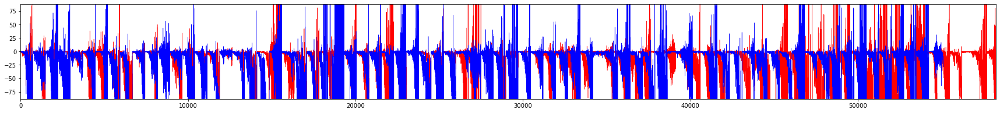

('allworld', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  47239 Chain2 length:  46809


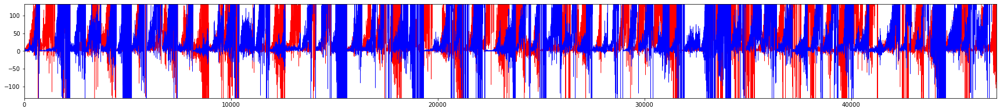

('allworld', 'small_COUNT_CUR_10') size 
 Chain1 length:  47239 Chain2 length:  46809


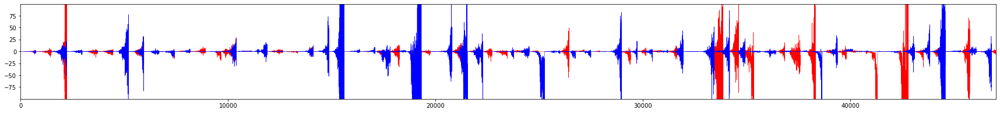

('allworld', 'small_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  47239 Chain2 length:  46809


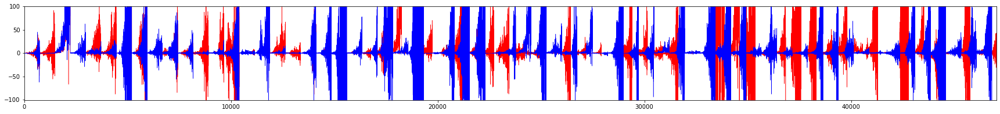

('allworld', 'small_COUNT_CUR_10') Precip 
 Chain1 length:  47239 Chain2 length:  46809


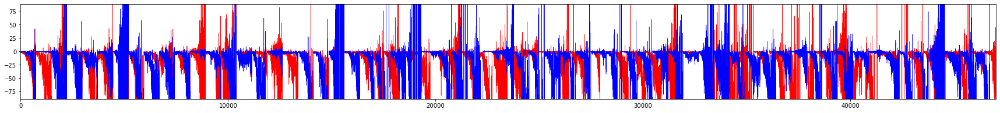

('allworld', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  58006 Chain2 length:  60183


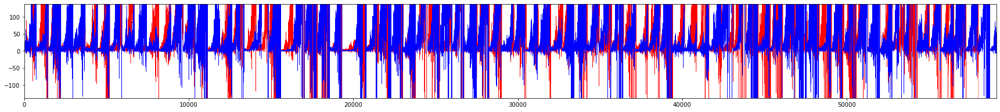

('allworld', 'small_COUNT_CUR_100') size 
 Chain1 length:  58006 Chain2 length:  60183


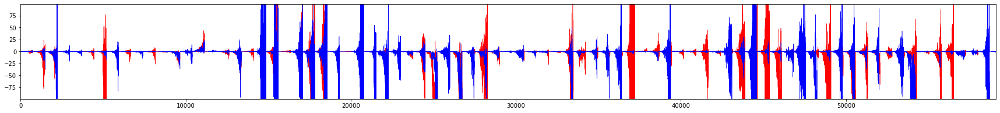

('allworld', 'small_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  58006 Chain2 length:  60183


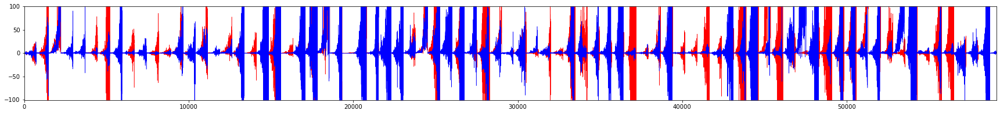

('allworld', 'small_COUNT_CUR_100') Precip 
 Chain1 length:  58006 Chain2 length:  60183


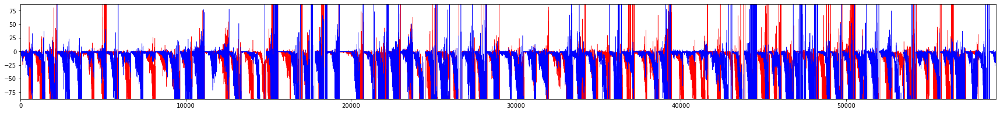

('allworld', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  56870


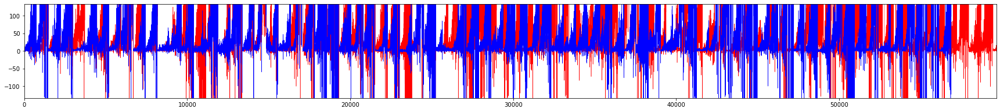

('allworld', 'small_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  56870


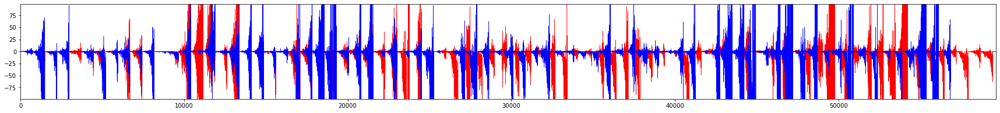

('allworld', 'small_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  56870


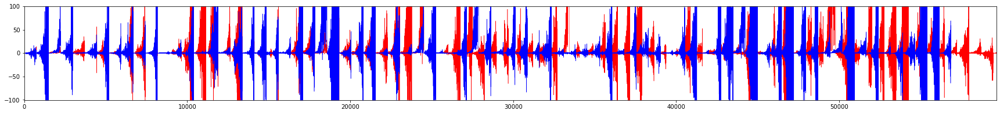

('allworld', 'small_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  56870


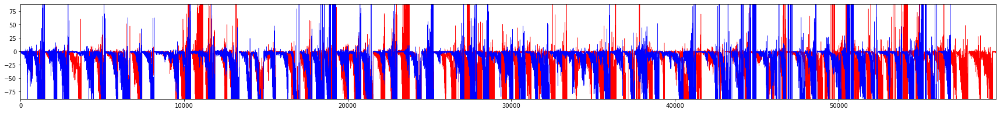

('allworld', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  45416 Chain2 length:  60183


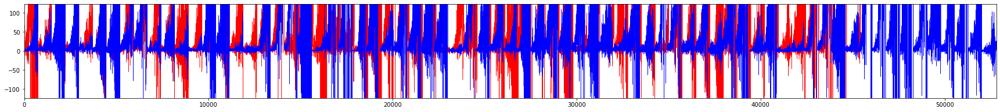

('allworld', 'small_COUNT_NAT_1') size 
 Chain1 length:  45416 Chain2 length:  60183


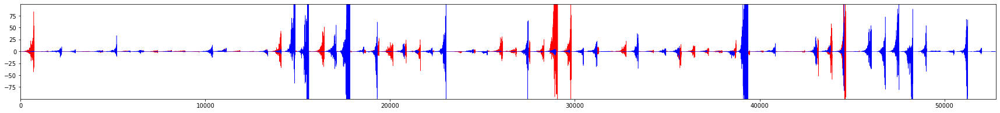

('allworld', 'small_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  45416 Chain2 length:  60183


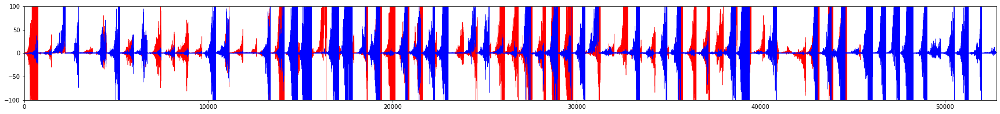

('allworld', 'small_COUNT_NAT_1') Precip 
 Chain1 length:  45416 Chain2 length:  60183


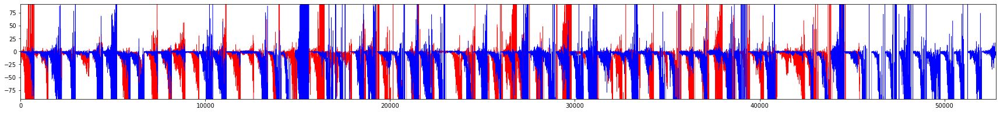

('allworld', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  61669 Chain2 length:  60183


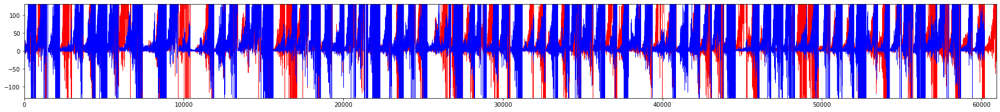

('allworld', 'small_COUNT_NAT_10') size 
 Chain1 length:  61669 Chain2 length:  60183


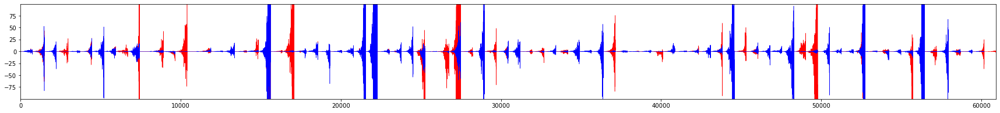

('allworld', 'small_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  61669 Chain2 length:  60183


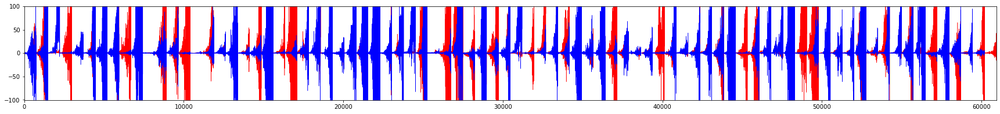

('allworld', 'small_COUNT_NAT_10') Precip 
 Chain1 length:  61669 Chain2 length:  60183


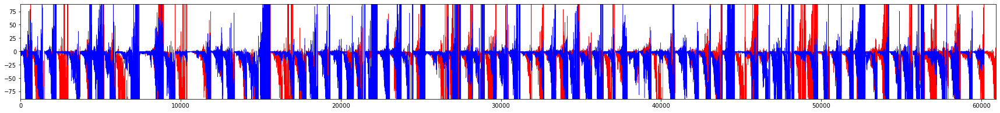

('allworld', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  61669 Chain2 length:  60183


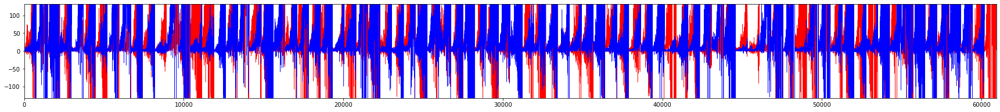

('allworld', 'small_COUNT_NAT_100') size 
 Chain1 length:  61669 Chain2 length:  60183


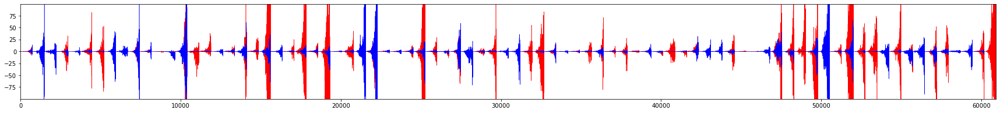

('allworld', 'small_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  61669 Chain2 length:  60183


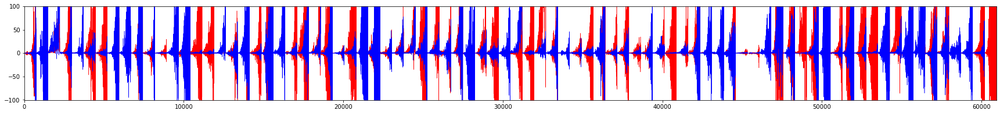

('allworld', 'small_COUNT_NAT_100') Precip 
 Chain1 length:  61669 Chain2 length:  60183


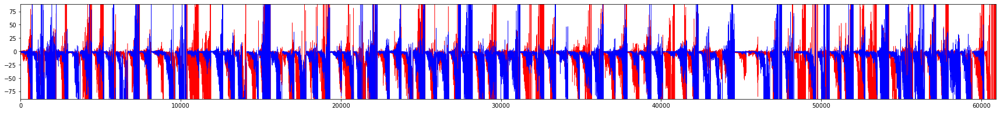

('allworld', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  61669 Chain2 length:  61669


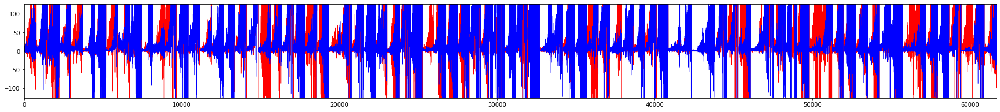

('allworld', 'small_COUNT_NAT_1000') size 
 Chain1 length:  61669 Chain2 length:  61669


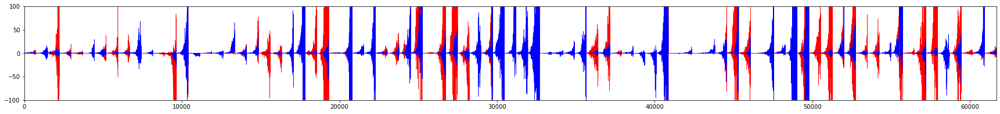

('allworld', 'small_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  61669 Chain2 length:  61669


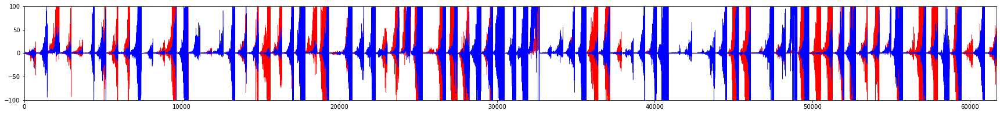

('allworld', 'small_COUNT_NAT_1000') Precip 
 Chain1 length:  61669 Chain2 length:  61669


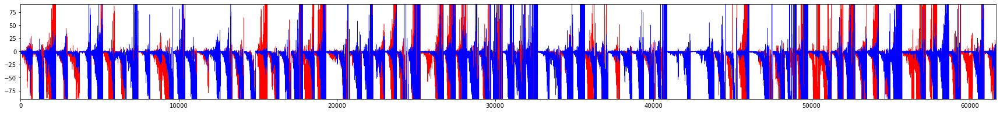

('allworld', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


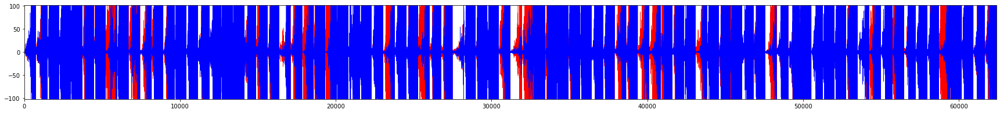

('allworld', 'large_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


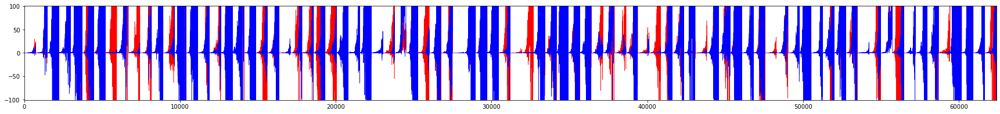

('allworld', 'large_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


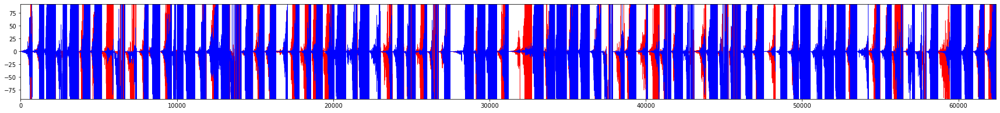

('allworld', 'large_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


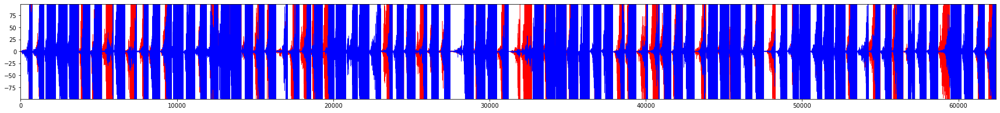

('allworld', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


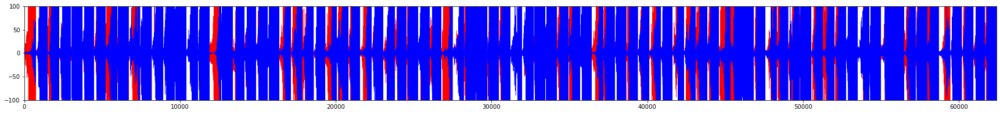

('allworld', 'large_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


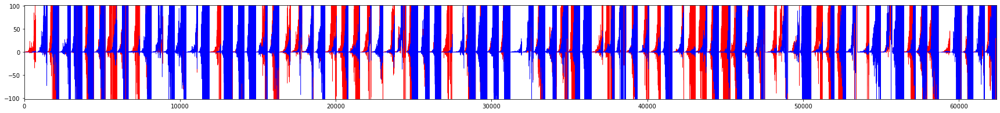

('allworld', 'large_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


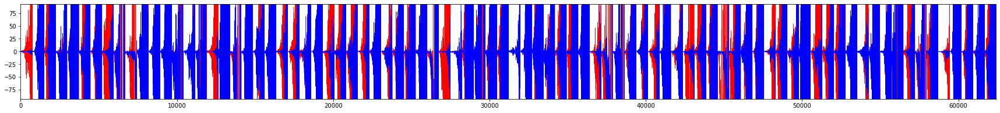

('allworld', 'large_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


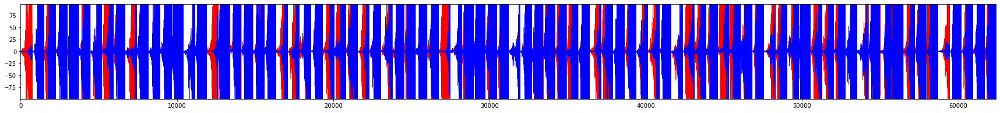

('allworld', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


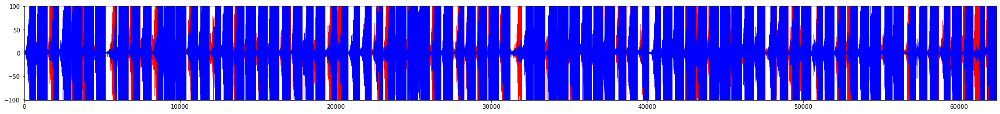

('allworld', 'large_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


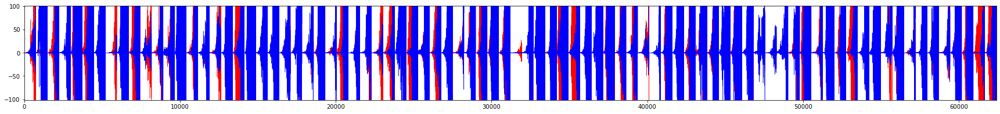

('allworld', 'large_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


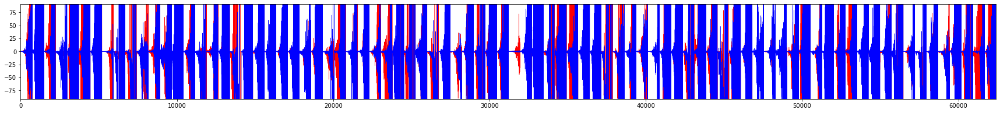

('allworld', 'large_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


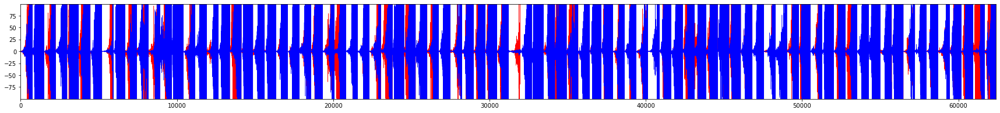

('allworld', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


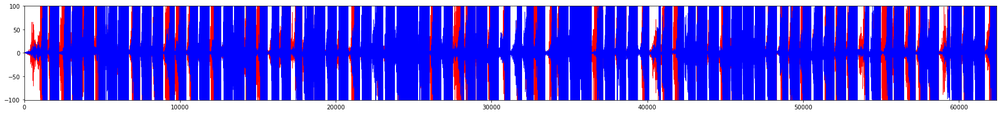

('allworld', 'large_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


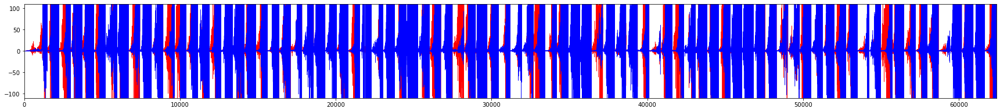

('allworld', 'large_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


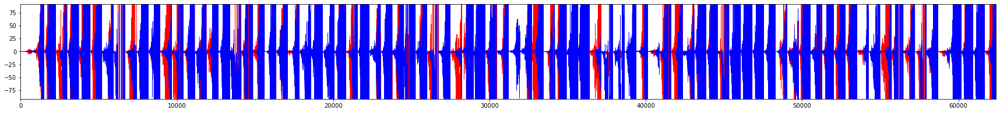

('allworld', 'large_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


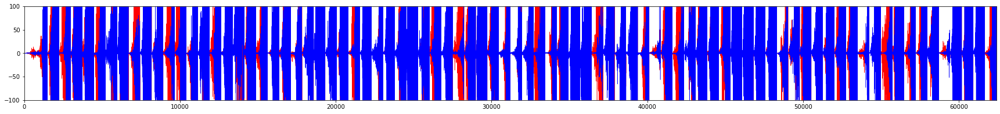

('allworld', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


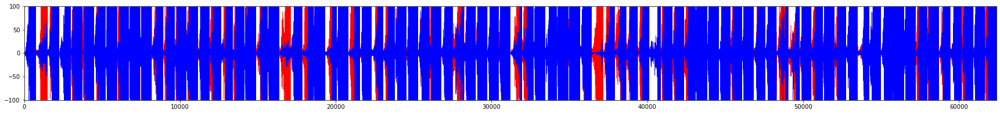

('allworld', 'large_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


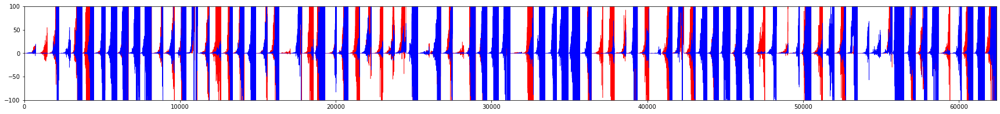

('allworld', 'large_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


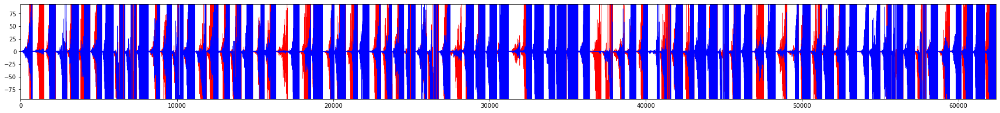

('allworld', 'large_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


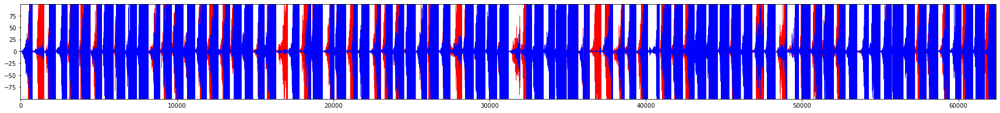

('allworld', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


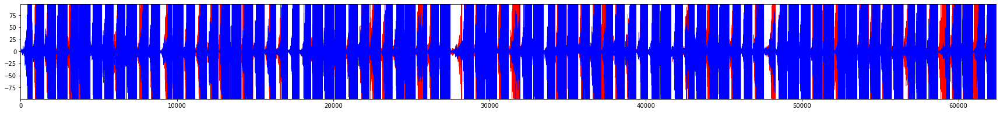

('allworld', 'large_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


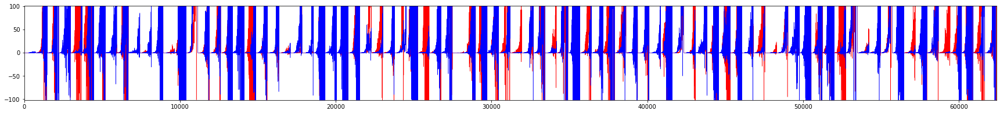

('allworld', 'large_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


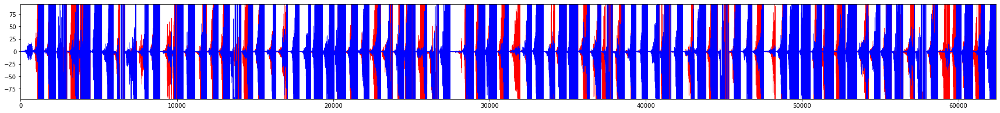

('allworld', 'large_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


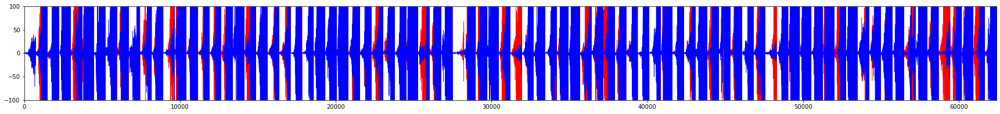

('allworld', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


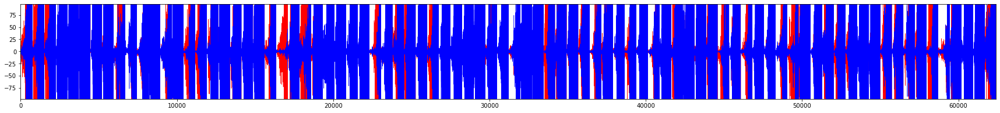

('allworld', 'large_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


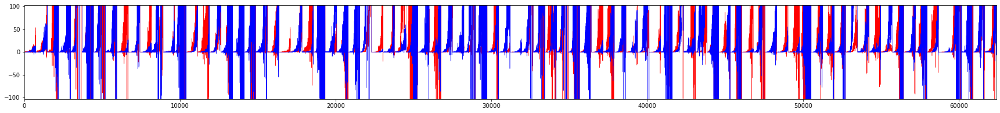

('allworld', 'large_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


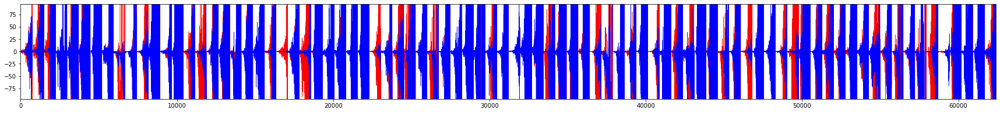

('allworld', 'large_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


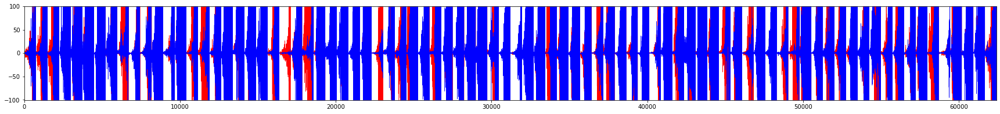

('allworld', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


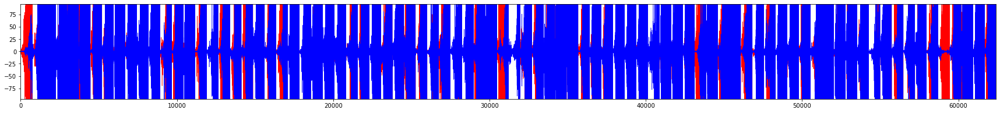

('allworld', 'large_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


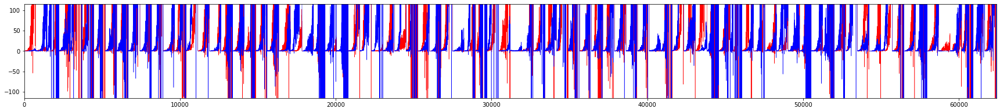

('allworld', 'large_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


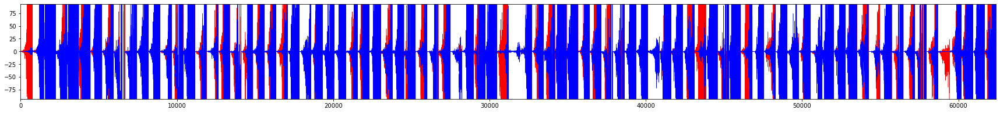

('allworld', 'large_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


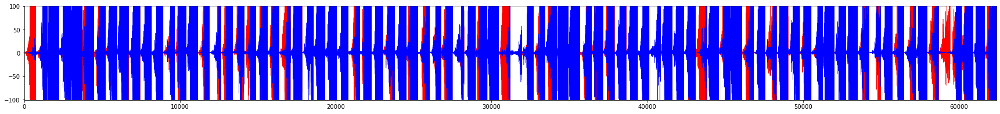

('NW', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


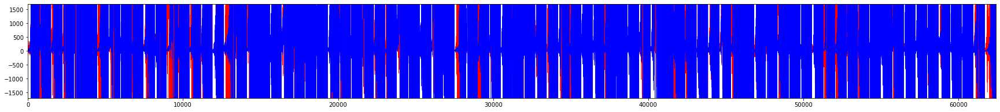

('NW', 'small_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


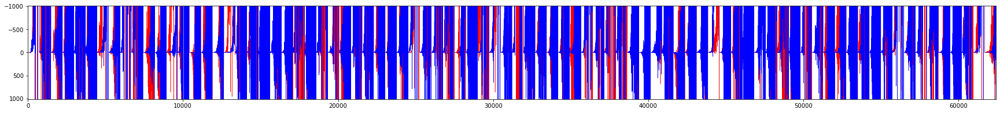

('NW', 'small_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


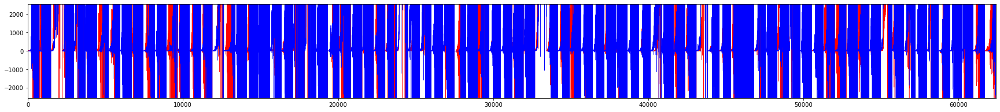

('NW', 'small_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


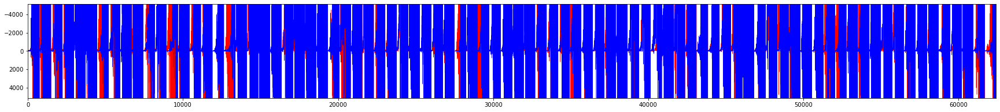

('NW', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


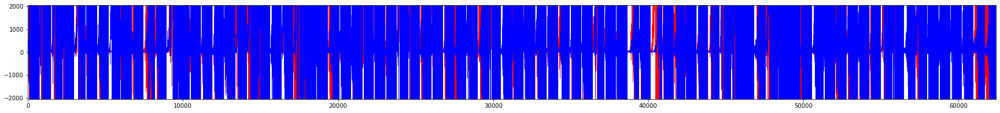

('NW', 'small_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


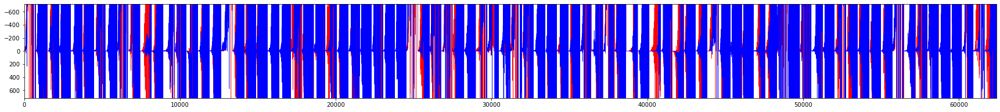

('NW', 'small_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


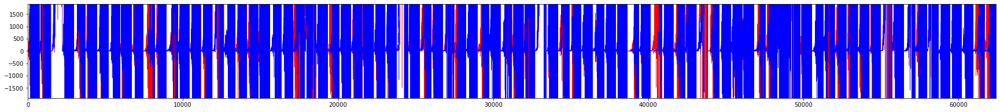

('NW', 'small_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


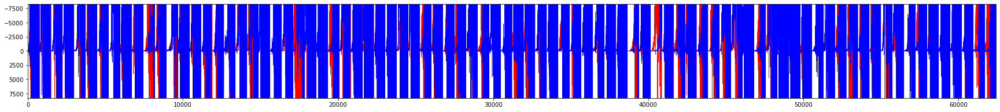

('NW', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


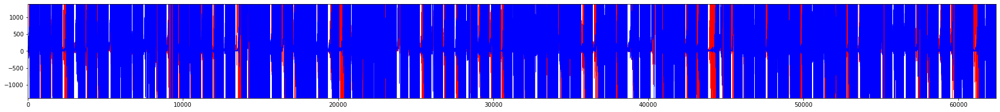

('NW', 'small_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


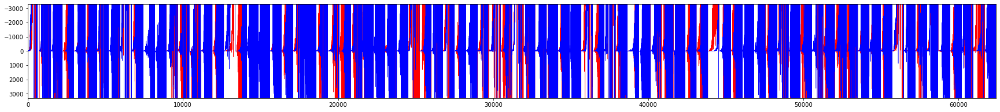

('NW', 'small_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


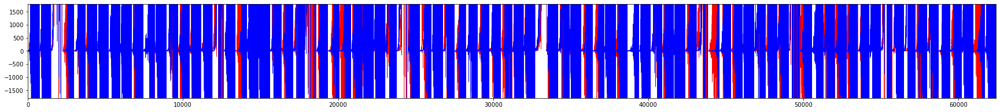

('NW', 'small_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


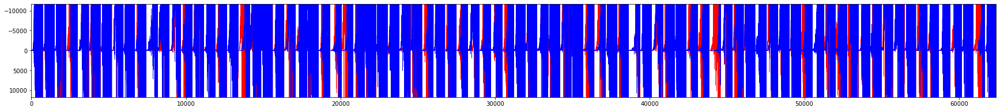

('NW', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


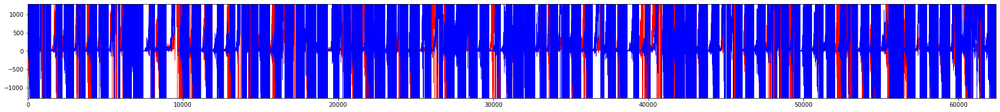

('NW', 'small_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


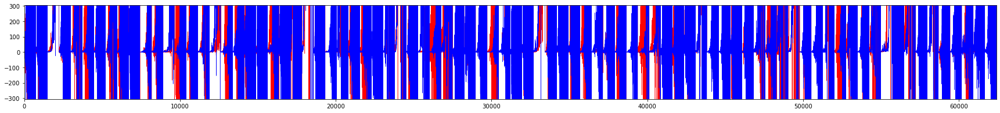

('NW', 'small_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


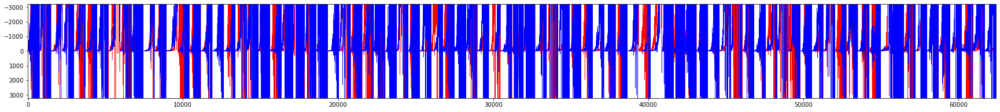

('NW', 'small_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


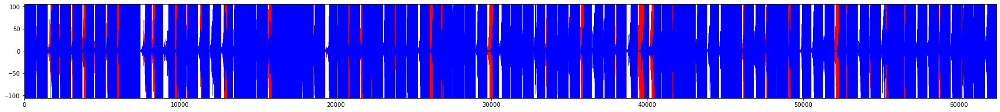

('NW', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


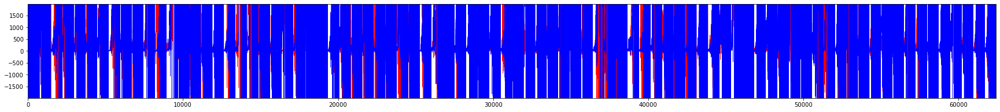

('NW', 'small_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


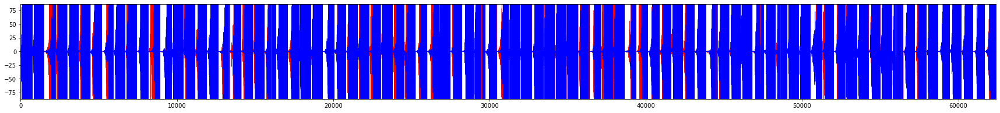

('NW', 'small_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


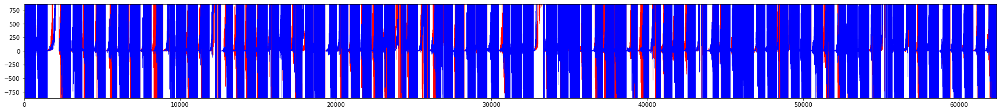

('NW', 'small_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


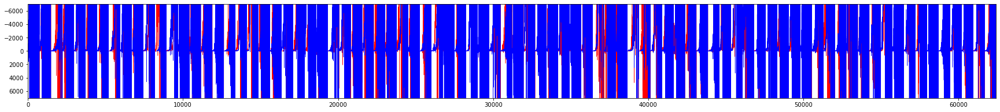

('NW', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


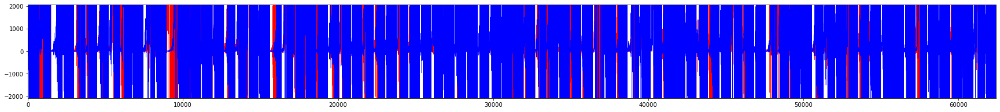

('NW', 'small_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


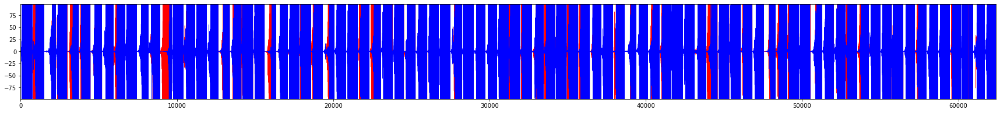

('NW', 'small_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


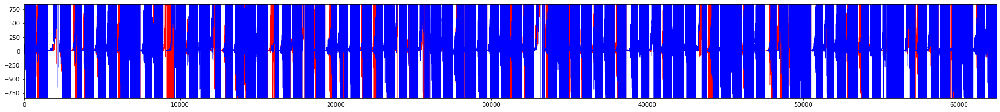

('NW', 'small_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


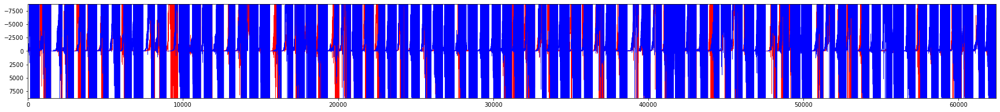

('NW', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


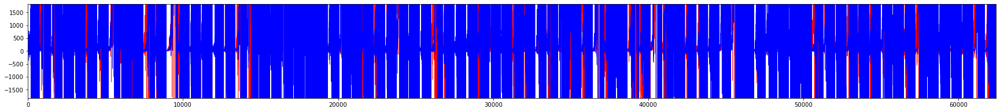

('NW', 'small_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


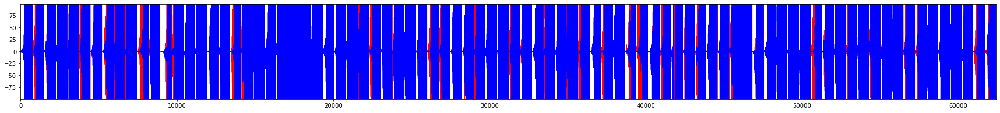

('NW', 'small_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


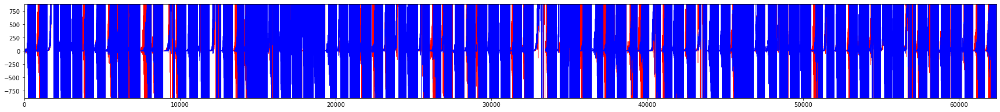

('NW', 'small_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


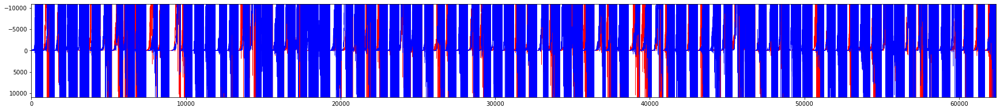

('NW', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


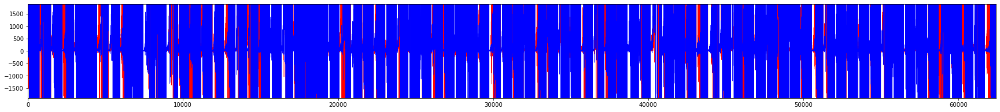

('NW', 'small_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


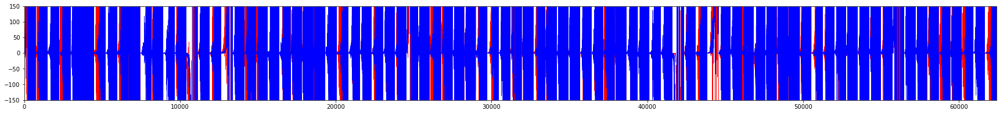

('NW', 'small_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


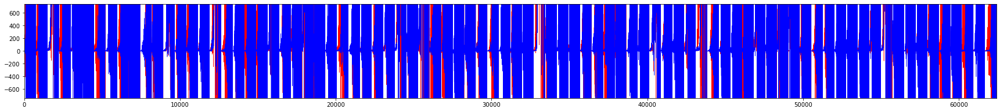

('NW', 'small_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


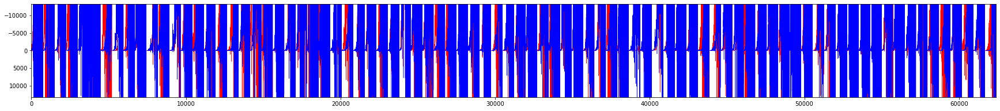

('NW', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


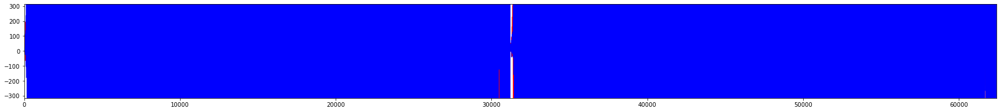

('NW', 'large_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


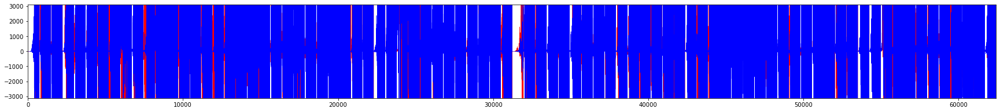

('NW', 'large_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


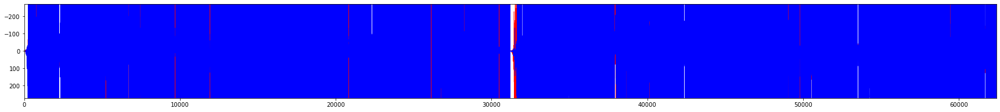

('NW', 'large_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


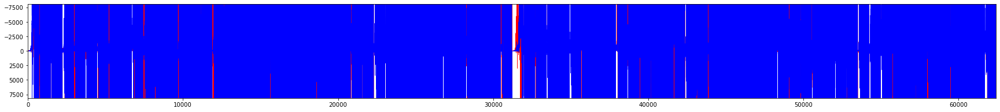

('NW', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


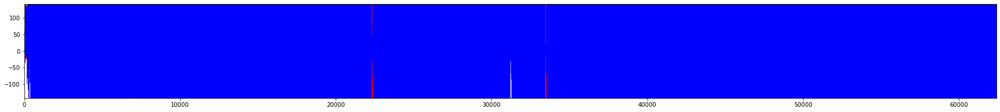

('NW', 'large_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


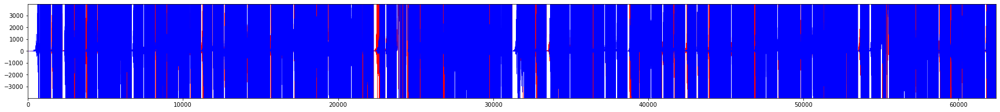

('NW', 'large_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


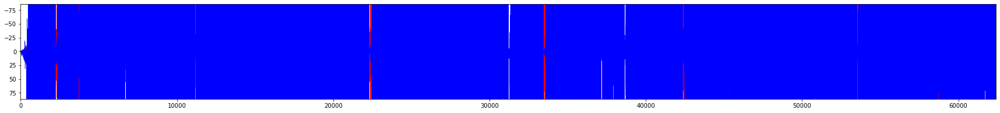

('NW', 'large_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


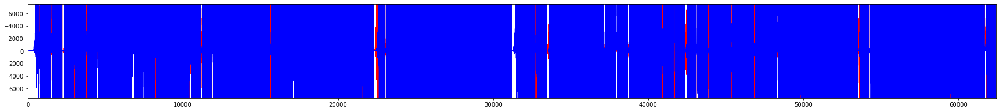

('NW', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


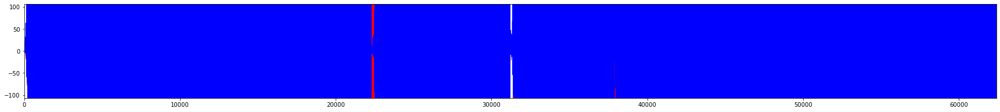

('NW', 'large_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


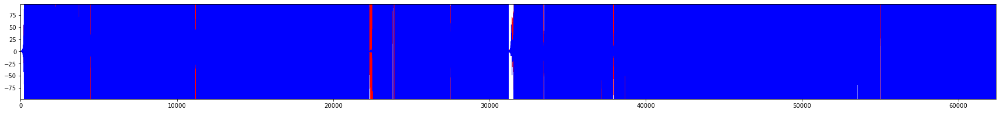

('NW', 'large_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


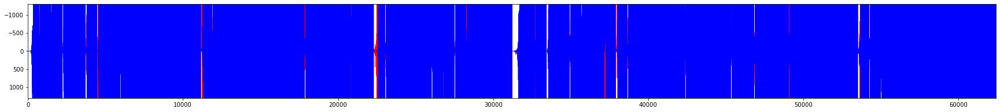

('NW', 'large_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


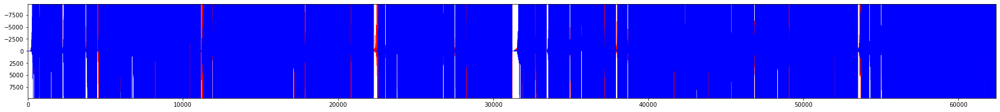

('NW', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


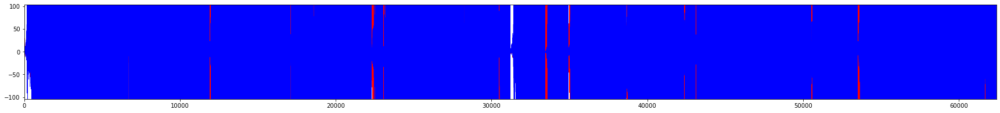

('NW', 'large_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


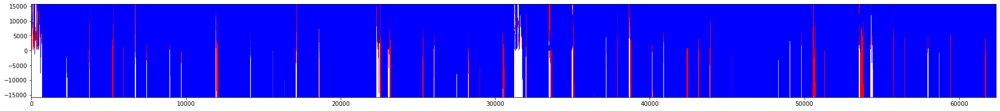

('NW', 'large_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


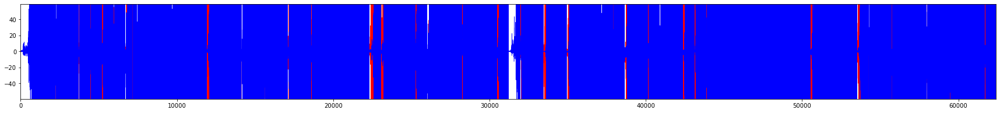

('NW', 'large_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


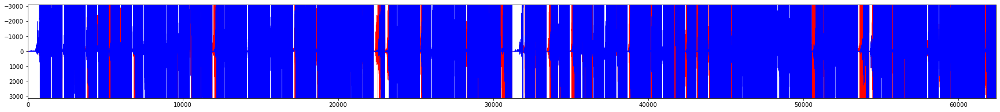

('NW', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


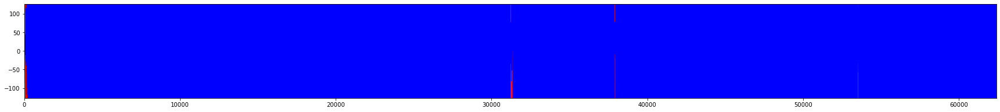

('NW', 'large_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


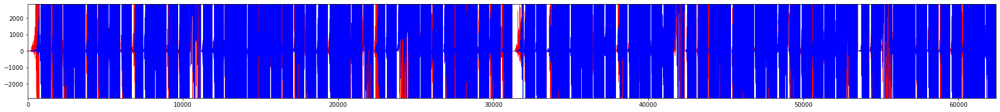

('NW', 'large_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


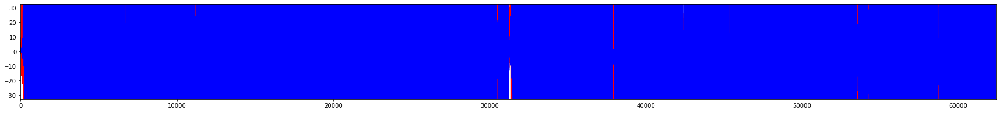

('NW', 'large_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


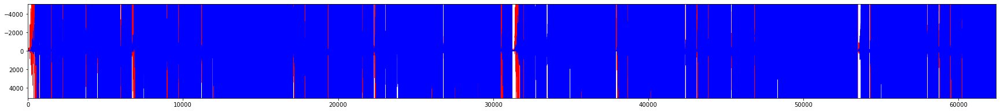

('NW', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


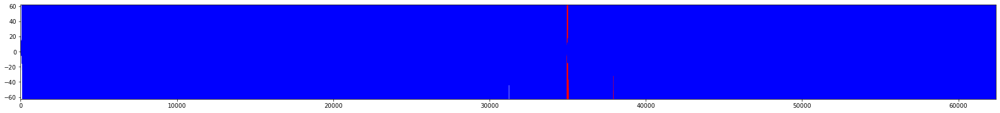

('NW', 'large_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


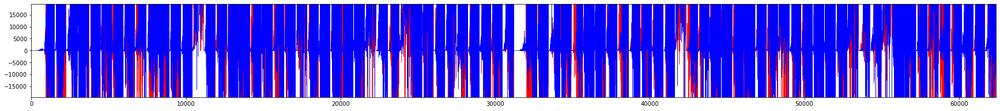

('NW', 'large_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


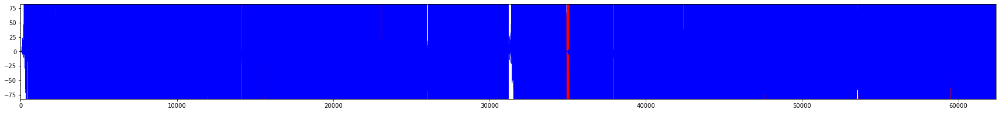

('NW', 'large_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


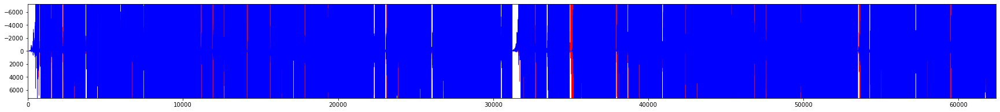

('NW', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


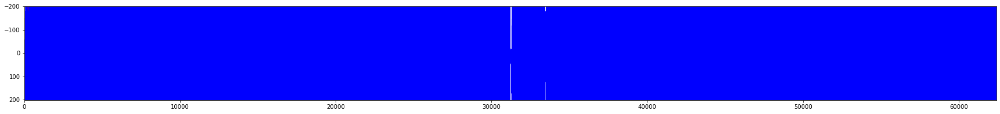

('NW', 'large_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


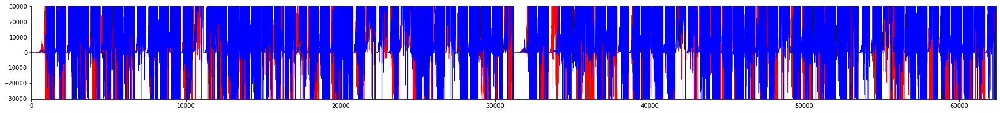

('NW', 'large_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


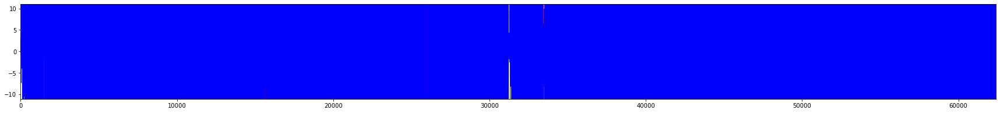

('NW', 'large_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


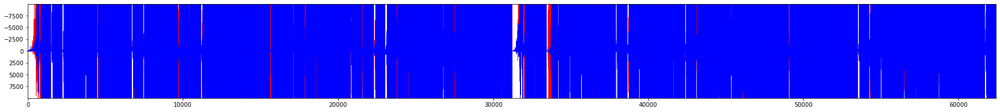

('NW', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


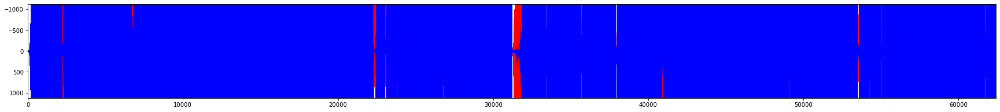

('NW', 'large_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


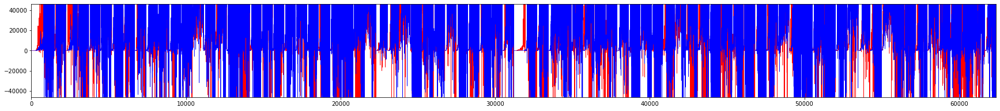

('NW', 'large_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


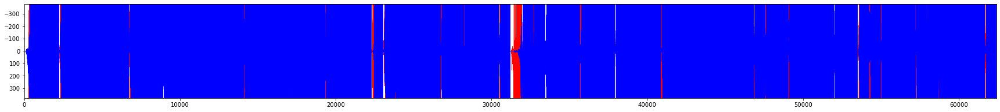

('NW', 'large_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


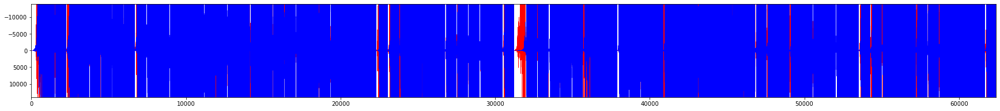

('OW', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


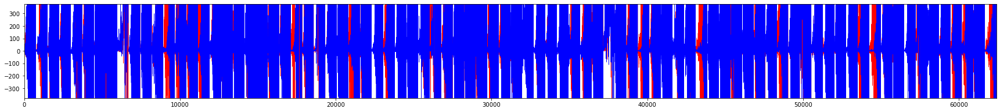

('OW', 'small_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


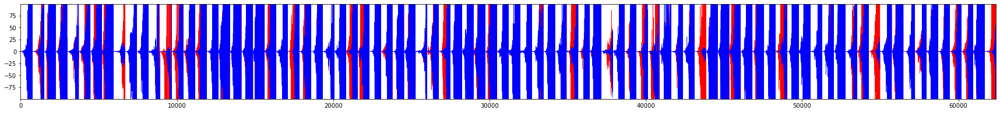

('OW', 'small_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


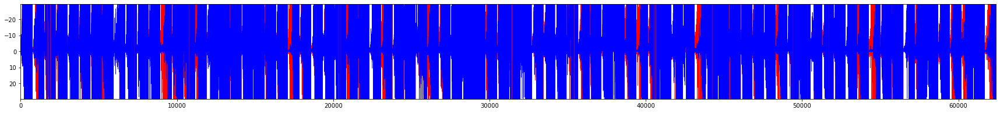

('OW', 'small_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


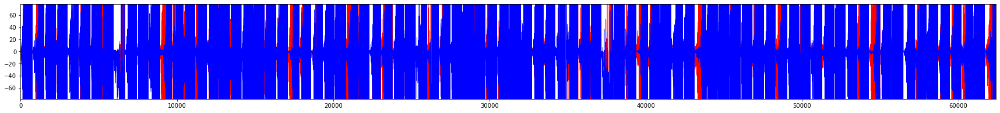

('OW', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


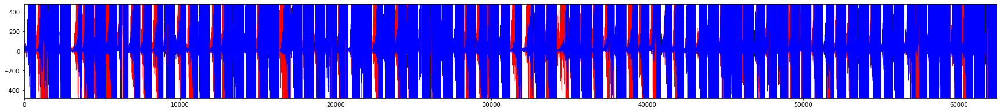

('OW', 'small_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


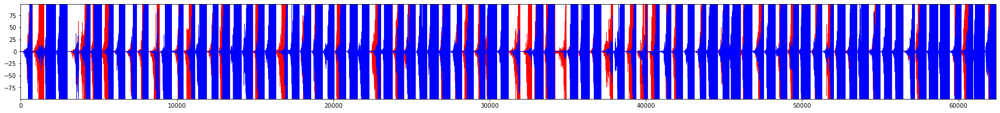

('OW', 'small_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


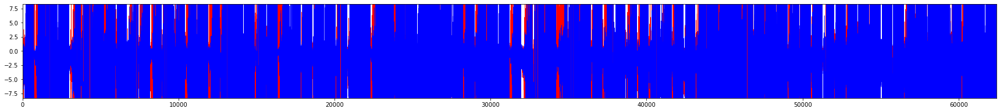

('OW', 'small_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


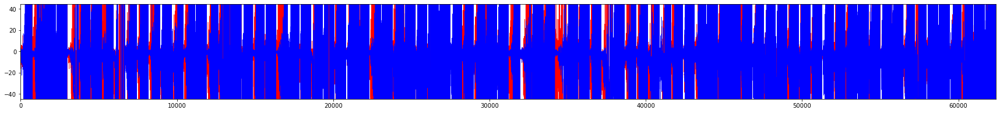

('OW', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


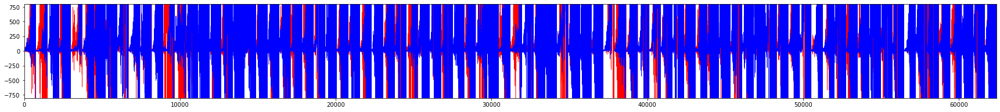

('OW', 'small_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


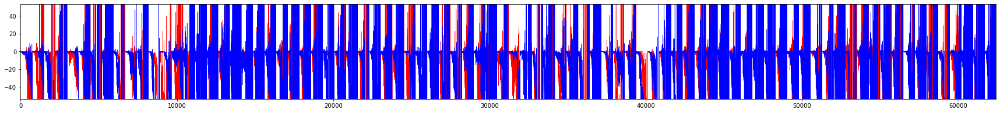

('OW', 'small_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


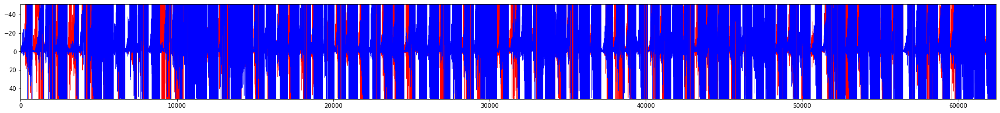

('OW', 'small_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


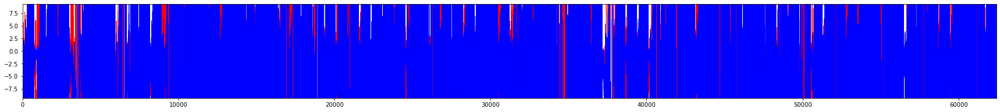

('OW', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


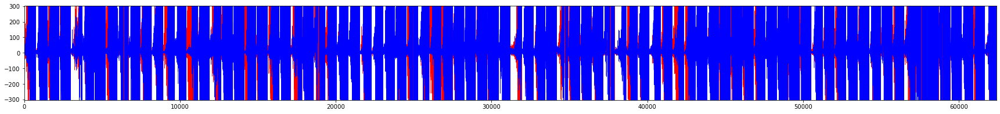

('OW', 'small_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


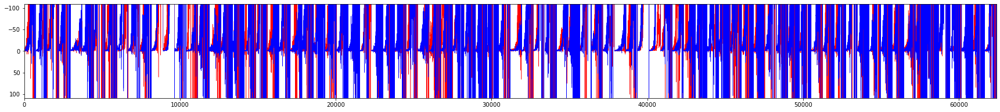

('OW', 'small_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


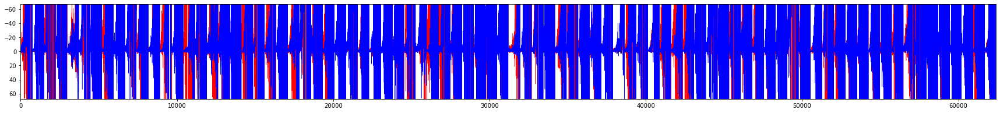

('OW', 'small_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


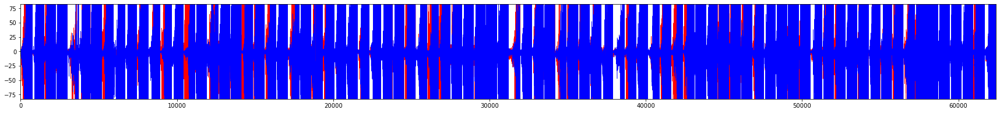

('OW', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


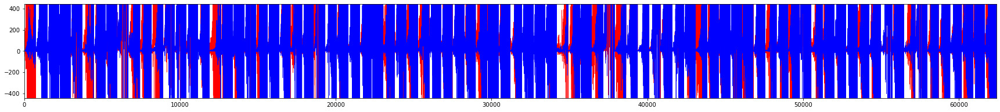

('OW', 'small_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


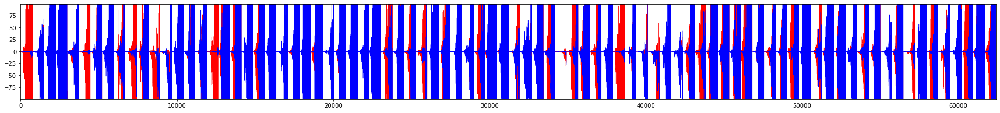

('OW', 'small_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


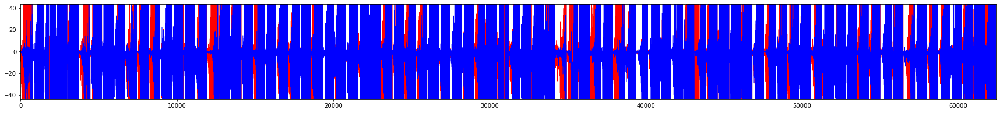

('OW', 'small_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


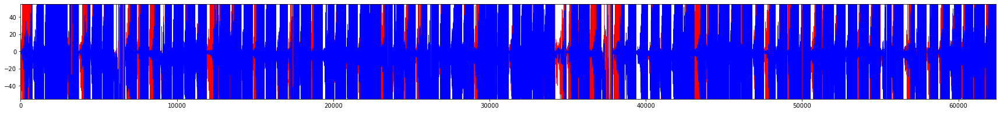

('OW', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


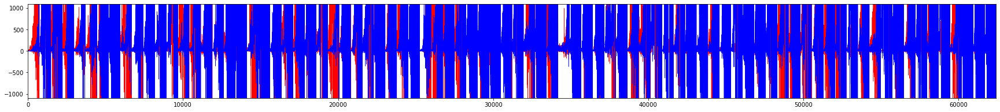

('OW', 'small_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


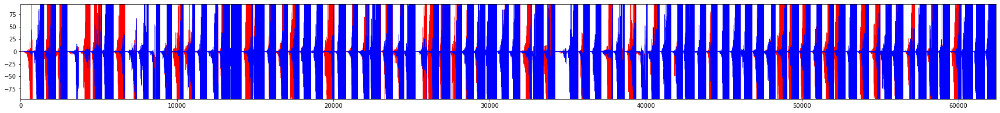

('OW', 'small_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


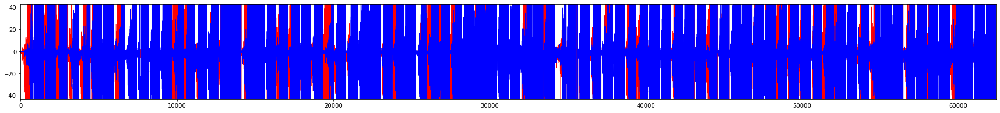

('OW', 'small_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


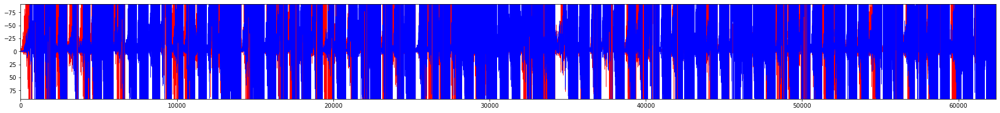

('OW', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


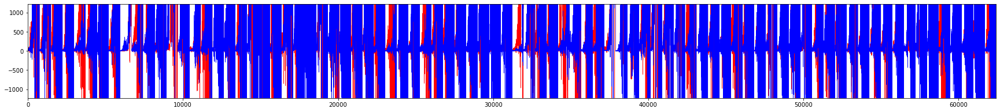

('OW', 'small_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


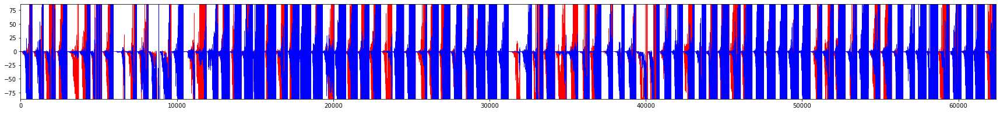

('OW', 'small_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


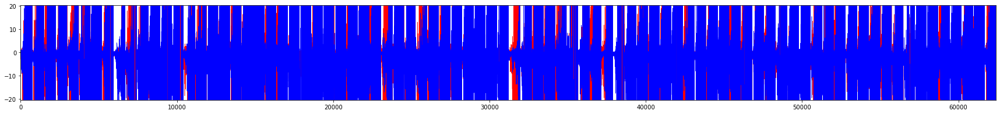

('OW', 'small_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


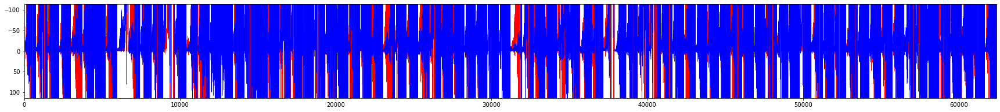

('OW', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


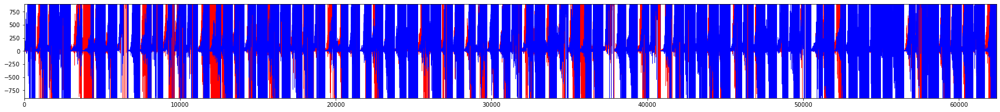

('OW', 'small_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


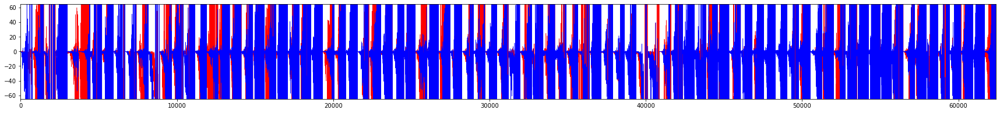

('OW', 'small_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


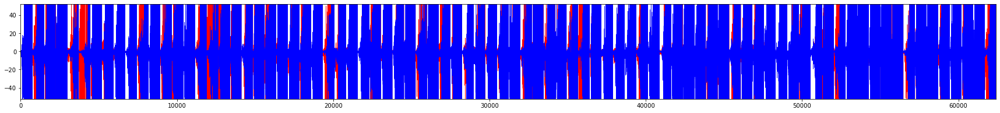

('OW', 'small_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


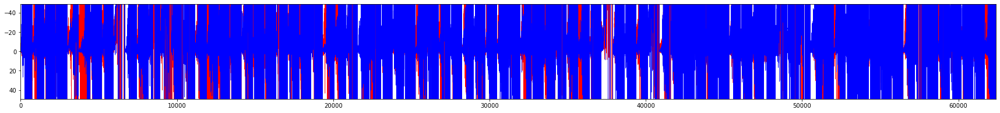

('OW', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


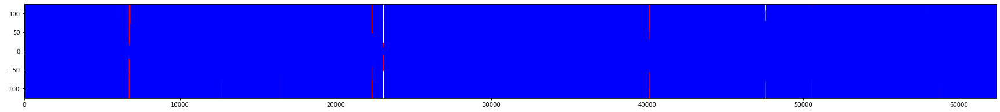

('OW', 'large_COUNT_CUR_1') size 
 Chain1 length:  62412 Chain2 length:  62412


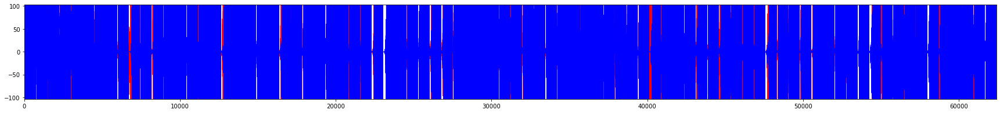

('OW', 'large_COUNT_CUR_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


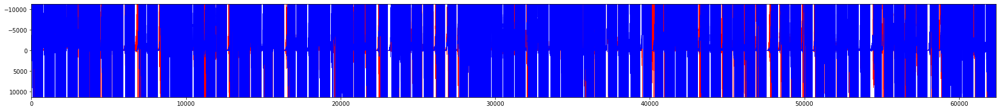

('OW', 'large_COUNT_CUR_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


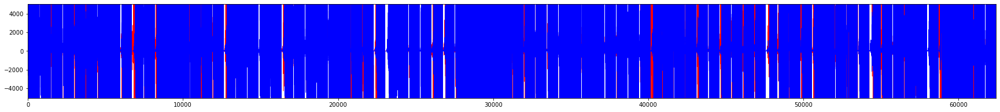

('OW', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


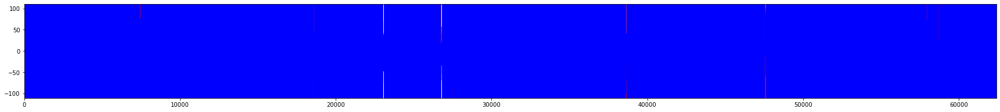

('OW', 'large_COUNT_CUR_10') size 
 Chain1 length:  62412 Chain2 length:  62412


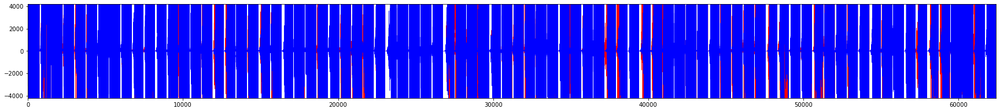

('OW', 'large_COUNT_CUR_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


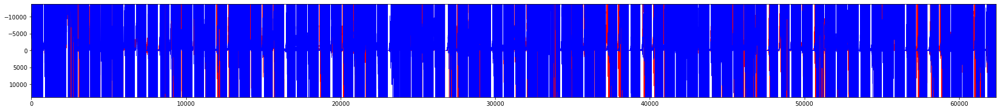

('OW', 'large_COUNT_CUR_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


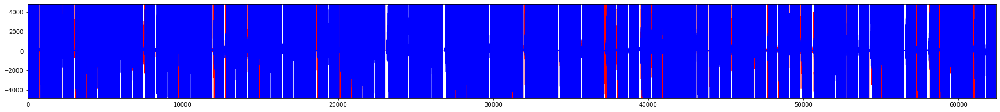

('OW', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


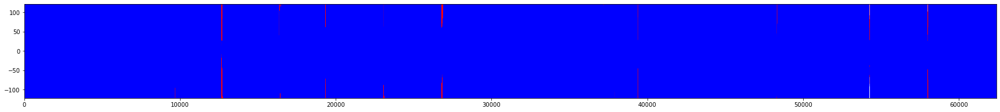

('OW', 'large_COUNT_CUR_100') size 
 Chain1 length:  62412 Chain2 length:  62412


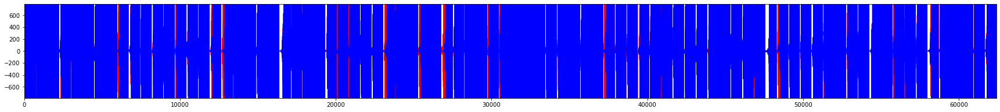

('OW', 'large_COUNT_CUR_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


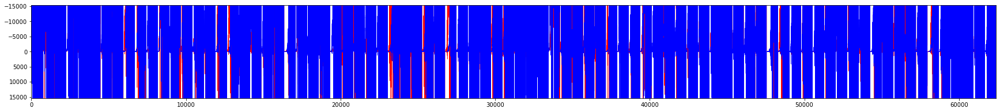

('OW', 'large_COUNT_CUR_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


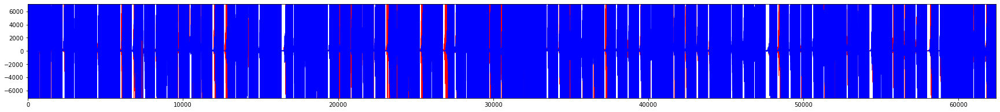

('OW', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


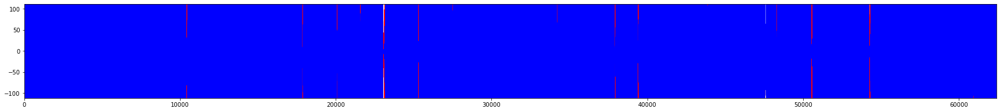

('OW', 'large_COUNT_CUR_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


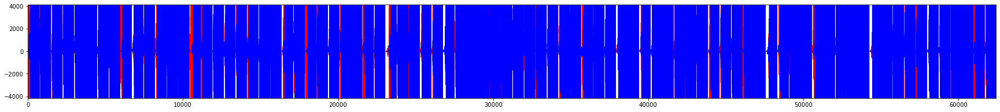

('OW', 'large_COUNT_CUR_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


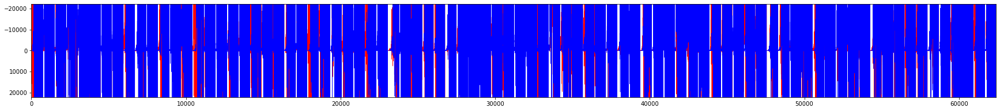

('OW', 'large_COUNT_CUR_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


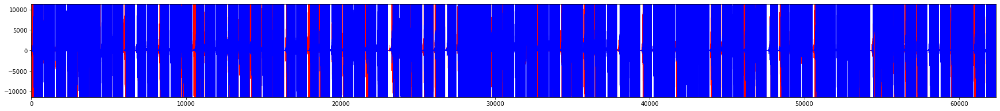

('OW', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  62412 Chain2 length:  62412


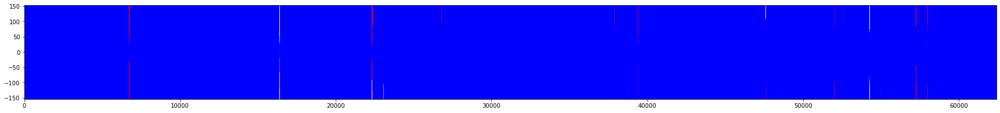

('OW', 'large_COUNT_NAT_1') size 
 Chain1 length:  62412 Chain2 length:  62412


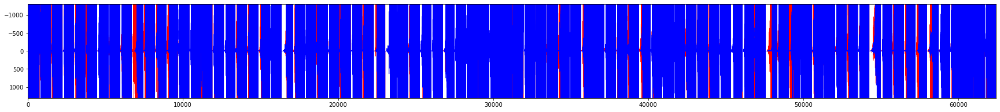

('OW', 'large_COUNT_NAT_1') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


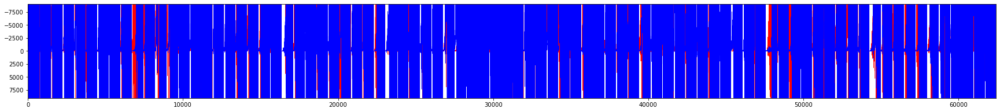

('OW', 'large_COUNT_NAT_1') Precip 
 Chain1 length:  62412 Chain2 length:  62412


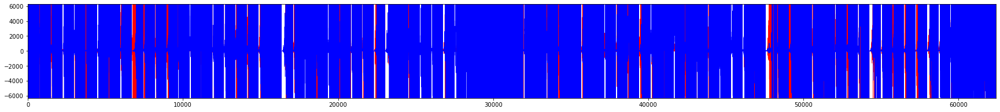

('OW', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  62412 Chain2 length:  62412


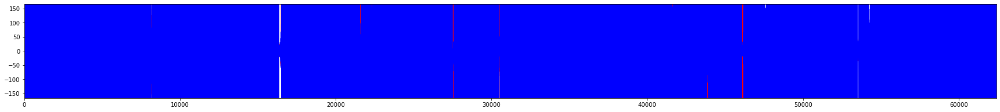

('OW', 'large_COUNT_NAT_10') size 
 Chain1 length:  62412 Chain2 length:  62412


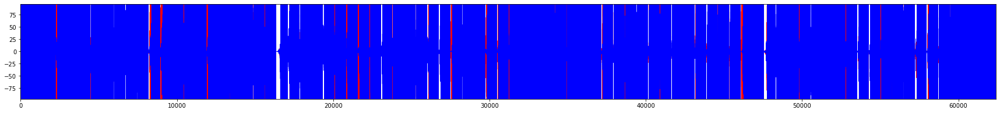

('OW', 'large_COUNT_NAT_10') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


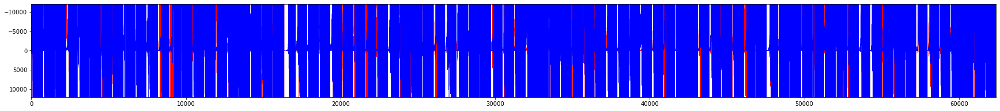

('OW', 'large_COUNT_NAT_10') Precip 
 Chain1 length:  62412 Chain2 length:  62412


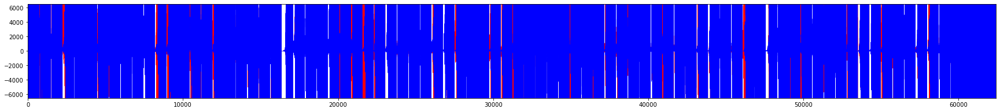

('OW', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  62412 Chain2 length:  62412


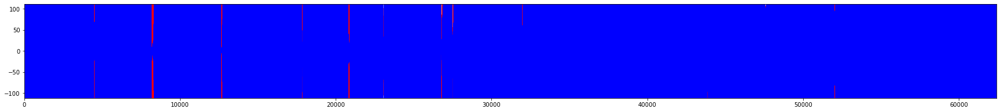

('OW', 'large_COUNT_NAT_100') size 
 Chain1 length:  62412 Chain2 length:  62412


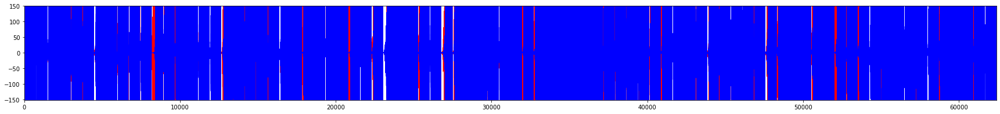

('OW', 'large_COUNT_NAT_100') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


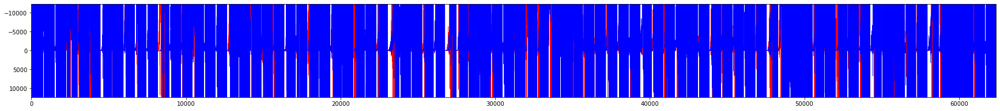

('OW', 'large_COUNT_NAT_100') Precip 
 Chain1 length:  62412 Chain2 length:  62412


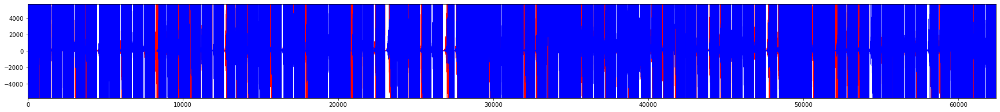

('OW', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  62412 Chain2 length:  62412


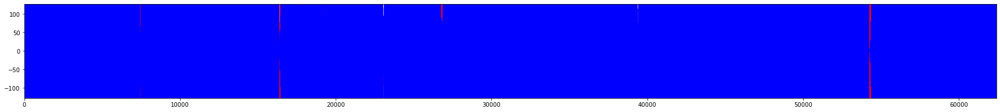

('OW', 'large_COUNT_NAT_1000') size 
 Chain1 length:  62412 Chain2 length:  62412


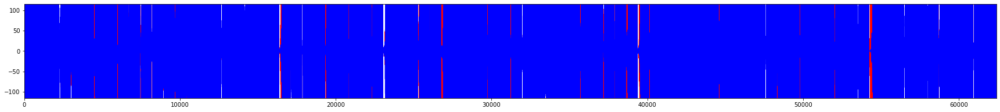

('OW', 'large_COUNT_NAT_1000') Biome_bin1 
 Chain1 length:  62412 Chain2 length:  62412


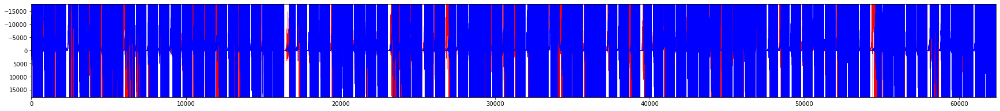

('OW', 'large_COUNT_NAT_1000') Precip 
 Chain1 length:  62412 Chain2 length:  62412


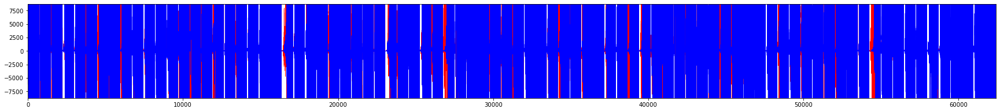

In [23]:
geos_uniq=list(alldata['geog'].unique())
size_uniq=list(alldata['sizetype'].unique())

dataset=alldata[alldata['climate']=='climate']

models=list(product(geos_uniq,size_uniq))
for model in models:
#     print(model)
    temp1=dataset[(dataset['geog']==model[0]) & (dataset['sizetype']==model[1]) & (dataset['round']=='round1')]
    temp2=dataset[(dataset['geog']==model[0]) & (dataset['sizetype']==model[1]) & (dataset['round']=='round2')]
    for col in ['intercept','size','Biome_bin1','Precip']:
        print(model,col,'\n','Chain1 length: ',len(temp1), 'Chain2 length: ',len(temp2))
        fig,ax=plt.subplots(figsize=(30,3),facecolor='w')
        ax.plot([x for x in range(len(temp1[col]))],temp1[col],c='r',lw=0.5)
        ax.plot([x for x in range(len(temp2[col]))],temp2[col],c='b',lw=0.5)
        plt.ylim(-temp2[col].median()-100,temp2[col].median()+100)
        plt.xlim(0,(len(temp1)+len(temp2))/2)
        plt.show()
        time.sleep(0.1)


('allworld', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


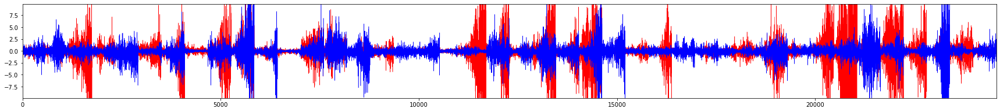

('allworld', 'small_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


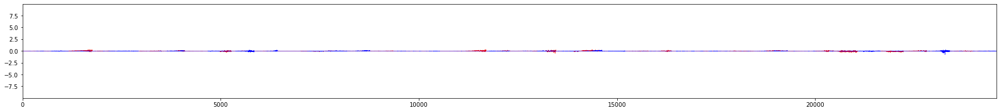

('allworld', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


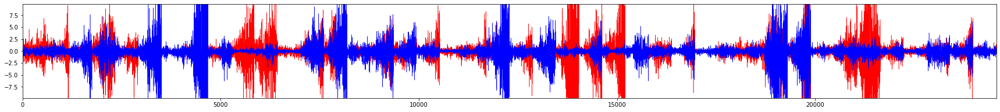

('allworld', 'small_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


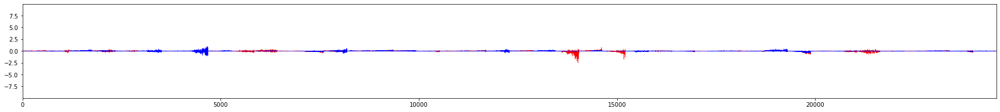

('allworld', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


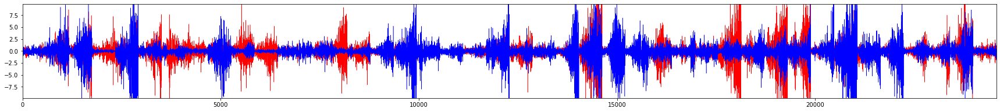

('allworld', 'small_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


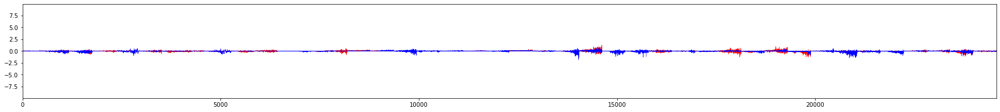

('allworld', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


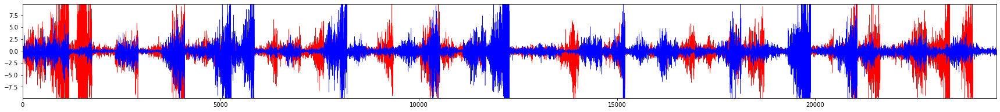

('allworld', 'small_COUNT_CUR_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


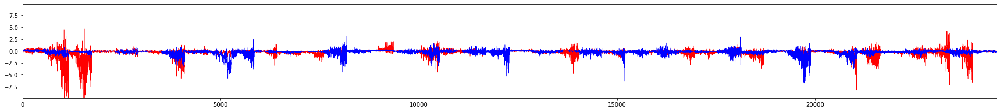

('allworld', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


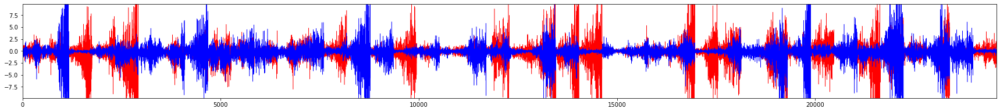

('allworld', 'small_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


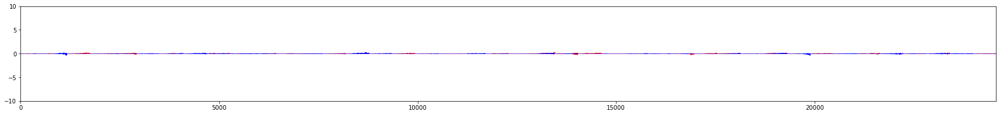

('allworld', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


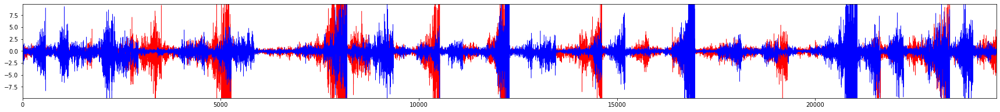

('allworld', 'small_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


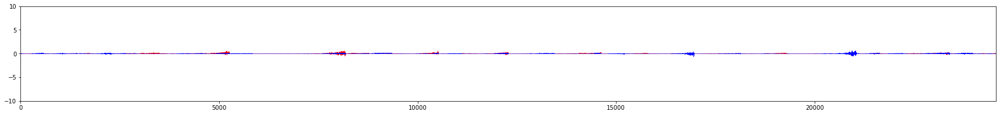

('allworld', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


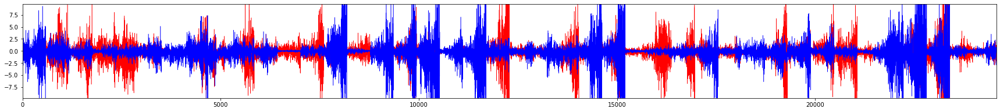

('allworld', 'small_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


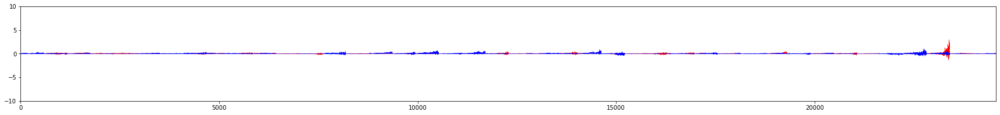

('allworld', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


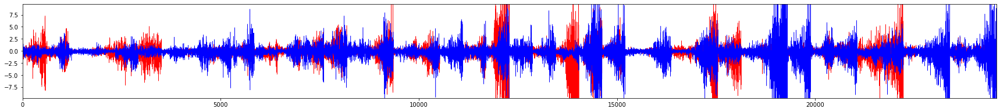

('allworld', 'small_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


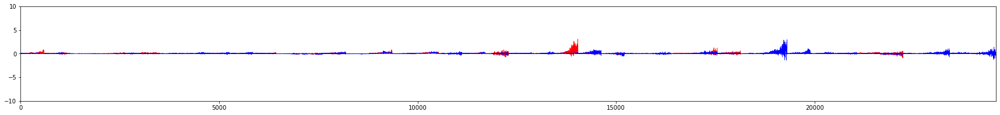

('allworld', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  47250 Chain2 length:  47250


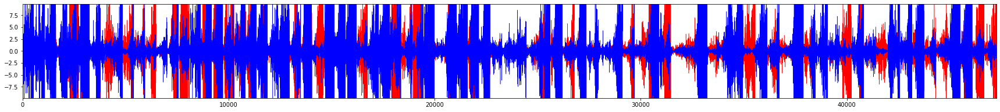

('allworld', 'large_COUNT_CUR_1') size 
 Chain1 length:  47250 Chain2 length:  47250


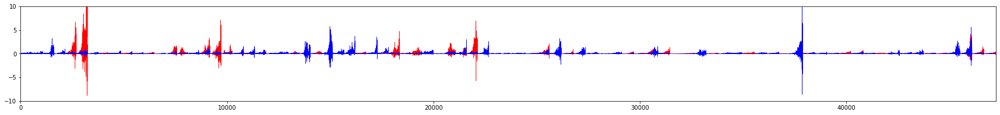

('allworld', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  47250 Chain2 length:  47250


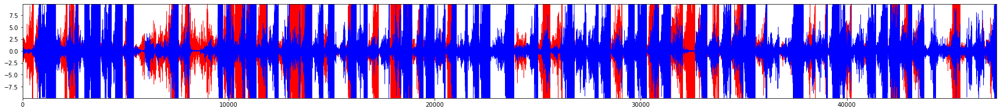

('allworld', 'large_COUNT_CUR_10') size 
 Chain1 length:  47250 Chain2 length:  47250


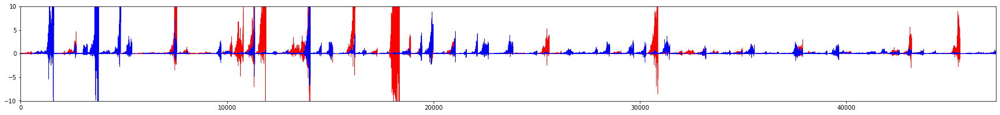

('allworld', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  47250 Chain2 length:  47250


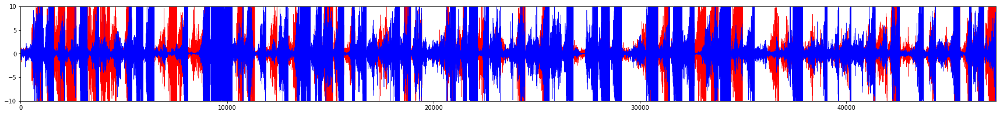

('allworld', 'large_COUNT_CUR_100') size 
 Chain1 length:  47250 Chain2 length:  47250


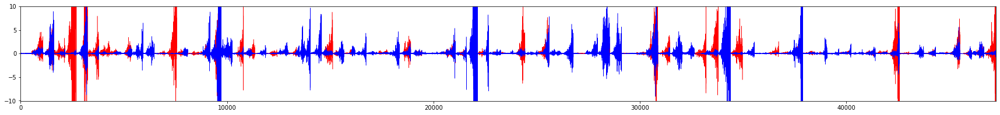

('allworld', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  47250 Chain2 length:  47250


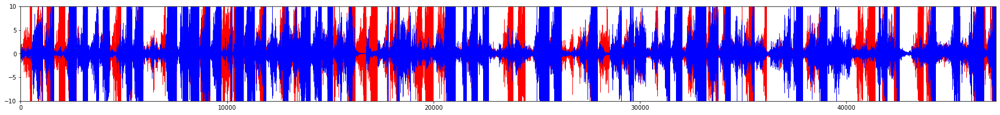

('allworld', 'large_COUNT_CUR_1000') size 
 Chain1 length:  47250 Chain2 length:  47250


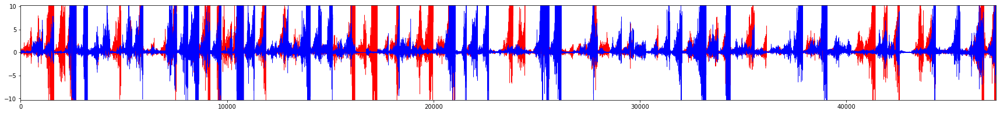

('allworld', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  47250 Chain2 length:  47250


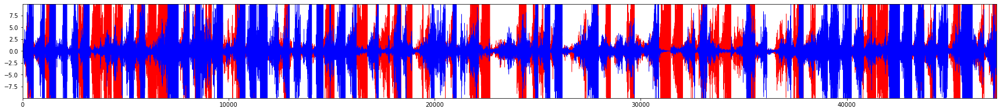

('allworld', 'large_COUNT_NAT_1') size 
 Chain1 length:  47250 Chain2 length:  47250


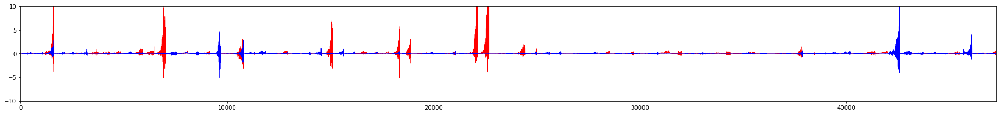

('allworld', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  47250 Chain2 length:  47250


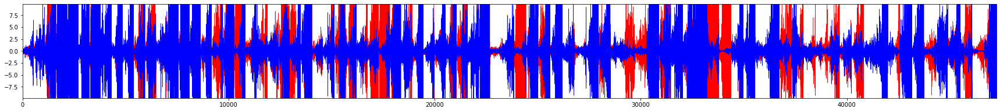

('allworld', 'large_COUNT_NAT_10') size 
 Chain1 length:  47250 Chain2 length:  47250


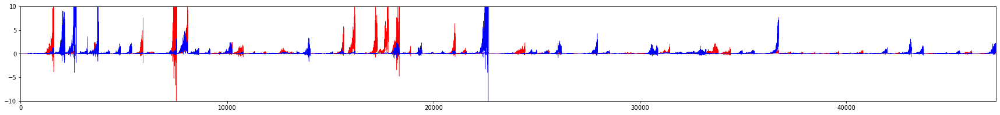

('allworld', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  47250 Chain2 length:  47250


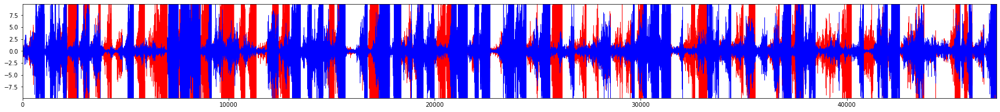

('allworld', 'large_COUNT_NAT_100') size 
 Chain1 length:  47250 Chain2 length:  47250


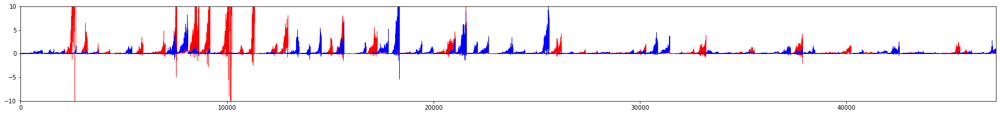

('allworld', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  47250 Chain2 length:  47250


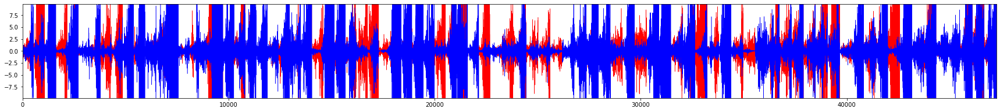

('allworld', 'large_COUNT_NAT_1000') size 
 Chain1 length:  47250 Chain2 length:  47250


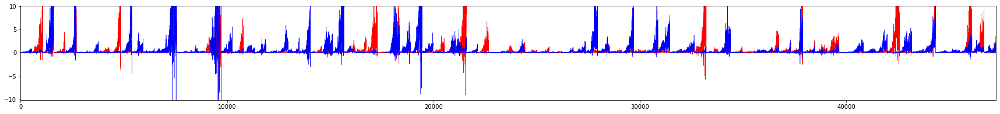

('NW', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


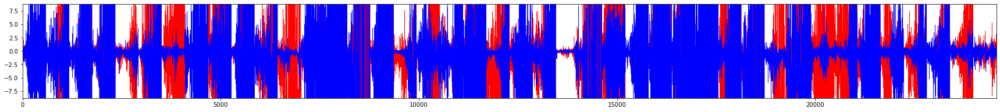

('NW', 'small_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


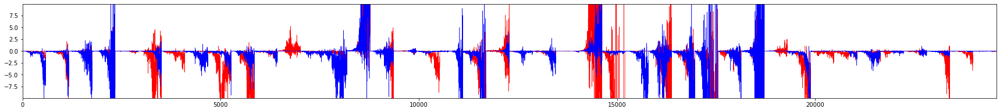

('NW', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


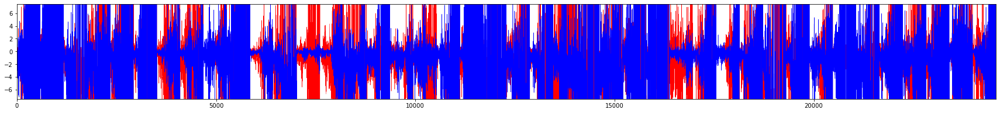

('NW', 'small_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


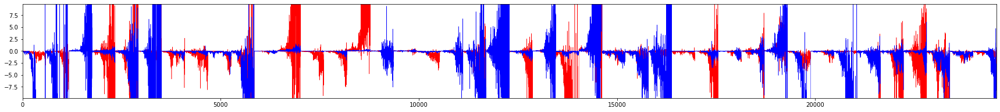

('NW', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


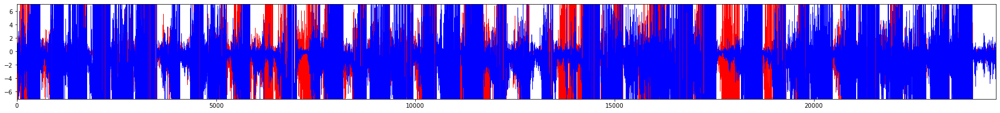

('NW', 'small_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


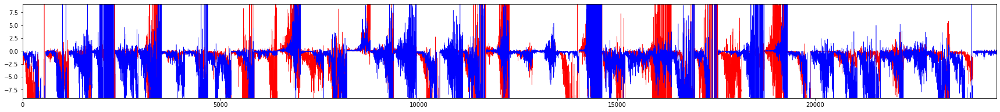

('NW', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


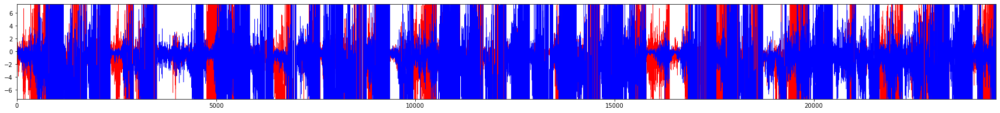

('NW', 'small_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


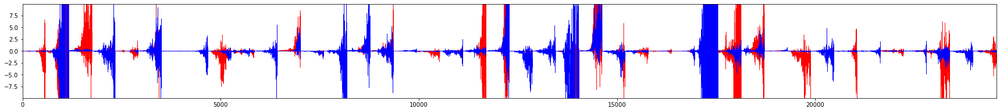

('NW', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


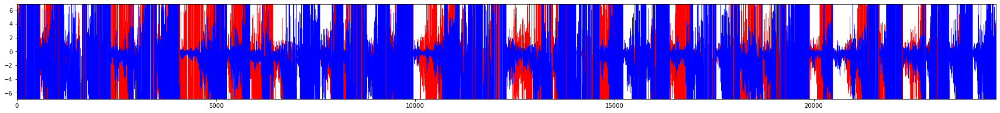

('NW', 'small_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


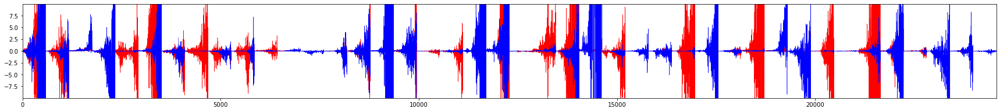

('NW', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


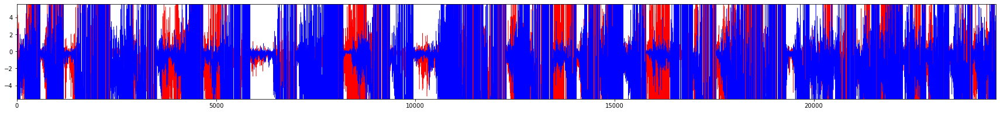

('NW', 'small_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


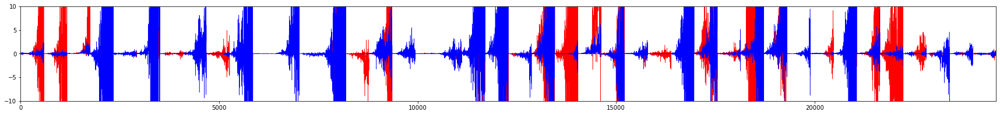

('NW', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


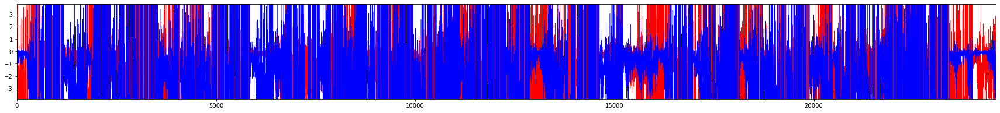

('NW', 'small_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


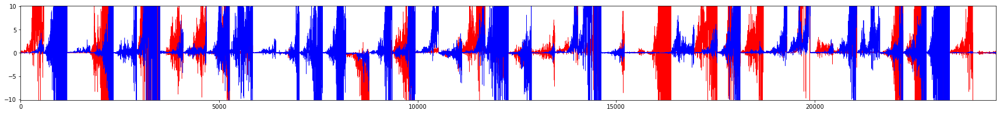

('NW', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


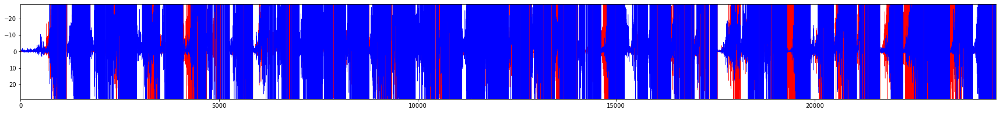

('NW', 'large_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


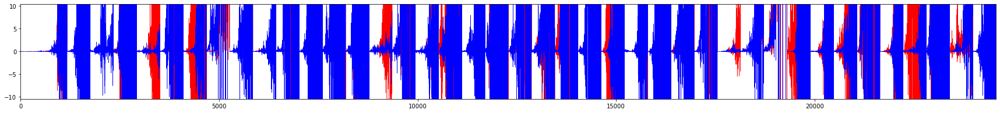

('NW', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


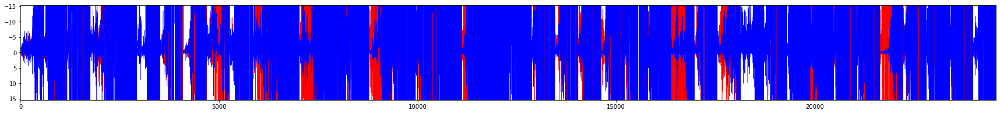

('NW', 'large_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


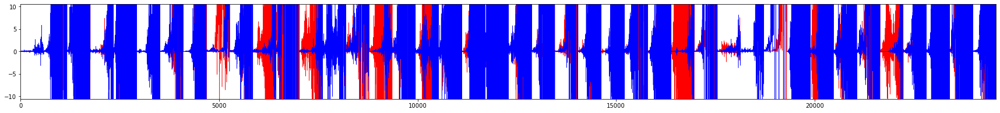

('NW', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


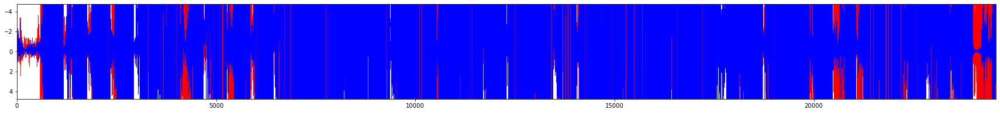

('NW', 'large_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


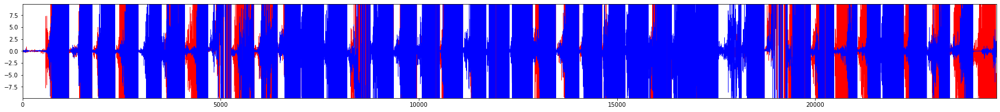

('NW', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


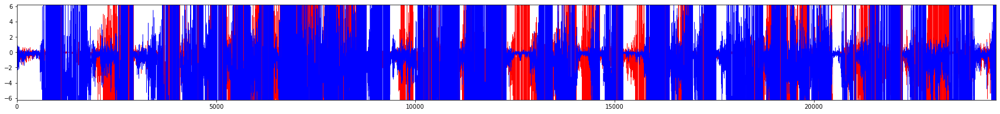

('NW', 'large_COUNT_CUR_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


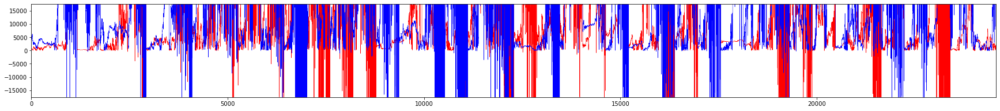

('NW', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


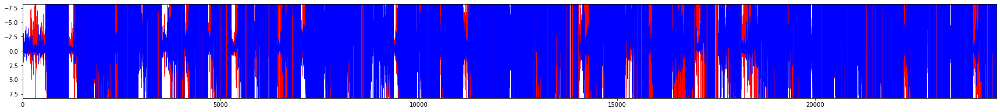

('NW', 'large_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


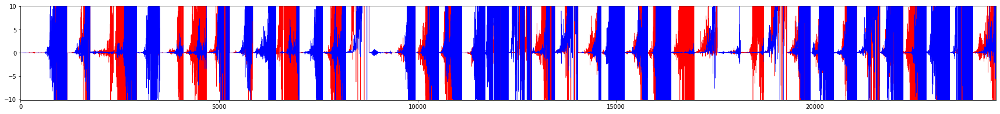

('NW', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


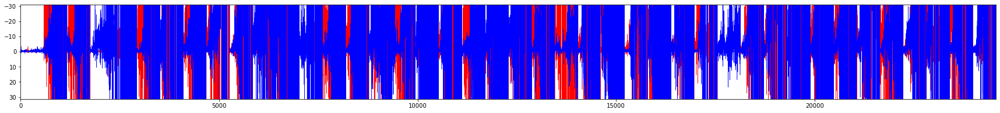

('NW', 'large_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


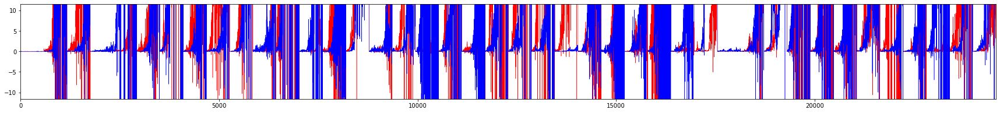

('NW', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


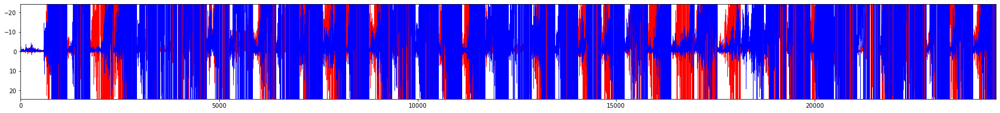

('NW', 'large_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


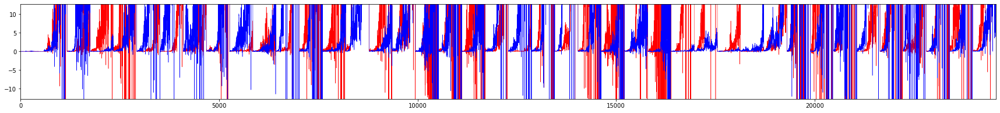

('NW', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


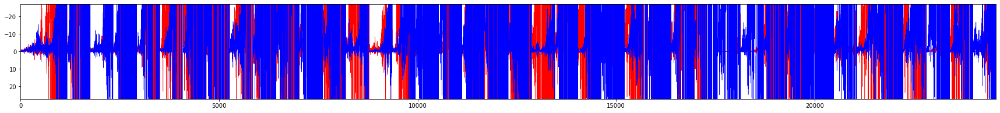

('NW', 'large_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


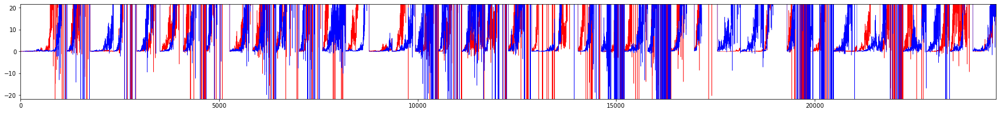

('OW', 'small_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


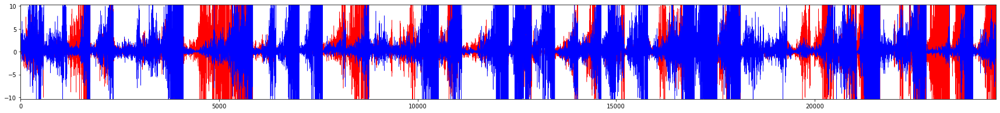

('OW', 'small_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


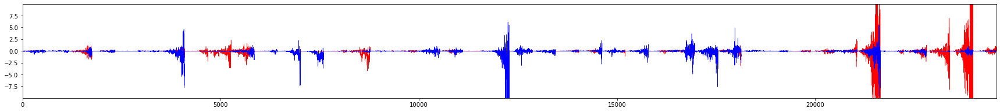

('OW', 'small_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


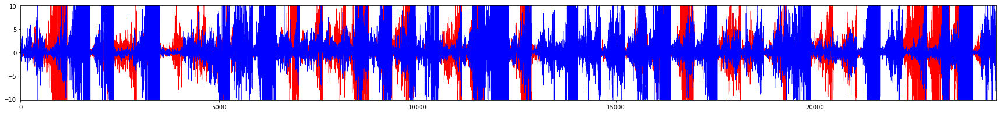

('OW', 'small_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


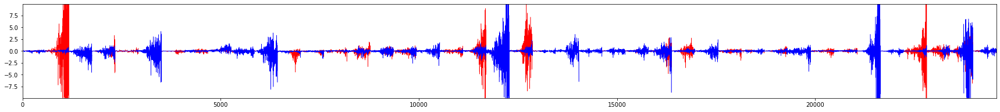

('OW', 'small_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


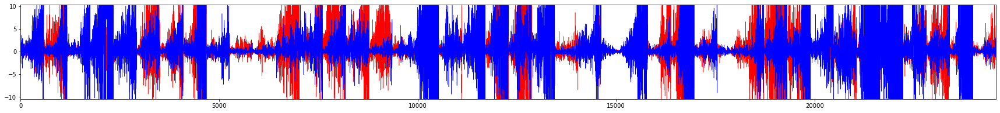

('OW', 'small_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


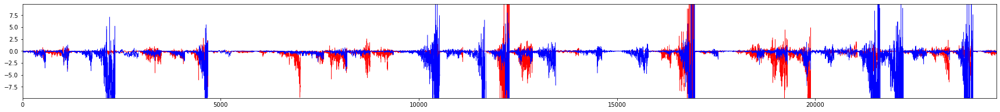

('OW', 'small_COUNT_CUR_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


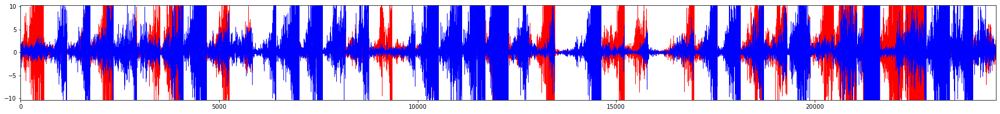

('OW', 'small_COUNT_CUR_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


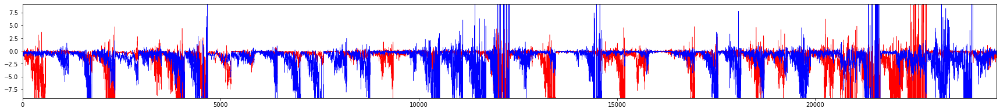

('OW', 'small_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


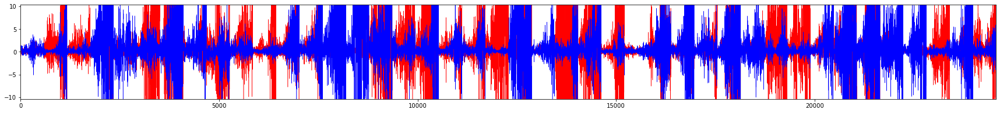

('OW', 'small_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


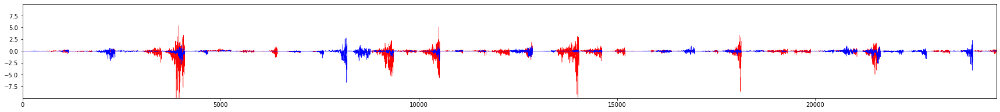

('OW', 'small_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


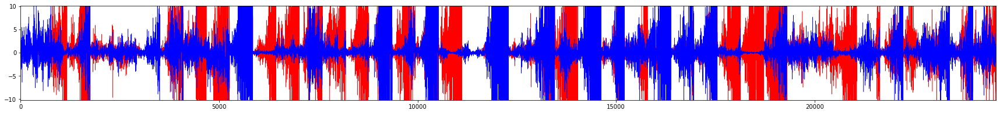

('OW', 'small_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


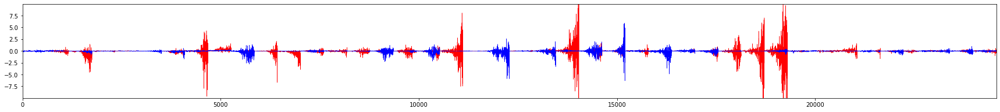

('OW', 'small_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


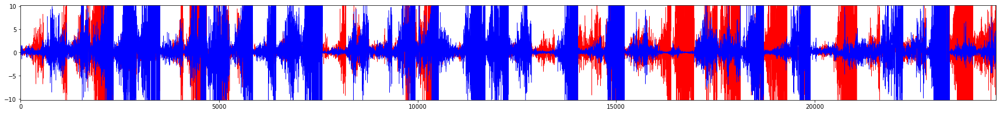

('OW', 'small_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


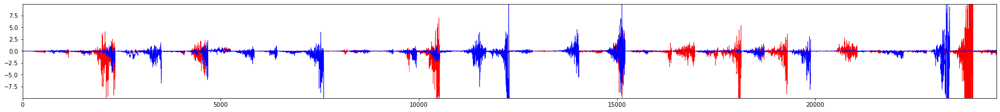

('OW', 'small_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


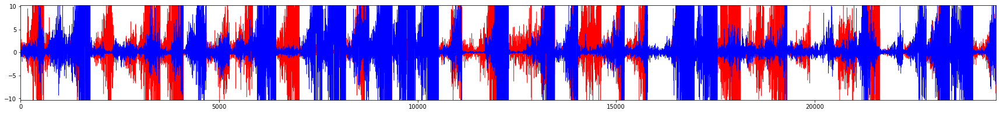

('OW', 'small_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


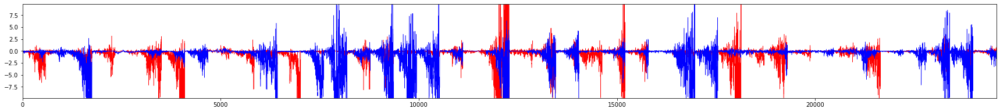

('OW', 'large_COUNT_CUR_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


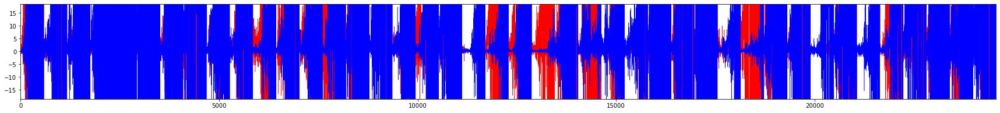

('OW', 'large_COUNT_CUR_1') size 
 Chain1 length:  24570 Chain2 length:  24570


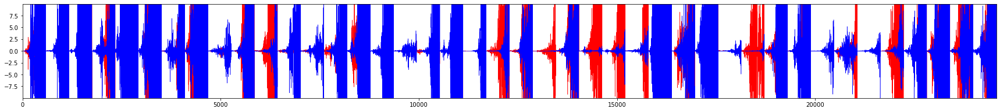

('OW', 'large_COUNT_CUR_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


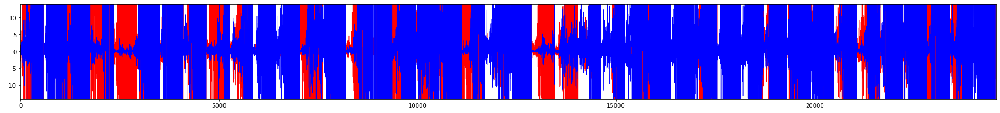

('OW', 'large_COUNT_CUR_10') size 
 Chain1 length:  24570 Chain2 length:  24570


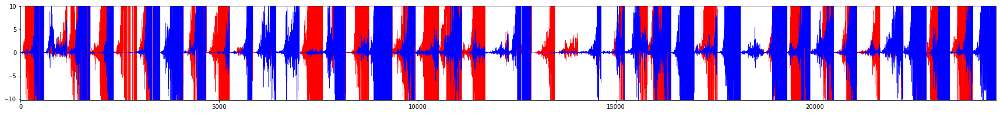

('OW', 'large_COUNT_CUR_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


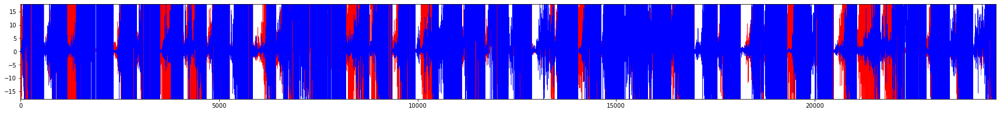

('OW', 'large_COUNT_CUR_100') size 
 Chain1 length:  24570 Chain2 length:  24570


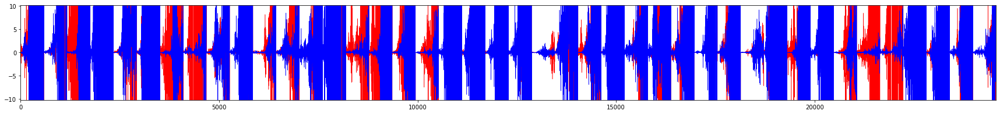

('OW', 'large_COUNT_CUR_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


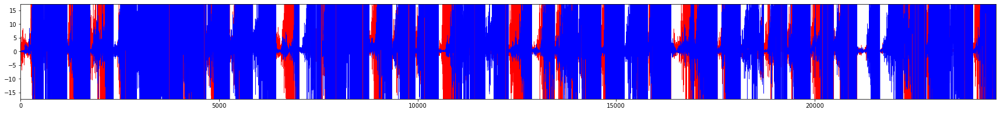

('OW', 'large_COUNT_CUR_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


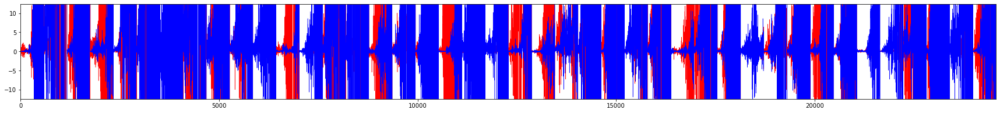

('OW', 'large_COUNT_NAT_1') intercept 
 Chain1 length:  24570 Chain2 length:  24570


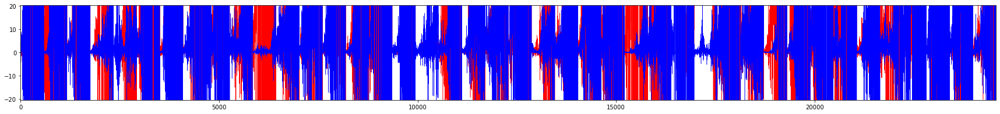

('OW', 'large_COUNT_NAT_1') size 
 Chain1 length:  24570 Chain2 length:  24570


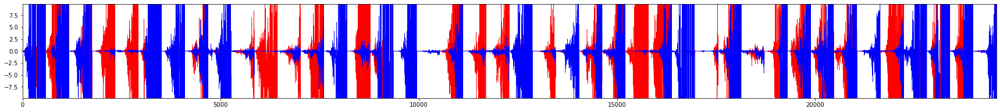

('OW', 'large_COUNT_NAT_10') intercept 
 Chain1 length:  24570 Chain2 length:  24570


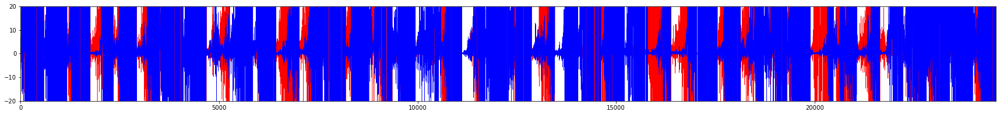

('OW', 'large_COUNT_NAT_10') size 
 Chain1 length:  24570 Chain2 length:  24570


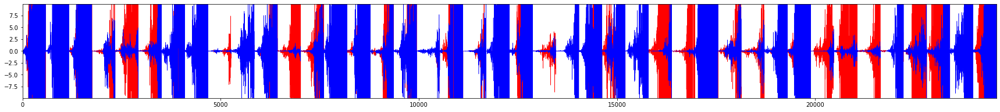

('OW', 'large_COUNT_NAT_100') intercept 
 Chain1 length:  24570 Chain2 length:  24570


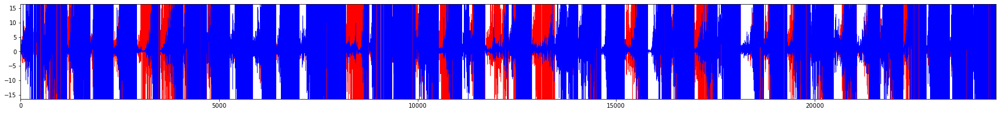

('OW', 'large_COUNT_NAT_100') size 
 Chain1 length:  24570 Chain2 length:  24570


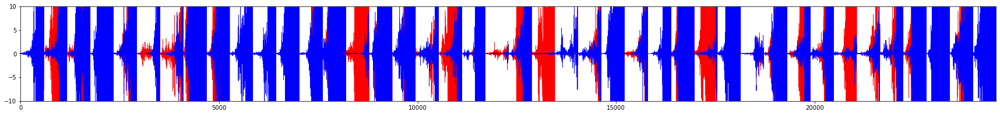

('OW', 'large_COUNT_NAT_1000') intercept 
 Chain1 length:  24570 Chain2 length:  24570


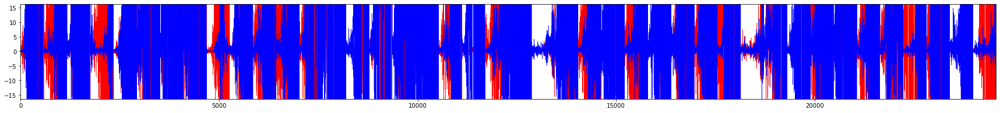

('OW', 'large_COUNT_NAT_1000') size 
 Chain1 length:  24570 Chain2 length:  24570


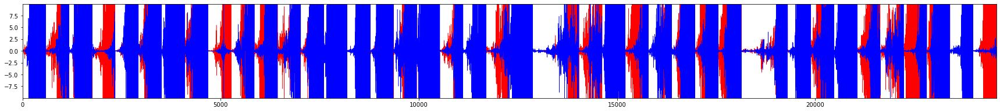

In [4]:
geos_uniq=list(alldata['geog'].unique())
size_uniq=list(alldata['sizetype'].unique())

dataset=alldata[alldata['climate']=='noclimate']

models=list(product(geos_uniq,size_uniq))
for model in models:
#     print(model)
    temp1=dataset[(dataset['geog']==model[0]) & (dataset['sizetype']==model[1]) & (dataset['round']=='round1')]
    temp2=dataset[(dataset['geog']==model[0]) & (dataset['sizetype']==model[1]) & (dataset['round']=='round2')]
    for col in ['intercept','size']:
        if len(temp1) != 0 and len(temp2) != 0:
            print(model,col,'\n','Chain1 length: ',len(temp1), 'Chain2 length: ',len(temp2))
            fig,ax=plt.subplots(figsize=(30,3),facecolor='w')
            ax.plot([x for x in range(len(temp1[col]))],temp1[col],c='r',lw=0.5)
            ax.plot([x for x in range(len(temp2[col]))],temp2[col],c='b',lw=0.5)
            plt.ylim(-temp2[col].median()-10,temp2[col].median()+10)
            plt.xlim(0,(len(temp1)+len(temp2))/2)
            plt.show()
            time.sleep(0.1)


----

# Resampling chains

For every chain, I subsampled every **step** size. I reduced the number of samples taken from each model such that the estimate in the model with the lowest ESS is at least ~200 ESS. To do that for each chain, I looped through the chains estimating the ESS and reducing the number of samples by **sample** number of rows at every ESS calculation cycle and until all estimates had the lowest ESS that is still above 100 (or close). Then, merged the two chains for a min ESS ~ 200 for the estimate with lowest ESS.

For some models, the number of ESS in one estimate (e.g. Precipitation) was noticeably lower than the ESS for the intercept or size.

----

In [19]:
resampled=pd.DataFrame(columns=list(alldata.columns))
geos_uniq=list(alldata['geog'].unique())
size_uniq=list(alldata['sizetype'].unique())
clim_uniq=list(alldata['climate'].unique())
models=list(product(geos_uniq,size_uniq,clim_uniq))
# 'Biome_bin1_ESS','Precip_ESS','size_ESS','intercept_ESS'
step=5
minEss=100
for model in models:
    for roundx in ['round1','round2']:
        # filter the dataset to grep every model's results
        temp=alldata[(alldata['geog']==model[0]) & (alldata['sizetype']==model[1]) & (alldata['climate']==model[2]) & (alldata['round']==roundx)].iloc[::step,:]
        sample=len(temp) # total number of states in the chain for a particular model
        if len(temp.iloc[-sample::,6].values) > 2: # if the model has data...
            if (model[2] == 'noclimate') & ('noherb' not in model[1]): #
                while (effectiveSampleSize(temp.iloc[-sample::,4].values) >= minEss) & (effectiveSampleSize(temp.iloc[-sample::,7].values) >= minEss):
                    sample-=10 # reduce sample until all estimates are low but always above 100 (minEss)
                else:
                    print(model,roundx,sample)
                    print(effectiveSampleSize(temp.iloc[-sample::,4].values),effectiveSampleSize(temp.iloc[-sample::,7].values))
                    temp1=temp.iloc[-sample::,:]
                    resampled=pd.concat([resampled,temp1])
            elif (model[2] == 'noclimate') & ('noherb' in model[1]):
                while effectiveSampleSize(temp.iloc[-sample::,4].values) >= minEss:
                    sample-=10 # reduce sample until all estimates are low but always above 100 (minEss)
                else:
                    print(model,roundx,sample) 
                    print(effectiveSampleSize(temp.iloc[-sample::,4].values))
                    temp1=temp.iloc[-sample::,:] # sample the original model's data to grep the number of samples from the end of the chain (artificially increasing burnin)
                    resampled=pd.concat([resampled,temp1]) # concatenate in a single table            
                    
            elif (model[2] == 'climate') & ('noherb' in model[1]):
                while (effectiveSampleSize(temp.iloc[-sample::,0].values) >= minEss) & (effectiveSampleSize(temp.iloc[-sample::,1].values) >= minEss) & (effectiveSampleSize(temp.iloc[-sample::,4].values) >= minEss):
                    sample-=10 # reduce sample until all estimates are low but always above 100 (minEss)
                else:
                    print(model,roundx,sample) 
                    print(effectiveSampleSize(temp.iloc[-sample::,0].values),effectiveSampleSize(temp.iloc[-sample::,1].values),effectiveSampleSize(temp.iloc[-sample::,4].values))
                    temp1=temp.iloc[-sample::,:] # sample the original model's data to grep the number of samples from the end of the chain (artificially increasing burnin)
                    resampled=pd.concat([resampled,temp1]) # concatenate in a single table            
                        
            elif (model[2] == 'climate') & ('noherb' not in model[1]):
                while (effectiveSampleSize(temp.iloc[-sample::,0].values) >= minEss) & (effectiveSampleSize(temp.iloc[-sample::,1].values) >= minEss) & (effectiveSampleSize(temp.iloc[-sample::,4].values) >= minEss) & (effectiveSampleSize(temp.iloc[-sample::,7].values) >= minEss):
                    sample-=10 # reduce sample until all estimates are low but always above 100 (minEss)
                else:
                    print(model,roundx,sample) 
                    print(effectiveSampleSize(temp.iloc[-sample::,0].values),effectiveSampleSize(temp.iloc[-sample::,1].values),effectiveSampleSize(temp.iloc[-sample::,4].values),effectiveSampleSize(temp.iloc[-sample::,7].values))
                    temp1=temp.iloc[-sample::,:] # sample the original model's data to grep the number of samples from the end of the chain (artificially increasing burnin)
                    resampled=pd.concat([resampled,temp1]) # concatenate in a single table
resampled.head(10)

('allworld', 'small_COUNT_CUR_1000', 'noclimate') round1 908
462.71038573928786 99.76630853970036
('allworld', 'small_COUNT_CUR_1000', 'noclimate') round2 2868
2269.06785232109 99.75578471754505
('allworld', 'small_COUNT_CUR_1000', 'climate') round1 2283
141.52569746894616 118.92153575333009 172.82709941319578 99.64055980328968
('allworld', 'small_COUNT_CUR_1000', 'climate') round2 4194
4194.0 105.41211859227755 118.32223570767505 99.92159116196686
('allworld', 'small_COUNT_CUR_100', 'noclimate') round1 1348
1348.0 99.09120224153052
('allworld', 'small_COUNT_CUR_100', 'noclimate') round2 1578
1501.2148972158866 99.72064545613539
('allworld', 'small_COUNT_CUR_100', 'climate') round1 2232
156.74479597435075 93.467189255564 94.19888186518574 128.1087697234756
('allworld', 'small_COUNT_CUR_100', 'climate') round2 2447
304.1290122392928 99.73699678907902 103.51447699700833 274.32971814612745
('allworld', 'small_COUNT_CUR_10', 'noclimate') round1 2328
2037.398026471278 98.75663730762105
('al

('NW', 'small_COUNT_CUR_100', 'climate') round1 1783
161.0140337871351 227.69622170185477 743.0985214788963 98.75051734268862
('NW', 'small_COUNT_CUR_100', 'climate') round2 1753
176.4423141674091 265.9612033477685 553.8657878623688 99.85659295641813
('NW', 'small_COUNT_CUR_10', 'noclimate') round1 1708
160.406745556472 57.15173149602912
('NW', 'small_COUNT_CUR_10', 'noclimate') round2 1948
300.7169396717469 99.59813178763679
('NW', 'small_COUNT_CUR_10', 'climate') round1 2103
201.97130789326152 335.2126196942541 695.6005380425182 99.92287783671524
('NW', 'small_COUNT_CUR_10', 'climate') round2 1633
106.2356816555269 269.35249681418543 374.709580603455 99.47160121775843
('NW', 'small_COUNT_CUR_1', 'noclimate') round1 1468
99.39269717484959 164.43523713441414
('NW', 'small_COUNT_CUR_1', 'noclimate') round2 1278
954.5352886255276 99.93796028786919
('NW', 'small_COUNT_CUR_1', 'climate') round1 2803
290.1359256811185 462.56549313715055 992.5284224474005 99.78779651568469
('NW', 'small_COUN

('OW', 'small_COUNT_NAT_1000', 'noclimate') round1 618
618.0 99.51644979051281
('OW', 'small_COUNT_NAT_1000', 'noclimate') round2 1758
863.3186265216403 99.60849726849845
('OW', 'small_COUNT_NAT_1000', 'climate') round1 613
156.16311681946817 231.3067994630693 99.58872094289033 121.54057059349017
('OW', 'small_COUNT_NAT_1000', 'climate') round2 1483
253.60525693651712 665.5238809879293 207.75275882327654 96.44010335620386
('OW', 'small_COUNT_NAT_100', 'noclimate') round1 798
729.2946700421278 98.95597791117257
('OW', 'small_COUNT_NAT_100', 'noclimate') round2 2138
286.6120848324342 99.59517822663672
('OW', 'small_COUNT_NAT_100', 'climate') round1 2683
505.16472160159196 2299.7590115788516 426.7135913038762 99.93527535269703
('OW', 'small_COUNT_NAT_100', 'climate') round2 793
99.5912996391847 793.0 171.6969588122488 157.63874382983846
('OW', 'small_COUNT_NAT_10', 'noclimate') round1 98
98.0 48.20934563632309
('OW', 'small_COUNT_NAT_10', 'noclimate') round2 218
97.06806593606656 106.2382

,Biome_bin1,Precip,climate,geog,intercept,rindex,round,size,sizetype
16630,NaN,NaN,noclimate,allworld,-0.941784,16631.0,round1,0.219524,small_COUNT_CUR_1000
16635,NaN,NaN,noclimate,allworld,-1.065840,16636.0,round1,-0.371926,small_COUNT_CUR_1000
16640,NaN,NaN,noclimate,allworld,-0.908929,16641.0,round1,-0.108001,small_COUNT_CUR_1000
16645,NaN,NaN,noclimate,allworld,-1.100776,16646.0,round1,-0.061462,small_COUNT_CUR_1000
16650,NaN,NaN,noclimate,allworld,-3.276699,16651.0,round1,-0.049559,small_COUNT_CUR_1000
16655,NaN,NaN,noclimate,allworld,-0.027502,16656.0,round1,-0.632507,small_COUNT_CUR_1000
16660,NaN,NaN,noclimate,allworld,-1.050570,16661.0,round1,-0.263653,small_COUNT_CUR_1000
16665,NaN,NaN,noclimate,allworld,-0.262251,16666.0,round1,-0.180705,small_COUNT_CUR_1000
16670,NaN,NaN,noclimate,allworld,-0.534446,16671.0,round1,-0.151169,small_COUNT_CUR_1000
16675,NaN,NaN,noclimate,allworld,-0.883421,16676.0,round1,-0.863180,small_COUNT_CUR_1000


In [20]:
# backup the subsampled results in a single table to read it later and skip estimating the resampling every time (takes time)
resampled.to_csv('./subsampled_chains_2021018.txt',sep='\t')

# read data
# resampled=pd.read_csv('./subsampled_chains_20210104.txt',sep='\t')
# resampled.drop(columns='Unnamed: 0',inplace=True)
resampled

,Biome_bin1,Precip,climate,geog,intercept,rindex,round,size,sizetype
16630,NaN,NaN,noclimate,allworld,-0.941784,16631.0,round1,0.219524,small_COUNT_CUR_1000
16635,NaN,NaN,noclimate,allworld,-1.065840,16636.0,round1,-0.371926,small_COUNT_CUR_1000
16640,NaN,NaN,noclimate,allworld,-0.908929,16641.0,round1,-0.108001,small_COUNT_CUR_1000
16645,NaN,NaN,noclimate,allworld,-1.100776,16646.0,round1,-0.061462,small_COUNT_CUR_1000
16650,NaN,NaN,noclimate,allworld,-3.276699,16651.0,round1,-0.049559,small_COUNT_CUR_1000
...,...,...,...,...,...,...,...,...,...
83555,113580.808599,-126238.621479,climate,OW,-31956.686650,83556.0,round2,NaN,small_noherb
83560,7784.737721,-34490.603284,climate,OW,69663.423043,83561.0,round2,NaN,small_noherb
83565,-18117.100876,-171496.121467,climate,OW,-37789.187797,83566.0,round2,NaN,small_noherb
83570,-49874.269805,-152338.375577,climate,OW,-41041.777028,83571.0,round2,NaN,small_noherb


In [21]:
resampled[['Biome_bin1','Precip','size','intercept']]=resampled[['Biome_bin1','Precip','size','intercept']].astype('float')
resampled.replace('none',np.nan,inplace=True)

In [22]:
resampled[(resampled['climate']=='climate') & (resampled['geog']=='NW') & (resampled['sizetype']=='large_noherb')]

,Biome_bin1,Precip,climate,geog,intercept,rindex,round,size,sizetype
82450,-132709.283680,-120313.338894,climate,NW,152289.998628,82451.0,round1,NaN,large_noherb
82455,28448.029942,-90174.106598,climate,NW,-116962.253228,82456.0,round1,NaN,large_noherb
82460,-158976.252706,31249.297319,climate,NW,52888.382358,82461.0,round1,NaN,large_noherb
82465,-126372.565561,-80993.706867,climate,NW,-31097.170771,82466.0,round1,NaN,large_noherb
82470,-62169.405776,42228.874785,climate,NW,109509.388126,82471.0,round1,NaN,large_noherb
...,...,...,...,...,...,...,...,...,...
83555,7234.055003,57242.814680,climate,NW,82137.138945,83556.0,round2,NaN,large_noherb
83560,-48643.370095,-84449.074440,climate,NW,57543.881815,83561.0,round2,NaN,large_noherb
83565,42099.271192,-82778.881284,climate,NW,2846.671723,83566.0,round2,NaN,large_noherb
83570,65736.559958,-91665.547109,climate,NW,-40489.118918,83571.0,round2,NaN,large_noherb


In [23]:
# resampled.replace('none',np.nan,inplace=True)
# alldata.replace('none',np.nan,inplace=True)
resampled[(resampled['climate']=='climate') & (resampled['geog']=='NW') & (resampled['sizetype']=='small_noherb') ]

,Biome_bin1,Precip,climate,geog,intercept,rindex,round,size,sizetype
74150,-604.548024,-4704.985696,climate,NW,10454.376232,74151.0,round1,NaN,small_noherb
74155,-643.083498,666.127522,climate,NW,-3865.436748,74156.0,round1,NaN,small_noherb
74160,488.677154,-6844.115217,climate,NW,19753.615083,74161.0,round1,NaN,small_noherb
74165,-1348.888891,-2279.406999,climate,NW,4112.979368,74166.0,round1,NaN,small_noherb
74170,-770.373135,-10149.697119,climate,NW,33984.691796,74171.0,round1,NaN,small_noherb
...,...,...,...,...,...,...,...,...,...
83555,107493.350737,13758.504765,climate,NW,-149740.212922,83556.0,round2,NaN,small_noherb
83560,20028.791435,-92605.086892,climate,NW,40638.066905,83561.0,round2,NaN,small_noherb
83565,-3874.381136,-91353.315261,climate,NW,-59726.021812,83566.0,round2,NaN,small_noherb
83570,97570.754440,-92830.539324,climate,NW,-160882.857335,83571.0,round2,NaN,small_noherb


In [5]:
# resampled.to_csv('./subsampled_chains_20210115.txt',sep='\t')
# resampled=pd.read_csv('./subsampled_chains_20210118.txt',sep='\t')

In [6]:
resampled[['Biome_bin1','Precip','size','intercept']]=resampled[['Biome_bin1','Precip','size','intercept']].astype('float')
resampled.replace('none',np.nan,inplace=True)

# Summarise the subsampled results

In [24]:
summary=resampled.groupby(by=['geog','sizetype','climate']).median() # calculate median of all other columns
for col in ['Biome_bin1','Precip','size','intercept']: # 'Biome_bin1_ESS','Precip_ESS','size_ESS','intercept_ESS'
        summary['%s_median'%(col)]=resampled.groupby(by=['geog','sizetype','climate'])[col].median() # sanity. These columns and the columns with the original name should have the same data
        # 95% interval
        summary['%s_025'%(col)]=resampled.groupby(by=['geog','sizetype','climate'])[col].quantile(q=0.025)
        summary['%s_975'%(col)]=resampled.groupby(by=['geog','sizetype','climate'])[col].quantile(q=0.975)
        # effective sample sizes
        summary['%s_ESS'%(col)]=resampled.groupby(by=['geog','sizetype','climate'])[col].apply(lambda x: effectiveSampleSize(x.values))

summary.reset_index(inplace=True)
# summary.to_csv('./resampled_summary_20210104.txt',sep='\t') # save it to file
# just checking things are correct
summary[['geog','sizetype','climate','Biome_bin1','Biome_bin1_median','Biome_bin1_025','Biome_bin1_975','Biome_bin1_ESS']]

,geog,sizetype,climate,Biome_bin1,Biome_bin1_median,Biome_bin1_025,Biome_bin1_975,Biome_bin1_ESS
0,NW,large_COUNT_CUR_1,climate,-1082.896962,-1082.896962,-172303.034990,162632.863729,383.745920
1,NW,large_COUNT_CUR_1,noclimate,NaN,NaN,NaN,NaN,NaN
2,NW,large_COUNT_CUR_10,climate,-444.505779,-444.505779,-166268.637468,159133.408578,256.000000
3,NW,large_COUNT_CUR_10,noclimate,NaN,NaN,NaN,NaN,NaN
4,NW,large_COUNT_CUR_100,climate,-6280.633661,-6280.633661,-177102.537127,150025.501772,130.352202
...,...,...,...,...,...,...,...,...
103,allworld,small_COUNT_NAT_100,noclimate,NaN,NaN,NaN,NaN,NaN
104,allworld,small_COUNT_NAT_1000,climate,0.393996,0.393996,-233.002117,547.041185,3428.000000
105,allworld,small_COUNT_NAT_1000,noclimate,NaN,NaN,NaN,NaN,NaN
106,allworld,small_noherb,climate,0.605495,0.605495,-429.142599,1022.857752,9642.000000


# All ESSssss..

In [25]:
pd.set_option('display.max_rows',110)
summary[['geog','sizetype','climate','Biome_bin1_ESS','Precip_ESS','size_ESS','intercept_ESS']].sort_values(by=['Biome_bin1_ESS','Precip_ESS','size_ESS','intercept_ESS'],
                                                                                                                   ascending=[True,True,True,True])

,geog,sizetype,climate,Biome_bin1_ESS,Precip_ESS,size_ESS,intercept_ESS
4,NW,large_COUNT_CUR_100,climate,130.352202,670.866411,1153.664297,1276.000000
70,OW,small_noherb,climate,132.340769,2032.000000,NaN,1460.441523
36,OW,large_COUNT_CUR_1,climate,137.369688,349.488559,316.739734,242.219284
56,OW,small_COUNT_CUR_10,climate,165.897765,816.000000,816.000000,295.869556
40,OW,large_COUNT_CUR_100,climate,168.076687,356.000000,259.785266,304.973580
30,NW,small_COUNT_NAT_100,climate,181.118876,271.759849,323.896913,557.824260
52,OW,large_noherb,climate,185.683109,262.000000,NaN,262.000000
42,OW,large_COUNT_CUR_1000,climate,189.664798,466.146160,348.521236,506.000000
88,allworld,large_noherb,climate,190.956881,1084.459948,NaN,5152.000000
76,allworld,large_COUNT_CUR_100,climate,199.786288,2516.515915,960.916638,3280.216001


---

# Plotting the results

---

In [26]:
geos_uniq=list(summary['geog'].unique())
size_uniq=list(summary['sizetype'].unique())
clim_uniq=list(summary['climate'].unique())
geo_clim=list(product(geos_uniq,clim_uniq))
# models=list(product(geos_uniq,size_uniq))#,clim_uniq))
estimates=['intercept','size','Biome_bin1', 'Precip']
print(geo_clim)

[('NW', 'climate'), ('NW', 'noclimate'), ('OW', 'climate'), ('OW', 'noclimate'), ('allworld', 'climate'), ('allworld', 'noclimate')]


In [27]:
gridrows=len(geos_uniq)*len(clim_uniq)
gridcols=len(size_uniq)

print(gridrows,gridcols)

6 18


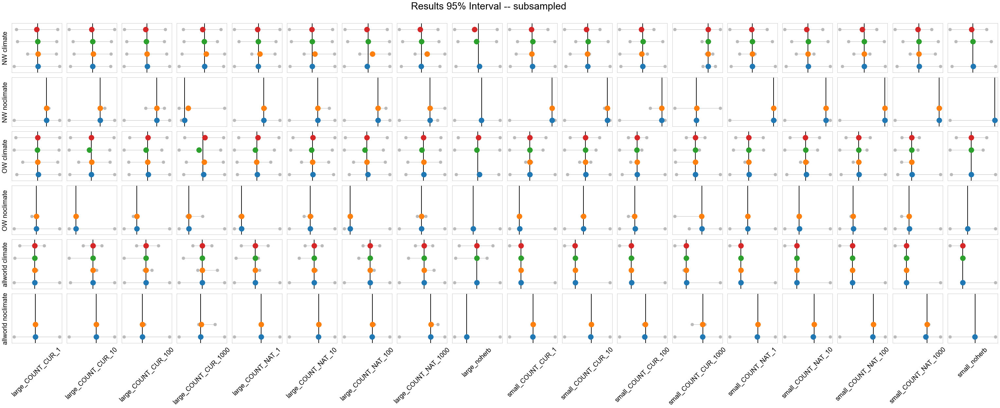

In [28]:
gridrows=len(geos_uniq)*len(clim_uniq)
gridcols=len(size_uniq)

fig=plt.figure(figsize=(3*(gridcols),3*(gridrows)),facecolor='w') # widht height
fig.suptitle('Results 95% Interval -- subsampled', size=30,y=0.93,fontname='Arial')
outer_grid=gridspec.GridSpec(gridrows,gridcols, wspace=0.1, hspace=0.1)

rows=sum([[x]*gridcols for x in range(gridrows)],[])
for index,(geo,clim,column) in enumerate(product([x for x in range(len(geos_uniq))],[clim for clim in range(len(clim_uniq))],[y for y in range(len(size_uniq))])):
    temp=summary[(summary['geog']==geos_uniq[geo]) & (summary['climate']==clim_uniq[clim]) & (summary['sizetype']==size_uniq[column])]
    ax=plt.subplot(outer_grid[rows[index],column])
    plt.ylim(-0.5,3.5)
    for ind,col in enumerate(estimates):
        try:
            ax.scatter(temp['%s_025'%(estimates[ind])],ind,s=80,c='#bababa',zorder=2)
            ax.scatter(temp['%s_median'%(estimates[ind])],ind,s=250,zorder=3)
            ax.scatter(temp['%s_975'%(estimates[ind])],ind,s=80,c='#bababa',zorder=2)
            ax.hlines(y=ind,xmin=temp['%s_025'%(estimates[ind])],xmax=temp['%s_975'%(estimates[ind])],lw=1,ls='-',color='#bababa',zorder=1)
        except:
            pass
        ax.vlines(x=0,ymin=ax.get_ylim()[0],ymax=ax.get_ylim()[1],lw=1.5,ls='-',color='k',zorder=1)
        ax.set_xticklabels([]);ax.set_yticklabels([]);ax.tick_params(axis='both',which='both',length=0,width=0)
        [ax.spines[loc].set_visible(True) for loc in ['top','right','left','bottom']]
        [ax.spines[loc].set_color('#bababa') for loc in ['top','right','left','bottom']]
        if column == 0:
            plt.ylabel('%s %s'%(geos_uniq[geo],clim_uniq[clim]),fontdict={'fontsize':20,'fontname':'Arial'},labelpad=6)
        if rows[index] == 5:
            plt.xlabel(size_uniq[column],fontdict={'fontsize':20,'fontname':'Arial'},labelpad=6,rotation=45)
plt.show()

# Using the complete chains

Just to check that I have not biased the results when sampling and reducing the chains.

In [35]:
# summaryall.to_csv('./summaryall_20210105.txt',sep='\t')

---

# Trying with 95% highest density estimation

Just to double check that the lack of significance is indeed a lack of significance

---

In [29]:
summaryHDP=resampled.groupby(by=['geog','sizetype','climate']).median() # calculate median of all other columns
for col in ['Biome_bin1','Precip','size','intercept']: # 'Biome_bin1_ESS','Precip_ESS','size_ESS','intercept_ESS'
        summaryHDP['%s_median'%(col)]=resampled.groupby(by=['geog','sizetype','climate'])[col].median() # sanity. These columns and the columns with the original name should have the same data
        # 95% interval
        summaryHDP['%s_025'%(col)]=resampled.groupby(by=['geog','sizetype','climate'])[col].quantile(q=0.025)
        summaryHDP['%s_975'%(col)]=resampled.groupby(by=['geog','sizetype','climate'])[col].quantile(q=0.975)
        # effective sample sizes
        summaryHDP['%s_ESS'%(col)]=resampled.groupby(by=['geog','sizetype','climate'])[col].apply(lambda x: effectiveSampleSize(x.values))
        summaryHDP['%s_HPD'%(col)]=resampled.groupby(by=['geog','sizetype','climate'])[col].apply(lambda x: hpd(x.values,0.95)) # sanity. These columns and the columns with the original name should have the same data

summaryHDP.reset_index(inplace=True)
for col in ['Biome_bin1','Precip','size','intercept']:
    summaryHDP[['%s_HPD_025'%(col), '%s_HPD_975'%(col)]]=pd.DataFrame(summaryHDP['%s_HPD'%(col)].tolist(),index=summaryHDP.index)
summaryHDP.to_csv('./resampled_summaryHPD_20210115.txt',sep='\t') # save it to file
summaryHDP[['size','size_median','size_025','size_975','size_HPD','size_HPD_025','size_HPD_975','size_ESS']]

,size,size_median,size_025,size_975,size_HPD,size_HPD_025,size_HPD_975,size_ESS
0,3258.001111,3258.001111,-86990.018830,159977.291396,"(-80027.4981843074, 164060.548755162)",-80027.498184,164060.548755,315.965317
1,0.535038,0.535038,-2995.436266,5486.655651,"(-3775.1239184859, 4132.89853661499)",-3775.123918,4132.898537,313.759730
2,5821.827667,5821.827667,-158172.053309,156404.548946,"(-158183.939672305, 147716.97594344598)",-158183.939672,147716.975943,231.587658
3,1.451341,1.451341,-2785.943464,14837.379217,"(-3252.77507234669, 14016.8359595926)",-3252.775072,14016.835960,160.217871
4,-696.968932,-696.968932,-177629.076991,169721.152524,"(-171669.56715844, 173158.625581313)",-171669.567158,173158.625581,1153.664297
5,-0.189373,-0.189373,-34359.515120,23469.643233,"(-26780.4781031044, 27357.4100834529)",-26780.478103,27357.410083,308.236523
6,13497.542901,13497.542901,-186680.278908,169188.070142,"(-174869.116750634, 180954.301860136)",-174869.116751,180954.301860,237.500684
7,16797.850684,16797.850684,-24573.153545,180207.975433,"(-11598.5573936567, 189254.345556445)",-11598.557394,189254.345556,188.078801
8,10727.696772,10727.696772,-61512.749087,140296.968531,"(-38991.0656582393, 160604.470477751)",-38991.065658,160604.470478,167.588724
9,0.363547,0.363547,-272.673950,6312.517100,"(-581.559292643229, 4660.33048524853)",-581.559293,4660.330485,136.119849


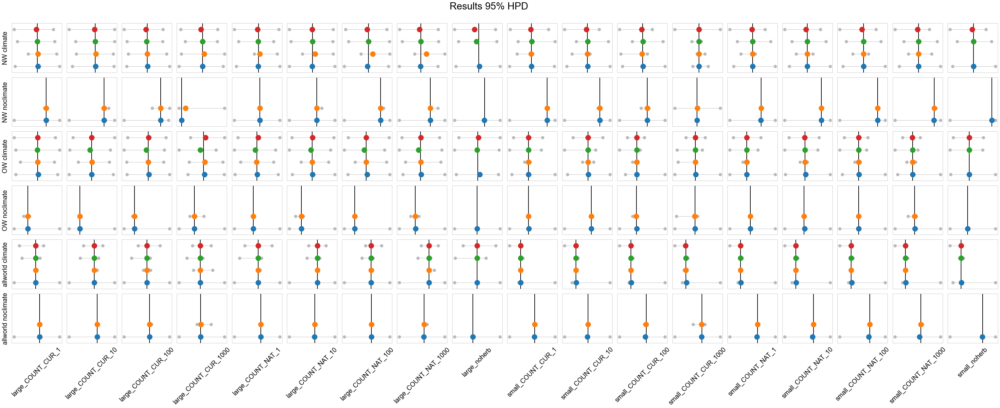

In [30]:
gridrows=len(geos_uniq)*len(clim_uniq)
gridcols=len(size_uniq)

fig=plt.figure(figsize=(3*(gridcols),3*(gridrows)),facecolor='w') # widht height
fig.suptitle('Results 95% HPD', size=30,y=0.93,fontname='Arial')
outer_grid=gridspec.GridSpec(gridrows,gridcols, wspace=0.1, hspace=0.1)

rows=sum([[x]*gridcols for x in range(gridrows)],[])
for index,(geo,clim,column) in enumerate(product([x for x in range(len(geos_uniq))],[clim for clim in range(len(clim_uniq))],[y for y in range(len(size_uniq))])):
    temp=summaryHDP[(summaryHDP['geog']==geos_uniq[geo]) & (summaryHDP['climate']==clim_uniq[clim]) & (summaryHDP['sizetype']==size_uniq[column])]
    ax=plt.subplot(outer_grid[rows[index],column])
    plt.ylim(-0.5,3.5)
    for ind,col in enumerate(estimates):
        try:
            ax.scatter(temp['%s_HPD_025'%(estimates[ind])],ind,s=80,c='#bababa',zorder=2)
            ax.scatter(temp['%s_median'%(estimates[ind])],ind,s=250,zorder=3)
            ax.scatter(temp['%s_HPD_975'%(estimates[ind])],ind,s=80,c='#bababa',zorder=2)
            ax.hlines(y=ind,xmin=temp['%s_HPD_025'%(estimates[ind])],xmax=temp['%s_HPD_975'%(estimates[ind])],lw=1,ls='-',color='#bababa',zorder=1)
        except:
            pass
        ax.vlines(x=0,ymin=ax.get_ylim()[0],ymax=ax.get_ylim()[1],lw=1.5,ls='-',color='k',zorder=1)
        ax.set_xticklabels([]);ax.set_yticklabels([]);ax.tick_params(axis='both',which='both',length=0,width=0)
        [ax.spines[loc].set_visible(True) for loc in ['top','right','left','bottom']]
        [ax.spines[loc].set_color('#bababa') for loc in ['top','right','left','bottom']]
        if column == 0:
            plt.ylabel('%s %s'%(geos_uniq[geo],clim_uniq[clim]),fontdict={'fontsize':20,'fontname':'Arial'},labelpad=6)
        if rows[index] == 5:
            plt.xlabel(size_uniq[column],fontdict={'fontsize':20,'fontname':'Arial'},labelpad=6,rotation=45)
plt.show()

---

# Check if 95% intervals overlap zero

In case the size of the figures interferes

number of samples above zero = len(samples > 0)  
total number of samples = len(samples)  
proportion of samples above zero = len(samples > 0) / len(samples)

---

In [62]:
models=[]
samples_above0=[]
samples_total=[]
samples_propabove0=[]
col_name=[]
for index,(geo,clim,column) in enumerate(product([x for x in range(len(geos_uniq))],[clim for clim in range(len(clim_uniq))],[y for y in range(len(size_uniq))])):
    temp=resampled[(resampled['geog']==geos_uniq[geo]) & (resampled['climate']==clim_uniq[clim]) & (resampled['sizetype']==size_uniq[column])]
    for col in ['Biome_bin1','Precip','size','intercept']:
        if len(temp[col]) > 1:
            models.append('%s-%s-%s'%(geos_uniq[geo],clim_uniq[clim],size_uniq[column]))
            samples_above0.append(len(temp[temp[col]>0]))
            samples_total.append(len(temp[col]))
            samples_propabove0.append(len(temp[temp[col]>0])/len(temp[col]))
            col_name.append(col)
proportions=pd.DataFrame(zip(models,col_name,samples_above0,samples_total,samples_propabove0),columns=['models','variable','samples_above0','samples_total','samples_propabove0'])
proportions

,models,variable,samples_above0,samples_total,samples_propabove0
0,NW-climate-large_COUNT_CUR_1,Biome_bin1,229,496,0.461694
1,NW-climate-large_COUNT_CUR_1,Precip,204,496,0.411290
2,NW-climate-large_COUNT_CUR_1,size,339,496,0.683468
3,NW-climate-large_COUNT_CUR_1,intercept,270,496,0.544355
4,NW-climate-large_COUNT_CUR_10,Biome_bin1,114,256,0.445312
...,...,...,...,...,...
427,allworld-noclimate-small_COUNT_NAT_1000,intercept,1152,3246,0.354898
428,allworld-noclimate-small_noherb,Biome_bin1,0,312,0.000000
429,allworld-noclimate-small_noherb,Precip,0,312,0.000000
430,allworld-noclimate-small_noherb,size,0,312,0.000000


# Potentially significant stuff ------>

Unless I calculated it wrong.

In [47]:
significant=list(proportions[(proportions['samples_propabove0']>=0.95) | ((proportions['models'].astype(str).str.contains('-climate')) & (proportions['samples_propabove0']<=0.05))]['models'].values)
varsignificant=list(proportions[(proportions['samples_propabove0']>=0.95) | ((proportions['models'].astype(str).str.contains('-climate')) & (proportions['samples_propabove0']<=0.05))]['variable'].values)
vartest=dict(zip(significant,varsignificant))
proportions[proportions['samples_propabove0']>=0.95]

,models,variable,samples_above0,samples_total,samples_propabove0
86,NW-noclimate-large_COUNT_CUR_1000,size,2575,2676,0.962257
98,NW-noclimate-large_COUNT_NAT_100,size,3390,3536,0.958710
102,NW-noclimate-large_COUNT_NAT_1000,size,3641,3706,0.982461
314,allworld-climate-large_COUNT_NAT_100,size,4272,4436,0.963030
318,allworld-climate-large_COUNT_NAT_1000,size,4407,4496,0.980205
335,allworld-climate-small_COUNT_CUR_100,intercept,4462,4679,0.953623
386,allworld-noclimate-large_COUNT_NAT_100,size,4076,4178,0.975586
390,allworld-noclimate-large_COUNT_NAT_1000,size,4022,4108,0.979065


not sure this should be calculated like this...  
but it means that the majority of the samples is below zero

In [48]:
# IGNORE THE MODELS THAT HAVE NOHERB AND SIZE AS SIGNIFICANT VARIABLE!! the filter shows them just because all samples (nan) non is non-zero.
proportions[(proportions['models'].astype(str).str.contains('-climate')) & (proportions['samples_propabove0']<=0.05)]

,models,variable,samples_above0,samples_total,samples_propabove0
34,NW-climate-large_noherb,size,0,372,0.000000
70,NW-climate-small_noherb,size,0,4212,0.000000
178,OW-climate-large_noherb,size,0,262,0.000000
214,OW-climate-small_noherb,size,0,2032,0.000000
322,allworld-climate-large_noherb,size,0,5152,0.000000
333,allworld-climate-small_COUNT_CUR_100,Precip,138,4679,0.029493
337,allworld-climate-small_COUNT_CUR_1000,Precip,223,6477,0.034430
341,allworld-climate-small_COUNT_NAT_1,Precip,258,5291,0.048762
345,allworld-climate-small_COUNT_NAT_10,Precip,258,5751,0.044862
349,allworld-climate-small_COUNT_NAT_100,Precip,231,4641,0.049774


In [49]:
# significant
# vartest

{'NW-climate-large_noherb': 'size',
 'NW-climate-small_noherb': 'size',
 'NW-noclimate-large_COUNT_CUR_1000': 'size',
 'NW-noclimate-large_COUNT_NAT_100': 'size',
 'NW-noclimate-large_COUNT_NAT_1000': 'size',
 'OW-climate-large_noherb': 'size',
 'OW-climate-small_noherb': 'size',
 'allworld-climate-large_COUNT_NAT_100': 'size',
 'allworld-climate-large_COUNT_NAT_1000': 'size',
 'allworld-climate-large_noherb': 'size',
 'allworld-climate-small_COUNT_CUR_100': 'intercept',
 'allworld-climate-small_COUNT_CUR_1000': 'Precip',
 'allworld-climate-small_COUNT_NAT_1': 'Precip',
 'allworld-climate-small_COUNT_NAT_10': 'Precip',
 'allworld-climate-small_COUNT_NAT_100': 'Precip',
 'allworld-climate-small_noherb': 'size',
 'allworld-noclimate-large_COUNT_NAT_100': 'size',
 'allworld-noclimate-large_COUNT_NAT_1000': 'size'}

In [34]:
# proportions.to_csv('./all_models_variable_significance_20210118.txt',sep='\t')

# Figure with significance highlighted

In [54]:
rows=sum([[x]*gridcols for x in range(gridrows)],[])
for index,(geo,clim,column) in enumerate(product([x for x in range(len(geos_uniq))],[clim for clim in range(len(clim_uniq))],[y for y in range(len(size_uniq))])):
    if '%s-%s-%s'%(geos_uniq[geo],clim_uniq[clim],size_uniq[column]) in significant:
#         print(index,geos_uniq[geo],clim_uniq[clim],size_uniq[column],'--------->',
              print('[\'%s\',%s,%s],'%(vartest['%s-%s-%s'%(geos_uniq[geo],clim_uniq[clim],size_uniq[column])],rows[index],column))

['size',0,8],
['size',0,17],
['size',1,3],
['size',1,6],
['size',1,7],
['size',2,8],
['size',2,17],
['size',4,6],
['size',4,7],
['size',4,8],
['intercept',4,11],
['Precip',4,12],
['Precip',4,13],
['Precip',4,14],
['Precip',4,15],
['size',4,17],
['size',5,6],
['size',5,7],


In [58]:
# indices=[['size',0,8], # no herb "significant" for "size"
# ['size',0,17], # no herb "significant" for "size"
indices=[['size',1,3],
['size',1,6],
['size',1,7],
# ['size',2,8], # no herb "significant" for "size"
# ['size',2,17], # no herb "significant" for "size"
['size',4,6],
['size',4,7],
# ['size',4,8], # no herb "significant" for "size"
['intercept',4,11],
['Precip',4,12],
['Precip',4,13],
['Precip',4,14],
['Precip',4,15],
# ['size',4,17], # no herb "significant" for "size"
['size',5,6],
['size',5,7]]

In [59]:
estimates

['intercept', 'size', 'Biome_bin1', 'Precip']

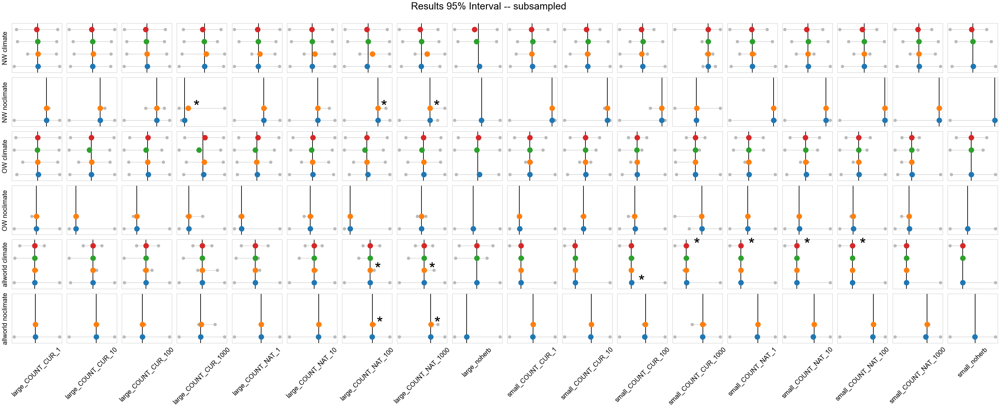

In [60]:
gridrows=len(geos_uniq)*len(clim_uniq)
gridcols=len(size_uniq)

fig=plt.figure(figsize=(3*(gridcols),3*(gridrows)),facecolor='w') # widht height
fig.suptitle('Results 95% Interval -- subsampled', size=30,y=0.93,fontname='Arial')
outer_grid=gridspec.GridSpec(gridrows,gridcols, wspace=0.1, hspace=0.1)

rows=sum([[x]*gridcols for x in range(gridrows)],[])
for index,(geo,clim,column) in enumerate(product([x for x in range(len(geos_uniq))],[clim for clim in range(len(clim_uniq))],[y for y in range(len(size_uniq))])):
    temp=summary[(summary['geog']==geos_uniq[geo]) & (summary['climate']==clim_uniq[clim]) & (summary['sizetype']==size_uniq[column])]
    ax=plt.subplot(outer_grid[rows[index],column])
    plt.ylim(-0.5,3.5)
    for ind,col in enumerate(estimates):
        try:
            ax.scatter(temp['%s_025'%(estimates[ind])],ind,s=80,c='#bababa',zorder=2)
            ax.scatter(temp['%s_median'%(estimates[ind])],ind,s=250,zorder=3)
            ax.scatter(temp['%s_975'%(estimates[ind])],ind,s=80,c='#bababa',zorder=2)
            ax.hlines(y=ind,xmin=temp['%s_025'%(estimates[ind])],xmax=temp['%s_975'%(estimates[ind])],lw=1,ls='-',color='#bababa',zorder=1)
        except:
            pass
        ax.vlines(x=0,ymin=ax.get_ylim()[0],ymax=ax.get_ylim()[1],lw=1.5,ls='-',color='k',zorder=1)
        ax.set_xticklabels([]);ax.set_yticklabels([]);ax.tick_params(axis='both',which='both',length=0,width=0)
        [ax.spines[loc].set_visible(True) for loc in ['top','right','left','bottom']]
        [ax.spines[loc].set_color('#bababa') for loc in ['top','right','left','bottom']]
        # adding '*'
        for sig in indices:
            if sig[2] == column and sig[1] == rows[index] and sig[0] == col:
                x=0+ax.get_xlim()[1]*0.2
                ax.text(x=x,y=ind-0.3,s='*',fontsize=50,fontname='Arial',color='k')
    if column == 0:
        plt.ylabel('%s %s'%(geos_uniq[geo],clim_uniq[clim]),fontdict={'fontsize':20,'fontname':'Arial'},labelpad=6)
    if rows[index] == 5:
        plt.xlabel(size_uniq[column],fontdict={'fontsize':20,'fontname':'Arial'},labelpad=6,rotation=45)
plt.show()

Ultra lazy legend:

**<font color='red'>intercept</font>**  
**<font color='green'>size</font>**  
**<font color='orange'>Biome_bin1</font>**  
**<font color='blue'>Precip</font>**  

---

# Recovering DIC values from the Rimage files

---

In [ ]:
%%bash

nano Rdic.R

library(coda)
library(ape)
library(phytools)
library(MCMCglmmRAM)

commArgs <- commandArgs()
args <- strsplit(commArgs, "=", fixed = TRUE)

print(args)

path<-args[[8]][2]

load(file=path)
summary(modelbio)

# execution
FOLDER='round_2'
for i in $FOLDER/*Rimage; do echo $i >> "${FOLDER}"_dic.txt; $PATH_R/R-3.5.2/bin/Rscript.exe --vanilla Rdic.R --args file=$i >> "${FOLDER}"_dic.txt; done

# Parsing the results

In [2]:
path='./rimagetxt/'
filePref='*.txt'

model_list=[]; folder_list=[]; dic_list=[]; samplesize_list=[]
for filename in glob.glob(os.path.join(path,'%s'%(filePref))):

    with open(filename,'r') as f:
        for line in f:
            modelmatch=re.search('.+Rimage',line)
            if modelmatch and '[' not in modelmatch.group(0): # if file name was echoed to stdout
                model_list.append(modelmatch.group(0).split('/')[-1].replace('.Rimage','')) # adds model to list
                folder_list.append(filename.split('\\')[-1].split('.')[0]) # adds folder info to list
#                 print('Model --> ',modelmatch.group(0).split('/')[-1].replace('.Rimage',''))
#                 print('Folder --> ',filename.split('\\')[-1].split('.')[0])
            samplematch=re.search('Sample size  = ([0-9\.]+)',line)
            if samplematch:
                samplesize_list.append(samplematch.group(1))
            dicmatch=re.search('DIC:\s([0-9.]+)',line)
            if dicmatch:
                dic_list.append(dicmatch.group(1))
#                 print('DIC -->',dicmatch.group(1))
DIC_data=pd.DataFrame(zip(folder_list,model_list,samplesize_list,dic_list),columns=['folder','model','sample_size','DIC'])
DIC_data[['sample_size','DIC']]=DIC_data[['sample_size','DIC']].astype('float')
DIC_data
# This is the entire list for each individual model and run, for me to keep track of things

,folder,model,sample_size,DIC
0,climate_round1_dic,allworld-large_COUNT_CUR_1000-climate_postdist,743.0,58.80141
1,climate_round1_dic,allworld-large_COUNT_CUR_1000-noclimate_postdist,540.0,198.81700
2,climate_round1_dic,allworld-large_COUNT_CUR_100-climate_postdist,743.0,112.94200
3,climate_round1_dic,allworld-large_COUNT_CUR_100-noclimate_postdist,540.0,203.37310
4,climate_round1_dic,allworld-large_COUNT_CUR_10-climate_postdist,743.0,118.17930
...,...,...,...,...
365,round_noc2_dic,OW-large_COUNT_NAT_1000-noclimate_postdist,504.0,33.78107
366,round_noc2_dic,OW-large_COUNT_NAT_100-noclimate_postdist,504.0,33.13534
367,round_noc2_dic,OW-large_COUNT_NAT_10-noclimate_postdist,504.0,31.42914
368,round_noc2_dic,OW-large_COUNT_NAT_1-noclimate_postdist,504.0,32.05020


In [3]:
DIC_data.sort_values(by=['sample_size','DIC'])

,folder,model,sample_size,DIC
357,round_noc2_dic,NW-small_COUNT_NAT_1000-noclimate_postdist,504.0,16.37434
318,round_noc1_dic,OW-large_COUNT_CUR_10-noclimate_postdist,504.0,22.85620
356,round_noc2_dic,NW-small_COUNT_CUR_1-noclimate_postdist,504.0,25.22067
359,round_noc2_dic,NW-small_COUNT_NAT_10-noclimate_postdist,504.0,28.30128
324,round_noc1_dic,OW-small_COUNT_CUR_10-noclimate_postdist,504.0,28.84652
...,...,...,...,...
174,cluster_2_dic,allworld-large_COUNT_NAT_1-climate_postdist,743.0,149.05730
10,climate_round1_dic,allworld-large_COUNT_NAT_100-climate_postdist,743.0,149.50680
164,cluster_2_dic,allworld-large_COUNT_CUR_10-climate_postdist,743.0,152.03300
60,climate_round2_dic,allworld-large_COUNT_CUR_10-climate_postdist,743.0,168.73190


sums the total of sample generations across files and chains, then takes the lowest and highest DIC values reported

In [4]:
DICgrouped=DIC_data.groupby(by=['model']).agg({'sample_size':['min','max','sum'],'DIC':['min','max']}).reset_index()
# DICgrouped.to_csv('./DIC_20210111.txt',sep='\t')
DICgrouped

model sample_size         \
                                                             min    max   
0              NW-large_COUNT_CUR_1-climate_postdist       743.0  743.0   
1            NW-large_COUNT_CUR_1-noclimate_postdist       504.0  585.0   
2             NW-large_COUNT_CUR_10-climate_postdist       743.0  743.0   
3           NW-large_COUNT_CUR_10-noclimate_postdist       504.0  585.0   
4            NW-large_COUNT_CUR_100-climate_postdist       743.0  743.0   
..                                               ...         ...    ...   
90    allworld-small_COUNT_NAT_10-noclimate_postdist       504.0  585.0   
91     allworld-small_COUNT_NAT_100-climate_postdist       743.0  743.0   
92   allworld-small_COUNT_NAT_100-noclimate_postdist       504.0  585.0   
93    allworld-small_COUNT_NAT_1000-climate_postdist       743.0  743.0   
94  allworld-small_COUNT_NAT_1000-noclimate_postdist       504.0  585.0   

                  DIC             
       sum        min        max  
0   2972.0   88.57504  109.01870  
1   2178.0   69.88847  110.78370  
2   2972.0  103.23890  115.98470  
3   2178.0   42.83579   97.94148  
4   2972.0  106.95650  117.01000  
..     ...        ...        ...  
90  2178.0   67.84528  120.81650  
91  1486.0   90.84422  103.93220  
92  2178.0  109.98210  120.76780  
93  1486.0  106.92880  110.90110  
94  2178.0   80.80151  121.72120  

[95 rows x 6 columns]

# Merging chains and estimating DIC

"The DIC function calculates the Deviance Information Criterion given the MCMC chains from an estimateMRH routine, using the formula:

DIC = .5*var(D)+mean(D)

where D is the chain of -2*log(L), calculated at each retained iteration of the MCMC routine"

glmmMCMC stores the deviance at each sampling point of the chain. For each model, I will concatenate the chains' deviance and estimate DIC.

[source](https://www.rdocumentation.org/packages/MRH/versions/2.2/topics/DIC#:~:text=The%20DIC%20function%20calculates%20the,iteration%20of%20the%20MCMC%20routine)

In [ ]:
%%bash

nano Rdic.R

library(coda)
library(ape)
library(phytools)
library(MCMCglmmRAM)

commArgs <- commandArgs()
args <- strsplit(commArgs, "=", fixed = TRUE)

print(args)

path<-args[[8]][2]
out_file<-args[[9]][2]

load(file=path)
write.csv(modelbio$Deviance,file=out_file)

# execution
PATH_R='/cygdrive/c/Users/xtorrm/R';
FOLDER='climate_round1';
for i in $FOLDER/*Rimage; do $PATH_R/R-3.5.2/bin/Rscript.exe --vanilla Rdic.R --args file=$i outfile="${i}".out; done
for i in */*Rimage.out; do sed -i '/var/d' $i; sed -i 's/"//g' $i; done

In [5]:
# path='./round_1/'
path='E://Antonelli_lab_backup/Palm_spines_CDB_SF_MFT/*/'
fileSuf='*.Rimage.out'

all_deviance=pd.DataFrame(columns=['rindex','dev','geo','size','climate'])
for filename in glob.glob(os.path.join(path,'%s'%(fileSuf))):
    geo=filename.split('\\')[-1].split('-')[0]
    size=filename.split('\\')[-1].split('-')[1]
    climate=filename.split('\\')[-1].split('-')[2].split('_')[0]
    temp=pd.read_csv(filename,sep=',',names=['rindex','dev'])
    for name,col in zip(['geo','size','climate'],[geo,size,climate]):
        temp[name]=[col]*len(temp)
    all_deviance=pd.concat([all_deviance,temp])
all_deviance    

,rindex,dev,geo,size,climate
0,13001,84.404272,allworld,small_COUNT_CUR_1000,noclimate
1,13201,81.638297,allworld,small_COUNT_CUR_1000,noclimate
2,13401,89.621229,allworld,small_COUNT_CUR_1000,noclimate
3,13601,89.458571,allworld,small_COUNT_CUR_1000,noclimate
4,13801,91.934437,allworld,small_COUNT_CUR_1000,noclimate
...,...,...,...,...,...
1985,598501,26.153175,OW,small_noherb,noclimate
1986,598801,22.762747,OW,small_noherb,noclimate
1987,599101,25.310115,OW,small_noherb,noclimate
1988,599401,30.450026,OW,small_noherb,noclimate


In [6]:
def DIC(dev):
    """ takes the deviance at each sample and returns the deviance information criterion value"""
    DIC=0.5*np.var(dev)+np.mean(dev)
    return DIC

In [8]:
mergedDIC=all_deviance.groupby(by=['geo','size','climate'])['dev'].apply(lambda x: DIC(x.astype('float').values)).reset_index().sort_values(by='dev',ascending=True)
mergedDIC.to_csv('./mergedDIC_20210115.txt',sep='\t')
mergedDIC

,geo,size,climate,dev
60,OW,small_COUNT_CUR_1000,climate,36.702535
61,OW,small_COUNT_CUR_1000,noclimate,37.184298
58,OW,small_COUNT_CUR_100,climate,37.636577
68,OW,small_COUNT_NAT_1000,climate,37.957611
62,OW,small_COUNT_NAT_1,climate,38.575059
...,...,...,...,...
74,allworld,large_COUNT_CUR_10,climate,229.100289
82,allworld,large_COUNT_NAT_10,climate,229.788006
88,allworld,large_noherb,climate,231.685099
80,allworld,large_COUNT_NAT_1,climate,232.810888
